In [1]:
fig_save_path = '/data/peer/wallet/Jupyter/2023_Particle_SASP/figures/'

In [2]:
DATA_DIR = '/data/peer/wallet/Jupyter/2023_Particle_SASP/data/'

In [3]:
import numpy as np
import pandas as pd
import scanpy as sc
import anndata
import scipy.sparse as sparse
import matplotlib.pyplot as plt
import seaborn as sns
from kneed import KneeLocator
from scanpy.external.pp import magic





In [4]:
from scrnaseq_preprocessing_utils import *

In [5]:
color_map_clusters_nogrey = ["#FFFF00", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",
"#5A0007", "#809693", "#1B4400", "#4FC601", "#3B5DFF", "#4A3B53", "#FF2F80",
"#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", "#B903AA", "#D16100",
"#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",
"#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",
"#00489C", "#6F0062", "#0CBD66", "#EEC3FF", "#456D75", "#B77B68", "#7A87A1", "#788D66",
"#885578", "#FAD09F", "#FF8A9A", "#D157A0", "#BEC459", "#456648", "#0086ED", "#886F4C",
"#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",
"#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",
"#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",
"#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",
"#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#CB7E98", "#A4E804", "#324E72", "#6A3A4C"]
blue_red = ['#DE2A1B','#1B2ADE',"#1CE6FF", ]
#scanpy layout
sc.set_figure_params(scanpy=True, dpi=150, dpi_save=150, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=True, ipython_format='png2x')
sns.set_style('white')
sc.settings.verbosity = 3

In [6]:

batlow_20 = ['#1d2356','#1d2b59',
'#14375e',
'#134460',
'#1c5261',
'#235f5f',
'#396a58',
'#4c714e',
'#607843',
'#757e36',
'#8d8532',
'#a78b30',
'#c49138',
'#dc954d',
'#f09c6a',
'#f8a487',
'#f8aca2',
'#f8b5be',
'#f8c2d9',
'#eecbe1'] 
import random
random.seed(1)
random.shuffle(batlow_20)


## data paths and sample metadata

In [7]:
adata_path = DATA_DIR + 'GSE202051_totaldata-final-toshare.h5ad'
marker_gene_path = '/data/peer/wallet/Jupyter/2023_Particle_SASP/2023_Particle_SASP/230529_marker_genes_hv.csv'
adata_save_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo.h5ad'

#metadata
metadata_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-sample_metadata.csv'

#indicate the samples you want to analyze
subset_list = ['Metastasis','Primary', 'Non-Tumor']
number_of_hv_genes =1500
add_marker_genes=True
marker_gene_sets =[ 'immune_typing_important_marker']

In [8]:
DATA_DIR

'/data/peer/wallet/Jupyter/2023_Particle_SASP/data/'

In [9]:
metadata_path

'/data/peer/wallet/Jupyter/2023_Particle_SASP/data/TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-sample_metadata.csv'

In [10]:
adata = sc.read(adata_path)
adata

AnnData object with n_obs × n_vars = 224988 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCA

In [11]:
set(adata.obs['pid'])

{'T1',
 'T10',
 'T11',
 'T12',
 'T13',
 'T14',
 'T15',
 'T16',
 'T17',
 'T18',
 'T19',
 'T2',
 'T20',
 'T21',
 'T22',
 'T23',
 'T24',
 'T25',
 'T3',
 'T4',
 'T5',
 'T6',
 'T7',
 'T8',
 'T9',
 'U1',
 'U10',
 'U11',
 'U12',
 'U13',
 'U14',
 'U15',
 'U16',
 'U17',
 'U18',
 'U2',
 'U3',
 'U4',
 'U5',
 'U6',
 'U7',
 'U8',
 'U9'}

In [12]:
metadata_df = pd.read_csv(metadata_path,index_col='patient_ID')
metadata_df

,tissue_type,tissue,pretreated,pretreatment,pretreatment_ICT,pretreatment_CTX,sequencing_technique
patient_ID,,,,,,,
U1,primary,pancreas,False,NaN,False,False,10x_v3
U2,primary,pancreas,False,NaN,False,False,10x_v3
U3,primary,pancreas,False,NaN,False,False,10x_v3
U4,primary,pancreas,False,NaN,False,False,10x_v2
U5,primary,pancreas,False,NaN,False,False,10x_v3
U6,primary,pancreas,False,NaN,False,False,10x_v3
U7,primary,pancreas,False,NaN,False,False,10x_v3
U8,primary,pancreas,False,NaN,False,False,10x_v3
U9,primary,pancreas,False,NaN,False,False,10x_v3


In [13]:
adata.obs['pretreated'] = pd.Categorical(adata.obs['pid'].map(metadata_df['pretreated'].to_dict()).astype(str))
adata.obs['pretreatment_CTX'] = pd.Categorical(adata.obs['pid'].map(metadata_df['pretreatment_CTX'].to_dict()).astype(str))


In [14]:
set(adata.obs['pretreated'])

{'False', 'True'}

In [15]:
set(adata.obs['pretreatment_CTX'] )

{'False', 'True', 'nan'}

In [16]:
adata

AnnData object with n_obs × n_vars = 224988 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCA

In [17]:
#remove non RCTX pretreated sampples
adata = adata[~adata.obs['pretreatment_CTX'].isna()]
adata

View of AnnData object with n_obs × n_vars = 224988 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF

In [18]:
set(adata.obs['pretreatment_CTX'] )

{'False', 'True', 'nan'}

## recalculate PCs and embeddings

This is because we have subsetted the data to samples of interest (in this case only T3 and T4 samples)

In [22]:
sc.pp.highly_variable_genes(adata,  flavor='cell_ranger', n_top_genes=number_of_hv_genes,batch_key='pid')

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/wallet/miniconda3/envs/2022_Peer_S

/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/wallet/miniconda3/envs/2022_Peer_S

    finished (0:00:32)


/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [23]:
number_of_hv_genes

1500

In [24]:
sc.pl.highly_variable_genes(adata,  show=None, save=None, highly_variable_genes=True)

In [25]:
if add_marker_genes ==True:
    marker_genes_df = pd.read_csv(marker_gene_path,index_col=['gene_name'])


In [26]:
#limit to human only
marker_genes_df = marker_genes_df[marker_genes_df['species'] == 'homo_sapiens']
marker_genes_df

,ENSEMBL_Gene,species,immune_typing_important_marker,leukocyte_important_marker,TNK_important_marker,ILC_important_marker,B_important_marker,M_important_marker,DC_important_marker
gene_name,,,,,,,,,
C1QB,ENSG00000173369,homo_sapiens,True,False,False,False,False,False,True
C1QA,ENSG00000173372,homo_sapiens,True,False,False,False,False,False,True
IDO1,ENSG00000131203,homo_sapiens,True,False,True,False,False,False,True
IL6ST,ENSG00000134352,homo_sapiens,True,False,True,False,False,False,True
IL6R,ENSG00000160712,homo_sapiens,True,False,True,False,False,False,True
...,...,...,...,...,...,...,...,...,...
CD38,ENSG00000004468,homo_sapiens,True,False,True,False,True,True,False
IFNG,ENSG00000111537,homo_sapiens,True,False,True,False,True,True,False
CD274,ENSG00000120217,homo_sapiens,True,False,True,False,True,True,False


In [27]:
#limit to markers used for distinguishing immune from tumor cells
marker_genes_df = marker_genes_df[marker_gene_sets]
marker_genes_df

,immune_typing_important_marker
gene_name,
C1QB,True
C1QA,True
IDO1,True
IL6ST,True
IL6R,True
...,...
CD38,True
IFNG,True
CD274,True


In [28]:
#extract gene names
marker_lists = []
for i in marker_gene_sets:
    marker_genes_list = list(set(marker_genes_df[marker_genes_df[i]==True].index))
    marker_lists.append(marker_genes_list)
marker_lists

[['CSF3R',
  'CXCR4',
  'IFNL1',
  'SOD2',
  'PPBP',
  'NCR3',
  'SCARF1',
  'CD69',
  'CFB',
  'CD24',
  'IGHE',
  'IL20',
  'CXCL9',
  'IFNAR2',
  'HLA-DOB',
  'XCR1',
  'IL4',
  'LRP1',
  'KLRD1',
  'CXCL5',
  'TRAC',
  'INHBA',
  'IL19',
  'IGHA1',
  'TXLNA',
  'KIR2DL5B',
  'CSF1',
  'EGR2',
  'CD40LG',
  'CCL16',
  'CLEC7A',
  'TGFB1',
  'OASL',
  'SIGLEC8',
  'CD3E',
  'SIGLEC5',
  'CD1C',
  'TRDC',
  'PTPRC',
  'IL2RB',
  'TRGC1',
  'CD28',
  'CXCL2',
  'IL6',
  'CCL14',
  'PRSS3',
  'TRIM21',
  'GPX7',
  'IL21R',
  'CCR3',
  'TNFRSF18',
  'LTB',
  'CD27',
  'TCF3',
  'ITGA2',
  'BTLA',
  'SELL',
  'LAG3',
  'HNF1A',
  'FGFBP2',
  'FCGR1A',
  'CEACAM8',
  'CCL22',
  'TPSB2',
  'CXCR1',
  'CCL28',
  'CCR10',
  'TNFSF4',
  'CTSK',
  'GZMB',
  'CEBPA',
  'ALK4',
  'ITGAM',
  'IFNGR1',
  'SCARB1',
  'GPX5',
  'IFNA2',
  'IL23R',
  'CD3G',
  'GPX6',
  'LTA',
  'IFNG',
  'LCK',
  'CCL5',
  'CCL23',
  'KLRF1',
  'KLRC2',
  'IL1A',
  'FTH1',
  'MARCO',
  'CD22',
  'TRBC1',
  'IL17F',
 

In [29]:
#concatenate lists
import itertools
a = marker_lists
marker_genes = list(itertools.chain.from_iterable(a))
marker_genes

['CSF3R',
 'CXCR4',
 'IFNL1',
 'SOD2',
 'PPBP',
 'NCR3',
 'SCARF1',
 'CD69',
 'CFB',
 'CD24',
 'IGHE',
 'IL20',
 'CXCL9',
 'IFNAR2',
 'HLA-DOB',
 'XCR1',
 'IL4',
 'LRP1',
 'KLRD1',
 'CXCL5',
 'TRAC',
 'INHBA',
 'IL19',
 'IGHA1',
 'TXLNA',
 'KIR2DL5B',
 'CSF1',
 'EGR2',
 'CD40LG',
 'CCL16',
 'CLEC7A',
 'TGFB1',
 'OASL',
 'SIGLEC8',
 'CD3E',
 'SIGLEC5',
 'CD1C',
 'TRDC',
 'PTPRC',
 'IL2RB',
 'TRGC1',
 'CD28',
 'CXCL2',
 'IL6',
 'CCL14',
 'PRSS3',
 'TRIM21',
 'GPX7',
 'IL21R',
 'CCR3',
 'TNFRSF18',
 'LTB',
 'CD27',
 'TCF3',
 'ITGA2',
 'BTLA',
 'SELL',
 'LAG3',
 'HNF1A',
 'FGFBP2',
 'FCGR1A',
 'CEACAM8',
 'CCL22',
 'TPSB2',
 'CXCR1',
 'CCL28',
 'CCR10',
 'TNFSF4',
 'CTSK',
 'GZMB',
 'CEBPA',
 'ALK4',
 'ITGAM',
 'IFNGR1',
 'SCARB1',
 'GPX5',
 'IFNA2',
 'IL23R',
 'CD3G',
 'GPX6',
 'LTA',
 'IFNG',
 'LCK',
 'CCL5',
 'CCL23',
 'KLRF1',
 'KLRC2',
 'IL1A',
 'FTH1',
 'MARCO',
 'CD22',
 'TRBC1',
 'IL17F',
 'TNF',
 'CXCL13',
 'S100A8',
 'KIR2DL3',
 'IRF1',
 'IGHD',
 'CD209',
 'NOTCH2',
 'FFAR4',
 'I

In [30]:
#set important marker genes as highly variable

for i in marker_genes:
    if i in adata.var_names:
        adata.var['highly_variable'][i]= True
    else:
        print(i, 'not found')

KIR2DL5B not found
ALK4 not found
TNFRSF13C  not found
GPX1 not found
HLA-DRB4 not found
TENT5C not found
ACOD1 not found
ZBTB46  not found
RAGE not found
TNFRSF9  not found
VSIR not found
HLA-DRB3 not found
KIR2DL2 not found
KIR2DL5A not found
TPSD1  not found
FCGR2C not found
S100A15 not found


/scratch/lsftmp/17977802.tmpdir/ipykernel_64257/2651330476.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var['highly_variable'][i]= True


In [31]:
adata[:,'FASLG'].var['highly_variable']

FASLG    True
Name: highly_variable, dtype: bool

In [32]:
number_of_PC_used = calculate_optimal_PC(adata, min_PC = 50, min_var=25, n_comps=100, use_hv=None)

computing PCA
    on highly variable genes
    with n_comps=100
    finished (0:00:39)
Kneepoint happens at PC: 12
12 PC explain 31.322693080112057 % of variance
setting PCs to 50
variance of 50 is 41.98568022128584 %
number of PCs for clusterings/embeddings is: 50
these explain 41.98568022128584 of variance
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:18)


In [33]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=number_of_PC_used)
sc.tl.umap(adata)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:51)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:04:29)


In [34]:
#impute data
adata_indf = magic(adata, copy=True, verbose=True, solver='approximate', n_pca=adata.obsm['X_pca'].shape[1], knn=5, t=3)
adata.layers['imputed'] = adata_indf.X

computing MAGIC
Calculating MAGIC...
  Running MAGIC on 224988 cells and 22164 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...


/home/wallet/.local/lib/python3.10/site-packages/magic/magic.py:425: UserWarning: Input matrix contains unexpressed genes. Please remove them prior to running MAGIC.
  warnings.warn(


    Calculated PCA in 103.56 seconds.
    Calculating KNN search...
    Calculated KNN search in 2258.63 seconds.
    Calculating affinities...
    Calculated affinities in 2636.46 seconds.
  Calculated graph and diffusion operator in 4999.16 seconds.
  Calculating imputation...
  Calculated imputation in 1.07 seconds.


/home/wallet/.local/lib/python3.10/site-packages/magic/utils.py:145: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  data = anndata.AnnData(data)


Calculated MAGIC in 5028.12 seconds.
    finished (1:23:51)


In [24]:
#adata.write(adata_save_path)
#print('saved to:',adata_save_path)

saved to: /data/peer/wallet/Jupyter/2023_Particle_SASP/data/TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo.h5ad


# explore data

In [253]:
adata_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo.h5ad'
metadata_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-sample_metadata.csv'


In [10]:
metadata_df = pd.read_csv(metadata_path,index_col='patient_ID')
metadata_df

,tissue_type,tissue,pretreated,pretreatment,pretreatment_ICT,pretreatment_CTX,sequencing_technique
patient_ID,,,,,,,
U1,primary,pancreas,False,NaN,False,False,10x_v3
U2,primary,pancreas,False,NaN,False,False,10x_v3
U3,primary,pancreas,False,NaN,False,False,10x_v3
U4,primary,pancreas,False,NaN,False,False,10x_v2
U5,primary,pancreas,False,NaN,False,False,10x_v3
U6,primary,pancreas,False,NaN,False,False,10x_v3
U7,primary,pancreas,False,NaN,False,False,10x_v3
U8,primary,pancreas,False,NaN,False,False,10x_v3
U9,primary,pancreas,False,NaN,False,False,10x_v3


In [254]:
adata = sc.read(adata_path)
adata

AnnData object with n_obs × n_vars = 207661 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCA

In [502]:
adata_pretreated = adata[adata.obs['pretreated']=='True']
adata_pretreated

View of AnnData object with n_obs × n_vars = 98697 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF'

computing PCA
    on highly variable genes
    with n_comps=100
    finished (0:01:01)


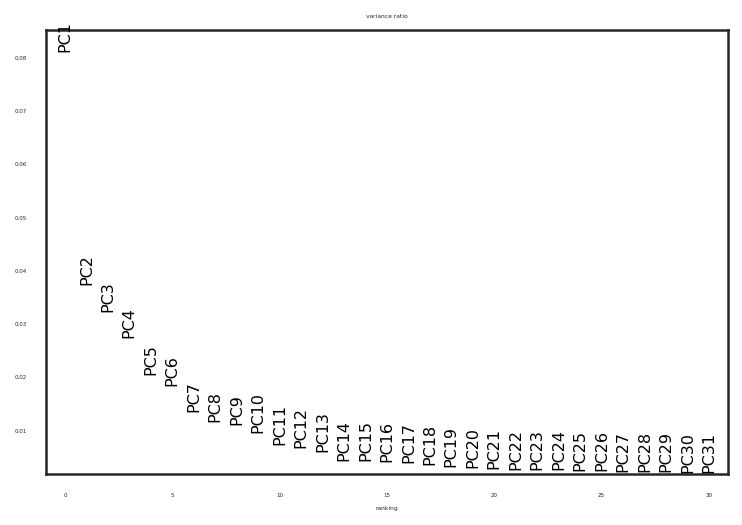

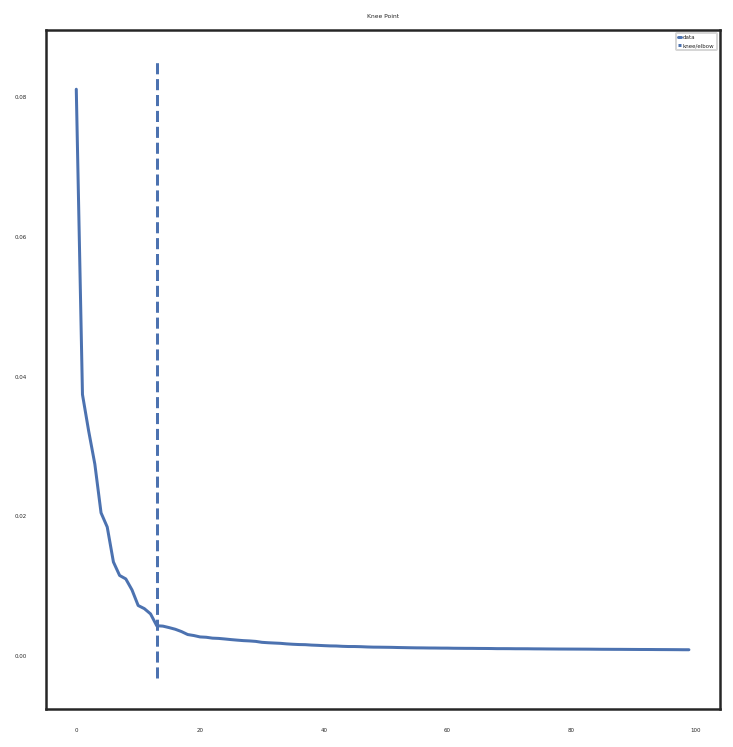

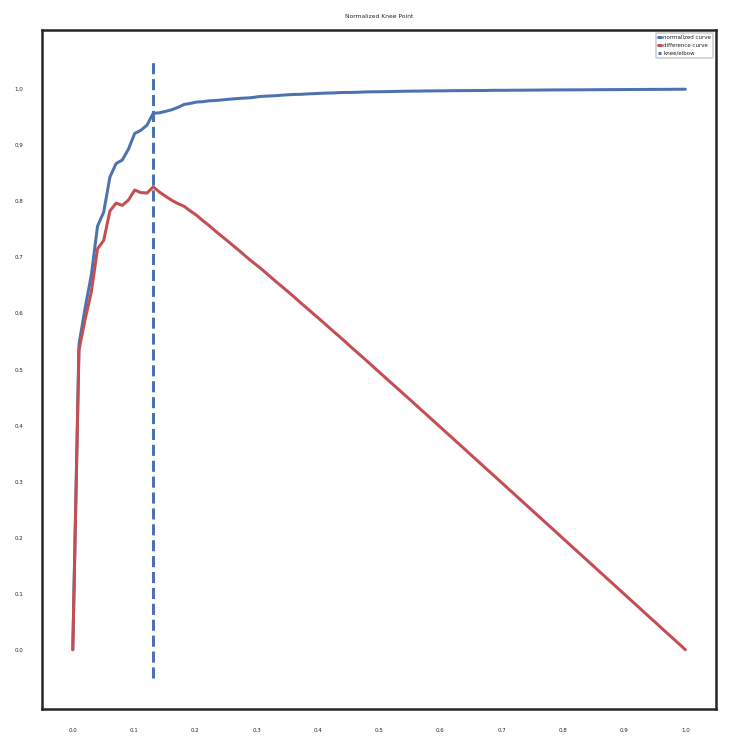

Kneepoint happens at PC: 13
13 PC explain 28.27293697874987 % of variance
setting PCs to 50
variance of 50 is 36.37179782309402 %
number of PCs for clusterings/embeddings is: 50
these explain 36.37179782309402 of variance
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:19)


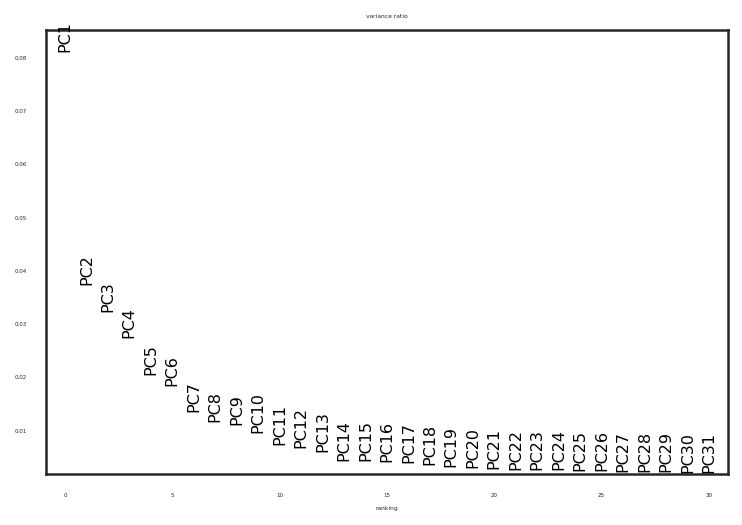

In [504]:
number_of_PC_used = calculate_optimal_PC(adata_pretreated, min_PC = 50, min_var=25, n_comps=100, use_hv=None)


In [505]:
sc.pp.neighbors(adata_pretreated, n_neighbors=15, n_pcs=number_of_PC_used)
sc.tl.umap(adata_pretreated)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:36)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:54)


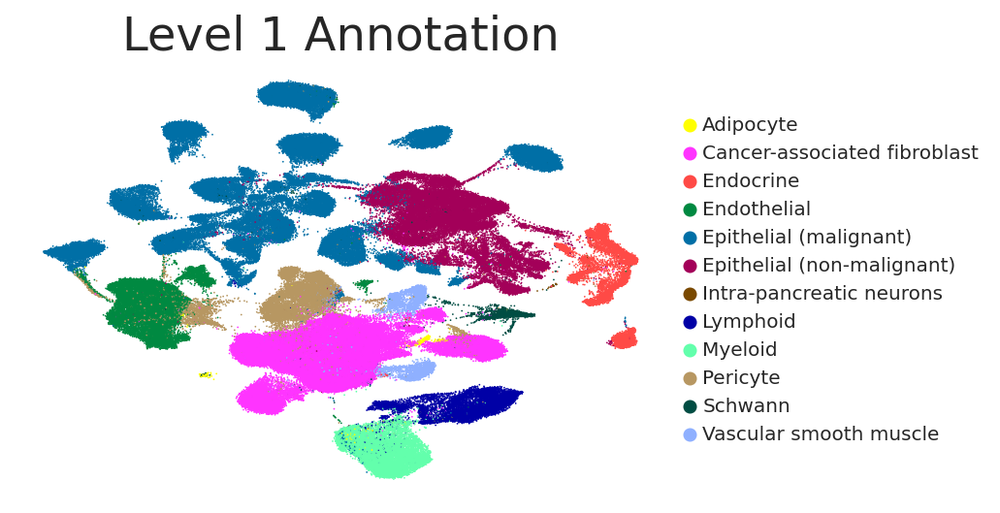

In [415]:
adata = randomize_cells(adata)
sc.pl.umap(adata, color = ['Level 1 Annotation'], s = 3, palette=color_map_clusters_nogrey, legend_fontsize = 10,
           layer='imputed',vmin=0,vmax=1)


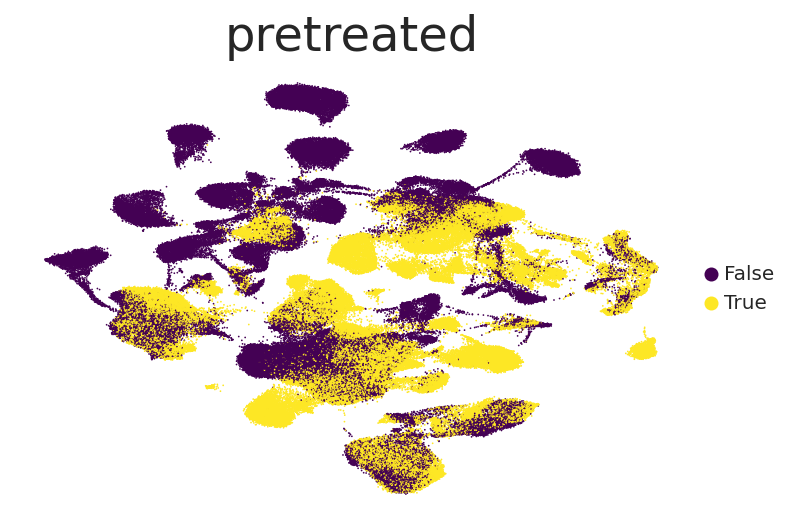

In [416]:
sc.pl.umap(adata, color = ['pretreated'], s = 3, palette='viridis', legend_fontsize = 10,layer='imputed',
           vmin=0,vmax=1)


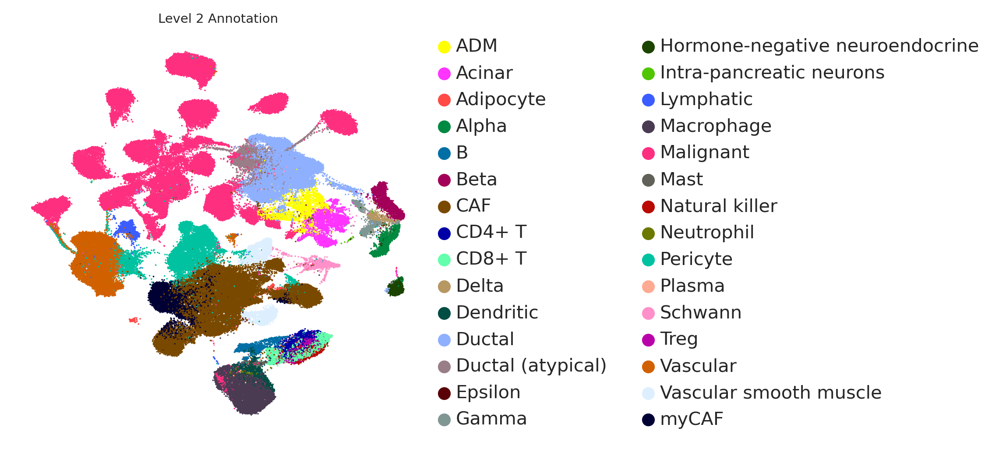

In [13]:
sc.pl.umap(adata, color = ['Level 2 Annotation'], s = 3, palette=color_map_clusters_nogrey, legend_fontsize = 10,layer='imputed',vmin=0,vmax=1)


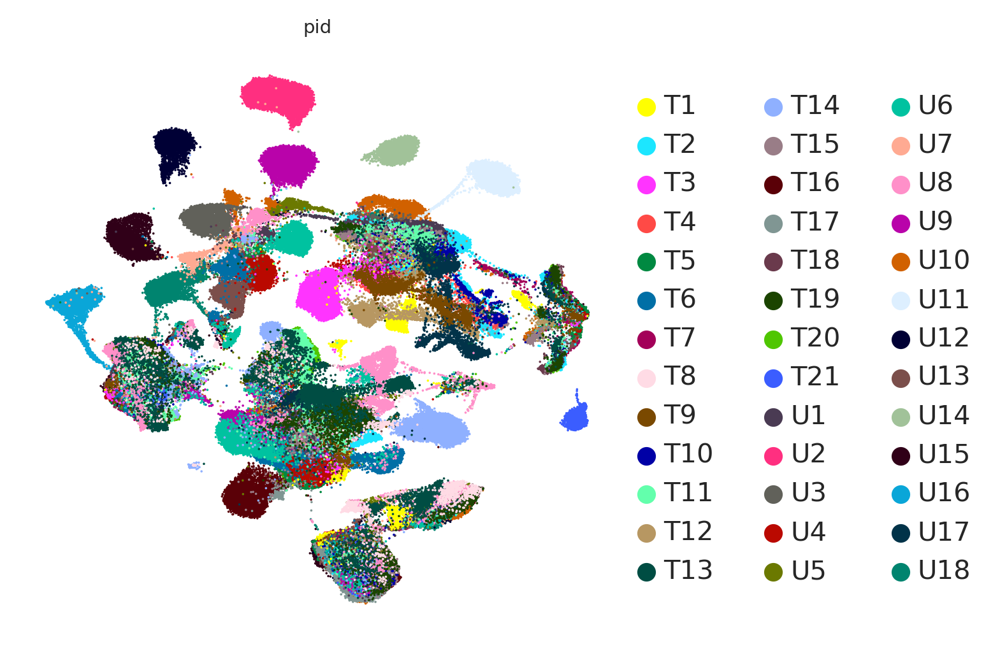

In [14]:
sc.pl.umap(adata, color = ['pid'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0,vmax=1)


In [375]:
all_chemokines = ['CCL1',
'CCL11',
'CCL13',
'CCL14',
'CCL15',
'CCL16',
'CCL17',
'CCL18',
'CCL19',
'CCL2',
'CCL20',
'CCL21',
'CCL22',
'CCL23',
'CCL24',
'CCL25',
'CCL26',
'CCL27',
'CCL28',
'CCL3',
'CCL4',
'CCL5',
'CCL7',
'CCL8',
'CX3CL1',
'CXCL1',
'CXCL10',
'CXCL11',
'CXCL12',
'CXCL13',
'CXCL16',
'CXCL2',
'CXCL3',
'CXCL5',
'CXCL6',
'CXCL8',
'CXCL9']

In [388]:
celltypes = ['Adipocyte',
 'Cancer-associated fibroblast',
 'Endocrine',
 'Endothelial',
 'Epithelial (malignant)',
 'Epithelial (non-malignant)',
 'Intra-pancreatic neurons',
 'Pericyte',
 'Schwann',
 'Vascular smooth muscle']

In [395]:
adata.layers['zscored'] = scipy.stats.zscore(np.array(adata.X.todense()),axis=0)

In [396]:
pheno_heat = 'Level 1 Annotation'
genes_plot_clean = [x for x in all_chemokines if x in adata.var_names]

plt_df = plt_gene_heatmap_df(adata,pheno_heat,genes_plot_clean,cluster_minus_one_present=False, 
                             zscore=True, layer_heat = 'zscored')

Cluster:  Schwann
Cluster:  Epithelial (non-malignant)
Cluster:  Epithelial (malignant)
Cluster:  Intra-pancreatic neurons
Cluster:  Endothelial
Cluster:  Cancer-associated fibroblast
Cluster:  Myeloid
Cluster:  Vascular smooth muscle
Cluster:  Lymphoid
Cluster:  Pericyte
Cluster:  Endocrine
Cluster:  Adipocyte


In [397]:
plt_df = plt_df.T[~plt_df.isna().all()].T
plt_df = plt_df[plt_df.index.isin(celltypes)]
plt_df

,CCL24,CCL26,CCL15,CXCL12,CCL2,CCL28,CCL11,CCL19,CXCL3,CX3CL1,...,CCL20,CXCL1,CCL14,CCL8,CXCL2,CXCL11,CXCL8,CCL3,CCL22,CCL18
Schwann,-0.032345,-0.018591,-0.004241,-0.096360,0.001700,-0.120078,-0.007052,-0.016919,-0.131943,-0.095142,...,-0.101760,-0.112209,-0.013848,-0.021011,-0.149244,-0.023644,-0.094392,-0.065840,-0.018147,-0.006303
Epithelial (non-malignant),-0.024484,-0.013989,-0.004241,0.097256,0.167632,0.428114,-0.016514,-0.052366,-0.056379,0.018724,...,-0.091066,0.145704,-0.010396,-0.015908,0.197708,0.011729,0.078581,-0.059699,-0.017580,-0.041426
Epithelial (malignant),0.077630,-0.007692,0.009537,-0.127556,-0.055538,0.132436,-0.016016,-0.043708,0.300260,0.070351,...,0.219486,0.157281,-0.013266,-0.017344,0.111799,0.017909,0.113649,-0.054823,-0.007928,-0.031884
Intra-pancreatic neurons,-0.046230,-0.027906,-0.004241,-0.137973,-0.082939,-0.206394,-0.019745,-0.054866,-0.173501,0.063238,...,-0.115057,-0.136091,-0.013848,-0.021011,-0.187055,-0.023644,-0.121063,-0.065840,-0.026109,-0.044201
Endothelial,-0.038574,-0.019672,-0.004241,0.220309,-0.004460,-0.183916,-0.017163,-0.034718,-0.148063,0.173973,...,-0.093888,-0.115361,0.141856,0.005443,0.134000,-0.005837,-0.105794,-0.048860,-0.014293,-0.034672
Cancer-associated fibroblast,-0.043628,0.013194,-0.004241,0.125648,-0.014610,-0.198740,0.044915,0.082913,-0.166097,-0.097027,...,-0.103997,-0.125890,-0.013848,-0.008845,-0.158236,-0.015486,-0.113751,-0.056984,-0.013760,-0.034806
Vascular smooth muscle,-0.030995,-0.014315,-0.004241,-0.133337,-0.074218,-0.189658,-0.006621,-0.044799,-0.173065,-0.080026,...,-0.115057,-0.136091,-0.013848,-0.021011,-0.187055,-0.023644,-0.120370,-0.065840,-0.012911,-0.040884
Pericyte,-0.040545,0.066797,-0.004241,-0.008553,0.135687,-0.188780,0.003135,0.100287,-0.163580,0.044837,...,-0.111352,-0.123108,0.004895,0.127541,-0.143940,-0.008198,-0.110676,-0.054897,-0.014679,-0.037957
Endocrine,-0.043887,-0.010318,-0.004241,-0.133631,-0.079692,-0.155818,-0.013254,-0.051331,-0.170143,-0.080170,...,-0.112950,-0.135543,-0.013848,-0.021011,-0.180507,-0.011227,-0.113891,-0.054216,0.003558,-0.041492
Adipocyte,-0.046230,0.051878,-0.004241,-0.087763,-0.042191,-0.184938,-0.019745,-0.054866,-0.160150,-0.070799,...,-0.060300,-0.136091,-0.013848,0.129102,-0.150853,-0.023644,-0.025970,0.027747,-0.026109,0.007579


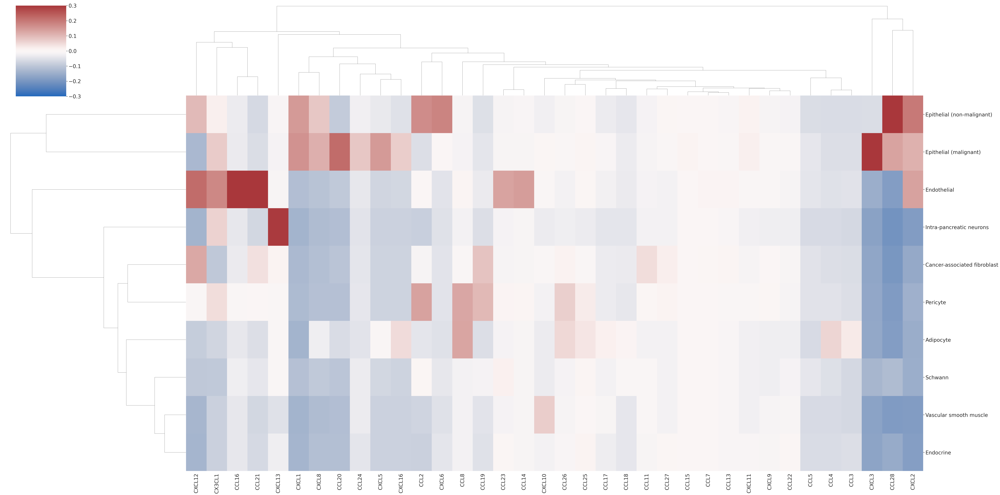

In [408]:
#SEACElls non imputed
import scipy
%matplotlib inline
sns.set(font_scale=2)
clustergrid = sns.clustermap(plt_df, cmap='vlag', col_cluster=True,row_cluster=True, figsize=(60,30), 
                             #row_linkage=plot_df_corr[1],col_linkage=plot_df_corr[2],
                             vmin=-.3,vmax=.3,center=0, z_score=None) 

In [405]:
plt_df_means = pd.DataFrame(np.mean(plt_df,axis=1))
plt_df_means['celltype'] = plt_df_means.index
plt_df_means

,0,celltype
Schwann,-0.043584,Schwann
Epithelial (non-malignant),0.014212,Epithelial (non-malignant)
Epithelial (malignant),0.022235,Epithelial (malignant)
Intra-pancreatic neurons,-0.049251,Intra-pancreatic neurons
Endothelial,0.009119,Endothelial
Cancer-associated fibroblast,-0.033992,Cancer-associated fibroblast
Vascular smooth muscle,-0.055265,Vascular smooth muscle
Pericyte,-0.023673,Pericyte
Endocrine,-0.053588,Endocrine
Adipocyte,-0.029615,Adipocyte


In [411]:
col_dendro_indices = clustergrid.dendrogram_row.reordered_ind

# Get the original column labels in clustered order
col_labels = plt_df_means.index[col_dendro_indices]
col_labels = list(col_labels)
#col_labels.reverse()


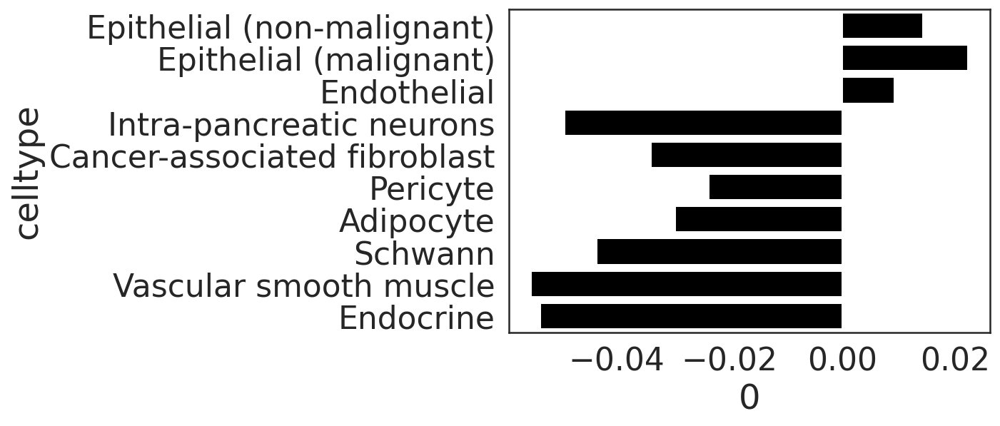

In [412]:
sns.set_style('white')
save_name= 'Carbon_meanzscore_barplot.svg'
sns.barplot(data=plt_df_means, x=0, y='celltype',color='000000',order = col_labels)
plt.savefig(fig_save_path+save_name)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_Level 1 Annotation']`


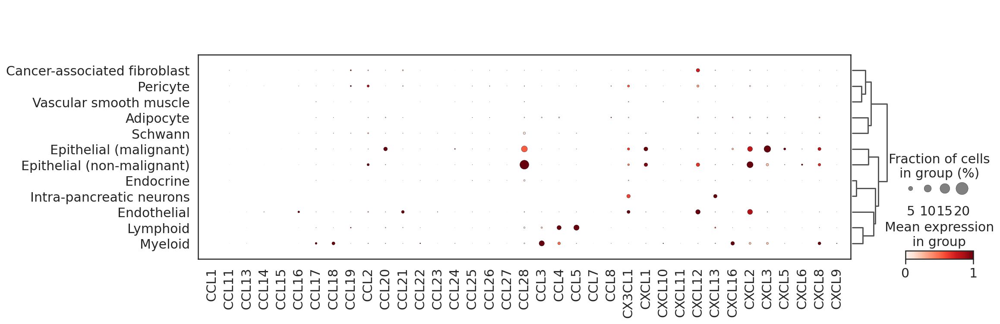

In [367]:
#dotplot
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')




sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, genes_plot_clean, groupby=pheno_heat, dendrogram=True, standard_scale='var')

In [417]:
adata_crc = adata[adata.obs['Level 1 Annotation']=='Epithelial (malignant)']


In [506]:
adata_subset = adata[adata.obs['Level 1 Annotation']=='Epithelial (malignant)']
adata_subset = adata_subset[adata_subset.obs['pretreated']=='True']
plot_df_corr = pd.DataFrame(adata_subset[:,all_chemokines].layers['imputed'],index=adata_subset.obs_names,
                                              columns=all_chemokines)
#plot_df_corr =scipy.stats.zscore(plot_df_corr)
plot_df_corr =  corr_cov_matrix_cluster(plot_df_corr,markers=['all_markers'], metric='spearman',
                                        clustering_method = 'average', linkage_distance=1.65)
plot_df_corr

[           CCL11     CCL13     CCL14     CCL15     CCL16     CCL17     CCL18  \
 CCL11   1.000000 -0.003440 -0.001377 -0.007972 -0.004491  0.139905  0.139236   
 CCL13  -0.003440  1.000000 -0.001593 -0.011166 -0.003753  0.198828  0.313411   
 CCL14  -0.001377 -0.001593  1.000000 -0.003377  0.117256 -0.005805 -0.003270   
 CCL15  -0.007972 -0.011166 -0.003377  1.000000 -0.016913  0.147179  0.009099   
 CCL16  -0.004491 -0.003753  0.117256 -0.016913  1.000000 -0.020797 -0.007365   
 CCL17   0.139905  0.198828 -0.005805  0.147179 -0.020797  1.000000  0.168811   
 CCL18   0.139236  0.313411 -0.003270  0.009099 -0.007365  0.168811  1.000000   
 CCL19   0.407456 -0.000345  0.000595 -0.005806 -0.002494  0.055685  0.162789   
 CCL2    0.341155  0.009933  0.127720  0.031747  0.040230  0.079147  0.179486   
 CCL20   0.027390 -0.031299 -0.009079 -0.091730 -0.006311  0.127651 -0.036165   
 CCL21   0.110252  0.000158  0.002667 -0.012496  0.003169  0.013730  0.078932   
 CCL22   0.055684  0.004962 

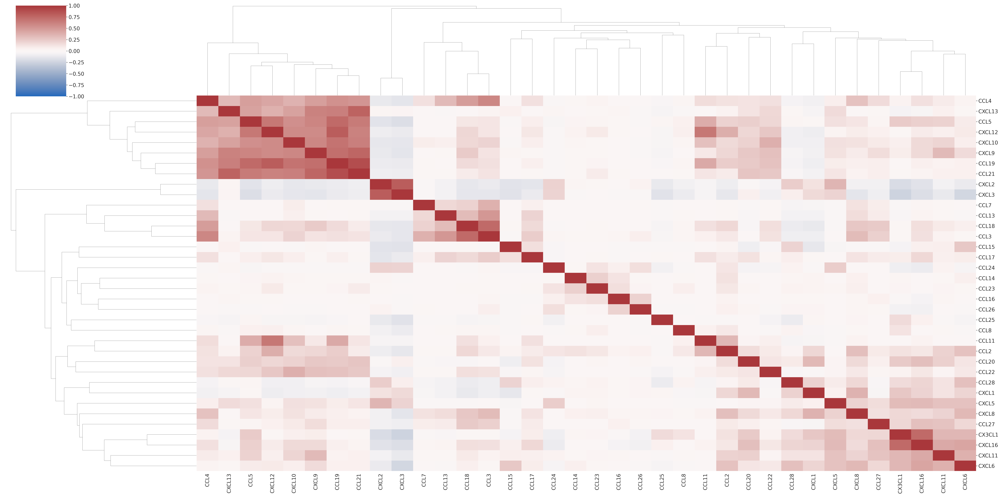

In [507]:
#SEACElls non imputed
import scipy
%matplotlib inline
sns.set(font_scale=2)
clustergrid = sns.clustermap(plot_df_corr[0], cmap='vlag', col_cluster=True,row_cluster=True, figsize=(60,30), 
                             #row_linkage=plot_df_corr[1],col_linkage=plot_df_corr[2],
                             vmin=-1,vmax=1,center=0,
               z_score=None) 

In [508]:
#SEACElls non imputed
row_colors = [color_map_clusters_nogrey[x] for x in plot_df_corr[1]]
col_colors = [color_map_clusters_nogrey[x] for x in plot_df_corr[1]]
sns.set(font_scale=2)
clustergrid = sns.clustermap(plot_df_corr[0], cmap='vlag',# col_cluster=True,row_cluster=True, 
                             figsize=(60,60), 
                             row_linkage=plot_df_corr[2],col_linkage=plot_df_corr[2],
                             row_colors = row_colors, col_colors=col_colors,
                             vmin=-.6,vmax=.6,center=0,
               z_score=None) 

In [509]:
cluster_labels =plot_df_corr[1]
variable_names =plot_df_corr[0].index
# Get the indices of samples in each cluster
clusters = np.unique(cluster_labels)
cluster_indices = [np.where(cluster_labels == c)[0] for c in clusters]

# Get the variable names for each cluster
cluster_variable_names = [[variable_names[i] for i in ci] for ci in cluster_indices]

print(cluster_variable_names)

[['CCL19', 'CCL21', 'CCL4', 'CCL5', 'CXCL10', 'CXCL12', 'CXCL13', 'CXCL9'], ['CXCL2', 'CXCL3'], ['CCL13', 'CCL18', 'CCL3', 'CCL7'], ['CCL14', 'CCL15', 'CCL16', 'CCL17', 'CCL23', 'CCL24', 'CCL25', 'CCL26', 'CCL8'], ['CCL11', 'CCL2', 'CCL20', 'CCL22', 'CCL27', 'CCL28', 'CX3CL1', 'CXCL1', 'CXCL11', 'CXCL16', 'CXCL5', 'CXCL6', 'CXCL8']]


In [510]:
#delete last cluster
cluster_variable_names_crc = cluster_variable_names
cluster_variable_names_crc

[['CCL19', 'CCL21', 'CCL4', 'CCL5', 'CXCL10', 'CXCL12', 'CXCL13', 'CXCL9'],
 ['CXCL2', 'CXCL3'],
 ['CCL13', 'CCL18', 'CCL3', 'CCL7'],
 ['CCL14',
  'CCL15',
  'CCL16',
  'CCL17',
  'CCL23',
  'CCL24',
  'CCL25',
  'CCL26',
  'CCL8'],
 ['CCL11',
  'CCL2',
  'CCL20',
  'CCL22',
  'CCL27',
  'CCL28',
  'CX3CL1',
  'CXCL1',
  'CXCL11',
  'CXCL16',
  'CXCL5',
  'CXCL6',
  'CXCL8']]

In [425]:
adata.layers['zscored'] = scipy.stats.zscore(np.array(adata.X.todense()),axis=0)


In [426]:
for i,v in enumerate(cluster_variable_names_crc):
    adata.obs['score_crc_'+str(i)] =  list(np.mean(adata[:,v].layers['zscored'],axis=1))
    adata.obs['score_crc_nonzscored_'+str(i)] =   list(np.mean(np.array(adata[:,v].X.todense()),axis=1))

In [427]:
score_list = ['score_crc_0','score_crc_1','score_crc_2','score_crc_3','score_crc_4']
crc_mean_df, crc_frac_df = aggregate_scores(adata_crc,score_list,'pid',
                            zero_cutoff =None,aggregate_function='mean')

In [428]:
score_list = ['score_crc_nonzscored_0','score_crc_nonzscored_1','score_crc_nonzscored_2','score_crc_nonzscored_3','score_crc_nonzscored_4']
crc_mean_df_non_zscored, crc_frac_df_non_zscored = aggregate_scores(adata_crc,score_list,'pid',
                            zero_cutoff =None,aggregate_function='mean')

In [429]:
np.mean(crc_mean_df_non_zscored)

score_crc_nonzscored_0    0.015118
score_crc_nonzscored_1    0.124266
score_crc_nonzscored_2    0.004951
score_crc_nonzscored_3    0.001369
score_crc_nonzscored_4    0.031584
dtype: float64

In [430]:
crc_mean_df['pretreated'] = crc_mean_df.index.map(metadata_df['pretreated'].to_dict())
crc_mean_df['pretreated']= crc_mean_df['pretreated'].astype(str)
crc_mean_df

,score_crc_0,score_crc_1,score_crc_2,score_crc_3,score_crc_4,pretreated
T14,-0.062865,-0.054430,-0.018998,-0.002210,0.005465,True
T15,-0.062865,0.880400,0.039600,-0.026971,0.238118,True
U3,-0.043097,0.004864,-0.031066,-0.010218,0.055737,False
U17,-0.050851,1.377713,-0.021432,0.002931,0.145875,False
T19,-0.062865,0.184922,0.012696,-0.026971,0.213231,True
T18,-0.047493,-0.101764,-0.031066,-0.026971,0.025513,True
T16,0.480577,0.212013,0.122150,-0.026971,0.032677,True
U16,-0.059630,-0.050068,-0.026433,-0.020176,0.002132,False
U10,-0.053315,-0.098057,-0.025846,-0.007731,0.000065,False
U18,0.056568,-0.118224,-0.010815,-0.012223,0.046576,False


In [431]:
def get_proportions(adata, sample_obs, celltype_obs):
    '''
    get cell type proportions from an adata
    adata: adata element containing cell type labels
    sample_obs: key in adata.obs containing sample ids
    patient_obs: key in adata.obs containing patient ids
    comparison_obs: key in adata.obs for additional variable to add to the dataframe
    '''
    try:
        cell_type_df = adata.obs[[sample_obs, celltype_obs]]
    except:
        raise ValueError('obs keys not contained in adata')
    
    #calculate celltype prop. per sample
    proportions_df = pd.DataFrame()
    for i in set(cell_type_df[sample_obs]):
        cell_type_df_sub = cell_type_df[cell_type_df[sample_obs]==i]
        proportions_df[i] = cell_type_df_sub.value_counts(celltype_obs,normalize=True)
    return proportions_df


In [432]:
cell_type_proportions = get_proportions(adata,'pid','Level 2 Annotation').T
cell_type_proportions

Level 2 Annotation,CAF,Pericyte,Vascular,Malignant,myCAF,Macrophage,Adipocyte,Lymphatic,Schwann,Natural killer,...,Mast,Ductal (atypical),Neutrophil,Delta,CD4+ T,Beta,B,Alpha,Vascular smooth muscle,Hormone-negative neuroendocrine
T14,0.537411,0.208751,0.117007,0.041339,0.031790,0.024659,0.019461,0.009912,0.005198,0.001330,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
T15,0.322522,0.013602,0.052838,0.010201,0.018572,0.052053,0.000000,0.001046,0.012817,0.007847,...,0.005231,0.158514,0.000262,0.004447,0.004970,0.009678,0.002877,0.002354,0.003139,0.000000
U3,0.148879,0.044377,0.051535,0.605694,0.002068,0.004613,0.000000,0.004136,0.003340,0.000000,...,0.000000,0.039924,0.000000,0.000318,0.000000,0.003658,0.000000,0.006203,0.000000,0.000159
U17,0.101637,0.013379,0.039936,0.095447,0.002396,0.001198,0.000200,0.000399,0.001597,0.000000,...,0.000000,0.002796,0.000000,0.006589,0.000000,0.016573,0.000399,0.004593,0.000000,0.003195
T19,0.367793,0.056234,0.119568,0.028401,0.012496,0.080375,0.014485,0.001988,0.007384,0.012496,...,0.000568,0.012212,0.002272,0.024993,0.015621,0.068162,0.000852,0.062198,0.001988,0.000284
T18,0.293899,0.132440,0.083705,0.024182,0.005580,0.106771,0.000372,0.000000,0.009673,0.005208,...,0.000372,0.000000,0.000372,0.015253,0.007812,0.095238,0.000000,0.098586,0.003348,0.002976
T16,0.682448,0.019487,0.027446,0.003294,0.064087,0.107863,0.016879,0.000000,0.002333,0.002333,...,0.001510,0.000000,0.001921,0.000137,0.008783,0.000000,0.000549,0.000000,0.005215,0.000137
U16,0.003114,0.042186,0.066251,0.881653,0.000283,0.000283,0.000283,0.005096,0.000566,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
U10,0.132964,0.022327,0.052617,0.144909,0.125569,0.109357,0.000000,0.001138,0.005404,0.018629,...,0.002418,0.009386,0.000000,0.000853,0.000142,0.006968,0.000427,0.000142,0.000000,0.000000
U18,0.053776,0.023568,0.048438,0.463151,0.032943,0.095052,0.000000,0.023698,0.002344,0.041276,...,0.000260,0.042839,0.000000,0.000260,0.001953,0.000130,0.000781,0.000000,0.000000,0.000000


In [433]:
merged_df = pd.merge(crc_mean_df, cell_type_proportions, left_index=True, right_index=True)
merged_df = merged_df[merged_df['pretreated']=='True']
merged_df

,score_crc_0,score_crc_1,score_crc_2,score_crc_3,score_crc_4,pretreated,CAF,Pericyte,Vascular,Malignant,...,Mast,Ductal (atypical),Neutrophil,Delta,CD4+ T,Beta,B,Alpha,Vascular smooth muscle,Hormone-negative neuroendocrine
T14,-0.062865,-0.054430,-0.018998,-0.002210,0.005465,True,0.537411,0.208751,0.117007,0.041339,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
T15,-0.062865,0.880400,0.039600,-0.026971,0.238118,True,0.322522,0.013602,0.052838,0.010201,...,0.005231,0.158514,0.000262,0.004447,0.004970,0.009678,0.002877,0.002354,0.003139,0.000000
T19,-0.062865,0.184922,0.012696,-0.026971,0.213231,True,0.367793,0.056234,0.119568,0.028401,...,0.000568,0.012212,0.002272,0.024993,0.015621,0.068162,0.000852,0.062198,0.001988,0.000284
T18,-0.047493,-0.101764,-0.031066,-0.026971,0.025513,True,0.293899,0.132440,0.083705,0.024182,...,0.000372,0.000000,0.000372,0.015253,0.007812,0.095238,0.000000,0.098586,0.003348,0.002976
T16,0.480577,0.212013,0.122150,-0.026971,0.032677,True,0.682448,0.019487,0.027446,0.003294,...,0.001510,0.000000,0.001921,0.000137,0.008783,0.000000,0.000549,0.000000,0.005215,0.000137
T10,-0.062865,-0.180050,-0.031066,-0.026971,0.025017,True,0.099875,0.017969,0.102800,0.001672,...,0.000836,0.009193,0.004597,0.002925,0.000836,0.033013,0.000000,0.011283,0.000000,0.000000
T12,-0.048384,0.920752,-0.031066,-0.012814,0.001955,True,0.120108,0.023239,0.081458,0.318982,...,0.000000,0.025440,0.000000,0.001223,0.000000,0.002446,0.000000,0.000489,0.000000,0.000000
T3,-0.060360,0.384782,-0.031066,-0.021389,-0.007598,True,0.026354,0.003090,0.017448,0.884224,...,0.000000,0.013631,0.000000,0.000000,0.000000,0.000364,0.000000,0.000000,0.000182,0.000000
T20,-0.020834,-0.004424,-0.031066,-0.026971,-0.046543,True,0.249116,0.288897,0.160007,0.030941,...,0.000884,0.038366,0.000884,0.007603,0.003006,0.026521,0.001061,0.016973,0.026521,0.000707
T6,-0.043986,-0.068732,-0.031066,-0.006180,0.015197,True,0.173139,0.032539,0.056240,0.200991,...,0.002410,0.000000,0.000000,0.000000,0.000000,0.000134,0.000268,0.000000,0.264462,0.000000


In [434]:
cell_type_proportions.columns

CategoricalIndex(['CAF', 'Pericyte', 'Vascular', 'Malignant', 'myCAF',
                  'Macrophage', 'Adipocyte', 'Lymphatic', 'Schwann',
                  'Natural killer', 'CD8+ T', 'Acinar', 'Dendritic', 'Ductal',
                  'Plasma', 'Treg', 'ADM', 'Intra-pancreatic neurons', 'Gamma',
                  'Epsilon', 'Mast', 'Ductal (atypical)', 'Neutrophil',
                  'Delta', 'CD4+ T', 'Beta', 'B', 'Alpha',
                  'Vascular smooth muscle', 'Hormone-negative neuroendocrine'],
                 categories=['ADM', 'Acinar', 'Adipocyte', 'Alpha', ..., 'Treg', 'Vascular', 'Vascular smooth muscle', 'myCAF'], ordered=False, dtype='category', name='Level 2 Annotation')

In [435]:
set(adata.obs['Level 3 Annotation'])

{'ADM',
 'Acinar',
 'Acinar (REG+)',
 'Adipocyte',
 'Alpha',
 'B',
 'Beta',
 'CAF',
 'CD4+ T',
 'CD8+ T',
 'CD8+ T (dysfunctional)',
 'CD8+ T (progenitor dysfunctional)',
 'CD8+ T (terminally dysfunctional)',
 'Delta',
 'Dendritic (activated)',
 'Dendritic (conventional type 1)',
 'Dendritic (conventional type 2)',
 'Dendritic (plasmacytoid)',
 'Ductal',
 'Ductal (atypical)',
 'Epsilon',
 'Gamma',
 'Hormone-negative neuroendocrine',
 'Intra-pancreatic neurons',
 'Lymphatic',
 'Macrophage',
 'Malignant',
 'Mast',
 'Natural killer',
 'Neutrophil',
 'Pericyte',
 'Plasma',
 'Schwann',
 'Treg',
 'Treg (activated)',
 'Treg (quiescent)',
 'Vascular',
 'Vascular smooth muscle',
 'myCAF'}

In [436]:
celltypes_oi = [ 'Macrophage','CD8+ T', 'Natural killer','Treg','Dendritic','CD4+ T', 'B', 'Plasma','Mast','Neutrophil', ]
programs_oi = ['score_crc_0','score_crc_1','score_crc_2','score_crc_4','score_crc_3',]

In [437]:
corr_df = pd.DataFrame()
p_df = pd.DataFrame()

for i in programs_oi:
    for j in celltypes_oi:
        corr, pval = scipy.stats.spearmanr(merged_df[i], merged_df[j])
        corr_df.loc[i,j] = corr
        p_df.loc[i,j] = pval

In [438]:
cluster_variable_names_crc

[['CCL19', 'CCL21', 'CCL4', 'CCL5', 'CXCL10', 'CXCL12', 'CXCL13', 'CXCL9'],
 ['CXCL2', 'CXCL3'],
 ['CCL13', 'CCL18', 'CCL3', 'CCL7'],
 ['CCL14',
  'CCL15',
  'CCL16',
  'CCL17',
  'CCL23',
  'CCL24',
  'CCL25',
  'CCL26',
  'CCL8'],
 ['CCL11',
  'CCL2',
  'CCL20',
  'CCL22',
  'CCL27',
  'CCL28',
  'CX3CL1',
  'CXCL1',
  'CXCL11',
  'CXCL16',
  'CXCL5',
  'CXCL6',
  'CXCL8']]

In [439]:
corr_df

,Macrophage,CD8+ T,Natural killer,Treg,Dendritic,CD4+ T,B,Plasma,Mast,Neutrophil
score_crc_0,0.289114,0.358764,-0.038767,0.380700,0.297656,0.378857,0.432151,0.340585,0.262389,0.247939
score_crc_1,0.080131,-0.064495,-0.178503,0.012092,0.152444,0.000664,0.153430,-0.087770,-0.061719,0.041512
score_crc_2,0.529908,0.368375,0.300741,0.461806,0.198305,0.483625,0.291736,0.063817,-0.006020,0.331457
score_crc_4,0.535761,0.448635,0.271782,0.409655,0.503251,0.237121,0.278843,-0.071550,0.484840,0.368914
score_crc_3,-0.189832,-0.178665,-0.532712,-0.399355,-0.323174,-0.544008,0.023306,-0.088834,-0.073605,-0.157958


In [442]:
corr_df_score = corr_df
corr_df_score['score'] = corr_df_score.index
corr_df_melt = pd.melt(corr_df_score,id_vars=['score'])
corr_df_melt

,score,variable,value
0,score_crc_0,Macrophage,0.289114
1,score_crc_1,Macrophage,0.080131
2,score_crc_2,Macrophage,0.529908
3,score_crc_4,Macrophage,0.535761
4,score_crc_3,Macrophage,-0.189832
5,score_crc_0,CD8+ T,0.358764
6,score_crc_1,CD8+ T,-0.064495
7,score_crc_2,CD8+ T,0.368375
8,score_crc_4,CD8+ T,0.448635
9,score_crc_3,CD8+ T,-0.178665


In [448]:
p_df_score_melt.index = p_df_score_melt['variable'].str.cat(p_df_score_melt['score'],sep='-X-')
p_df_score_melt['value'].sort_values()

variable
CD4+ T-X-score_crc_3            0.010793
Macrophage-X-score_crc_4        0.012307
Natural killer-X-score_crc_3    0.012908
Macrophage-X-score_crc_2        0.013482
Dendritic-X-score_crc_4         0.020042
Mast-X-score_crc_4              0.025906
CD4+ T-X-score_crc_2            0.026337
Treg-X-score_crc_2              0.035076
CD8+ T-X-score_crc_4            0.041359
B-X-score_crc_0                 0.050417
Treg-X-score_crc_4              0.065151
Treg-X-score_crc_3              0.072895
Treg-X-score_crc_0              0.088651
CD4+ T-X-score_crc_0            0.090334
Neutrophil-X-score_crc_4        0.099824
CD8+ T-X-score_crc_2            0.100359
CD8+ T-X-score_crc_0            0.110246
Plasma-X-score_crc_0            0.130845
Neutrophil-X-score_crc_2        0.142163
Dendritic-X-score_crc_3         0.153014
Natural killer-X-score_crc_2    0.185273
Dendritic-X-score_crc_0         0.190045
B-X-score_crc_2                 0.199431
Macrophage-X-score_crc_0        0.203688
B-X-sco

In [489]:
p_df_score = p_df
p_df_score['score'] = p_df_score.index
p_df_score_melt = pd.melt(p_df_score,id_vars=['score'])

In [492]:
corr_df_melt_merged

,score,variable,value,pval,1/pval
0,score_crc_0,Macrophage,0.289114,0.203688,4.909461
1,score_crc_1,Macrophage,0.080131,0.729887,1.370075
2,score_crc_2,Macrophage,0.529908,0.013482,74.171386
3,score_crc_4,Macrophage,0.535761,0.012307,81.256650
4,score_crc_3,Macrophage,-0.189832,0.409834,2.440010
5,score_crc_0,CD8+ T,0.358764,0.110246,9.070584
6,score_crc_1,CD8+ T,-0.064495,0.781207,1.280071
7,score_crc_2,CD8+ T,0.368375,0.100359,9.964192
8,score_crc_4,CD8+ T,0.448635,0.041359,24.178474
9,score_crc_3,CD8+ T,-0.178665,0.438411,2.280964


In [500]:
corr_df_melt_merged = corr_df_melt
corr_df_melt_merged['pval']= p_df_score_melt['value']
corr_df_melt_merged['1/pval'] =1/corr_df_melt_merged['pval']
corr_df_melt_merged.iloc[-1,:] =corr_df_melt_merged.iloc[0,:]
corr_df_melt_merged.iloc[-1,:] = ['dummy','Macrophage',0,0,0] 
corr_df_melt_merged.iloc[0,:] = ['dummy2','Macrophage',0,0,0] 
corr_df_melt_merged

,score,variable,value,pval,1/pval
0,dummy2,Macrophage,0.000000,0.000000,0.000000
1,score_crc_1,Macrophage,0.080131,0.729887,1.370075
2,score_crc_2,Macrophage,0.529908,0.013482,74.171386
3,score_crc_4,Macrophage,0.535761,0.012307,81.256650
4,score_crc_3,Macrophage,-0.189832,0.409834,2.440010
5,score_crc_0,CD8+ T,0.358764,0.110246,9.070584
6,score_crc_1,CD8+ T,-0.064495,0.781207,1.280071
7,score_crc_2,CD8+ T,0.368375,0.100359,9.964192
8,score_crc_4,CD8+ T,0.448635,0.041359,24.178474
9,score_crc_3,CD8+ T,-0.178665,0.438411,2.280964


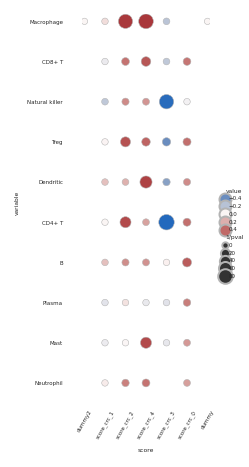

In [501]:
# Create a dotplot with mean of pos frac as dot hue and pos frac as dot size
sns.set(font_scale=0.25)
sns.set_style('white')
g = sns.relplot(
    data=corr_df_melt_merged,
    x="score", y="variable", hue="value", size="1/pval",
    palette="vlag", edgecolor=".7",#hue_norm = (0,1),
    height=3, aspect=.5,sizes=(10, 60),
)
g.despine(left=True, bottom=True)
g.ax.margins(.02)
for label in g.ax.get_xticklabels():
    label.set_rotation(60)
for artist in g.legend.legendHandles:
    artist.set_edgecolor(".7")

fig_save_path_spec = fig_save_path+'Particle_dotplot_immune_corr.svg'
plt.savefig(fig_save_path_spec,dpi=300)

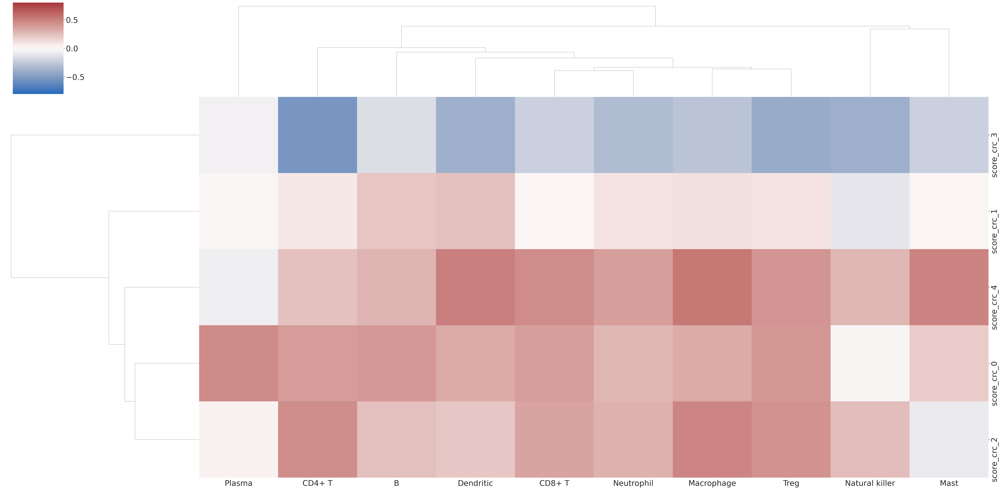

In [130]:
sns.set(font_scale=3)
clustergrid = sns.clustermap(corr_df, cmap='vlag', col_cluster=True,row_cluster=True, figsize=(60,30), vmin=-.8,center=0,vmax=.8,
               z_score=None) 

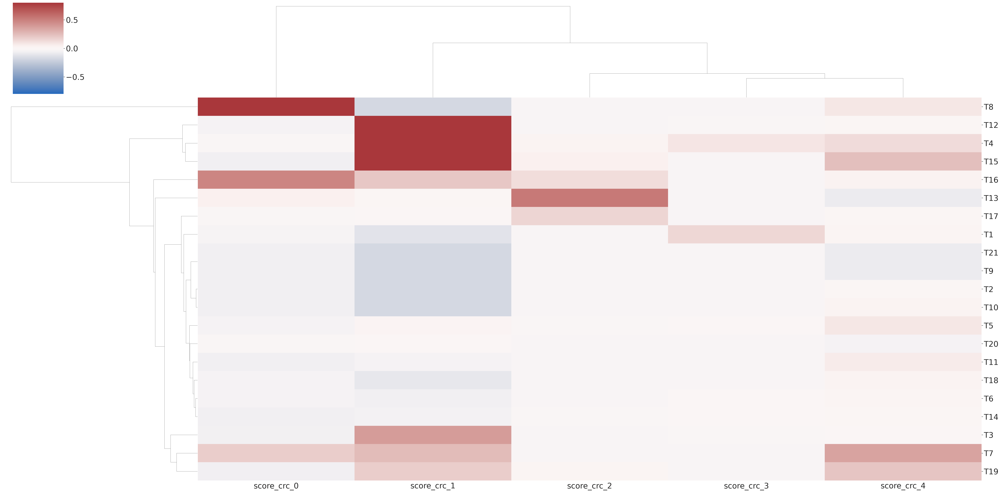

In [131]:
sns.set(font_scale=3)
plot_patients = crc_mean_df[crc_mean_df['pretreated']=='True'].drop(columns=['pretreated'])
clustergrid = sns.clustermap(plot_patients, cmap='vlag', col_cluster=True,row_cluster=True, figsize=(60,30), vmin=-.8,center=0,
                             vmax=.8,
               z_score=None) 

In [59]:
crc_mean_df_melt = pd.melt(crc_mean_df,id_vars='pretreated')
crc_mean_df_melt['pretreated'] = crc_mean_df_melt['pretreated'].astype(str)
crc_mean_df_melt

,pretreated,variable,value
0,True,score_crc_0,0.185450
1,False,score_crc_0,-0.047055
2,True,score_crc_0,-0.018809
3,True,score_crc_0,-0.062865
4,True,score_crc_0,-0.062865
...,...,...,...
190,False,score_crc_4,0.124420
191,False,score_crc_4,0.055737
192,True,score_crc_4,-0.082288
193,True,score_crc_4,0.025031


Carbon_crcprograms_230607.svg


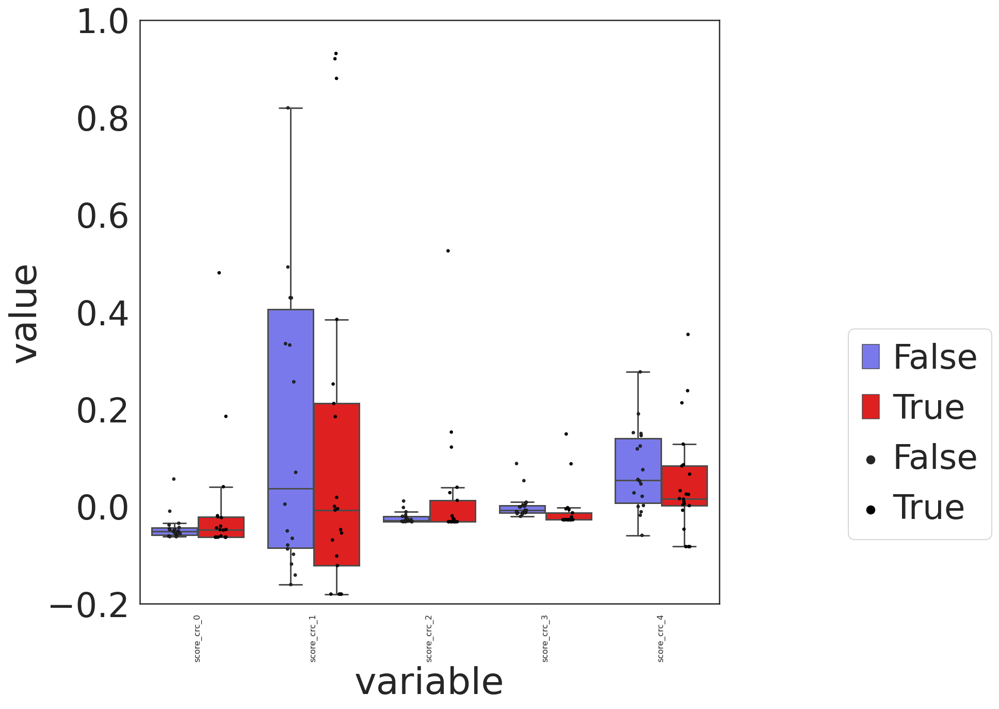

In [64]:
#plot
sns.set_style('white')
color_dict = {'True':'#ff0000','False':'#6666ff'}
save_name ='Carbon_crcprograms_230607.svg'#'Ganesh_meanagg_calligraphy_factor_modules_scores_230326.svg'
hue_order = ['False','True']
fig, ax = plt.subplots(figsize=(10,10))
sns.boxplot(data=crc_mean_df_melt,x='variable', hue='pretreated',palette=color_dict,hue_order=hue_order,
                y='value', order=None, 
                orient=None, saturation=0.75, width=0.8, 
                dodge=True, fliersize=0, linewidth=None, whis=1.5, ax=None)
sns.stripplot(data=crc_mean_df_melt,x='variable', hue='pretreated',hue_order=hue_order,
                y='value', order=None, 
                orient=None, color='#000000',s=3,
                dodge=True, linewidth=None, ax=None)
plt.ylim(-.2,1)
#plt.axhline(1)
plt.legend(bbox_to_anchor=[1.5, 0.5])
plt.xticks(rotation=90,size=8)
plt.savefig(fig_save_path+save_name)
print(save_name)

Level 1 Annotation,Cancer-associated fibroblast,Pericyte,Endothelial,Epithelial (malignant),Myeloid,Adipocyte,Schwann,Lymphoid,Epithelial (non-malignant),Endocrine,Intra-pancreatic neurons,Vascular smooth muscle
T14,0.569201,0.208751,0.126919,0.041339,0.025142,0.019461,0.005198,0.002901,0.001088,0.000000,0.000000,0.000000
T15,0.341093,0.013602,0.053884,0.010201,0.067748,0.000000,0.012817,0.047345,0.369343,0.080565,0.000262,0.003139
T25,0.468675,0.017802,0.028757,0.152687,0.066758,0.000000,0.003766,0.012325,0.235878,0.007874,0.000000,0.005478
T19,0.380290,0.056234,0.121556,0.028401,0.109628,0.014485,0.007384,0.106788,0.016473,0.155922,0.000852,0.001988
T18,0.299479,0.132440,0.083705,0.024182,0.129464,0.000372,0.009673,0.102679,0.001116,0.213542,0.000000,0.003348
T16,0.746535,0.019487,0.027446,0.003294,0.113353,0.016879,0.002333,0.064361,0.000823,0.000274,0.000000,0.005215
T24,0.104613,0.013440,0.058845,0.011624,0.023247,0.000363,0.004359,0.004359,0.767890,0.011260,0.000000,0.000000
T23,0.158106,0.021526,0.077494,0.023011,0.046467,0.000000,0.008165,0.024792,0.598872,0.037559,0.000000,0.004008
T1,0.039831,0.005745,0.085025,0.233244,0.025278,0.000000,0.011107,0.164305,0.249330,0.186136,0.000000,0.000000
T10,0.099875,0.017969,0.116590,0.001672,0.096949,0.001254,0.004597,0.022148,0.591308,0.047639,0.000000,0.000000


In [299]:
cell_type_proportions = get_proportions(adata,'pid','Level 1 Annotation').T
cell_type_proportions

Level 1 Annotation,Cancer-associated fibroblast,Pericyte,Endothelial,Epithelial (malignant),Myeloid,Adipocyte,Schwann,Lymphoid,Epithelial (non-malignant),Endocrine,Intra-pancreatic neurons,Vascular smooth muscle
T14,0.569201,0.208751,0.126919,0.041339,0.025142,0.019461,0.005198,0.002901,0.001088,0.000000,0.000000,0.000000
T15,0.341093,0.013602,0.053884,0.010201,0.067748,0.000000,0.012817,0.047345,0.369343,0.080565,0.000262,0.003139
U3,0.150946,0.044377,0.055670,0.605694,0.006999,0.000000,0.003340,0.001272,0.121043,0.010657,0.000000,0.000000
U17,0.104034,0.013379,0.040335,0.095447,0.001597,0.000200,0.001597,0.000799,0.710463,0.032149,0.000000,0.000000
T19,0.380290,0.056234,0.121556,0.028401,0.109628,0.014485,0.007384,0.106788,0.016473,0.155922,0.000852,0.001988
T18,0.299479,0.132440,0.083705,0.024182,0.129464,0.000372,0.009673,0.102679,0.001116,0.213542,0.000000,0.003348
T16,0.746535,0.019487,0.027446,0.003294,0.113353,0.016879,0.002333,0.064361,0.000823,0.000274,0.000000,0.005215
U16,0.003398,0.042186,0.071348,0.881653,0.000566,0.000283,0.000566,0.000000,0.000000,0.000000,0.000000,0.000000
U10,0.258532,0.022327,0.053754,0.144909,0.129266,0.000000,0.005404,0.044084,0.274886,0.066837,0.000000,0.000000
U18,0.086719,0.023568,0.072135,0.463151,0.101823,0.000000,0.002344,0.058984,0.187109,0.004167,0.000000,0.000000


In [302]:
cell_type_proportions['treated'] = [x[0] for x in cell_type_proportions.index]
cell_type_proportions = cell_type_proportions[cell_type_proportions['treated']=='T']
cell_type_proportions = cell_type_proportions.drop(columns=['treated'])
cell_type_proportions

Level 1 Annotation,Cancer-associated fibroblast,Pericyte,Endothelial,Epithelial (malignant),Myeloid,Adipocyte,Schwann,Lymphoid,Epithelial (non-malignant),Endocrine,Intra-pancreatic neurons,Vascular smooth muscle
T14,0.569201,0.208751,0.126919,0.041339,0.025142,0.019461,0.005198,0.002901,0.001088,0.000000,0.000000,0.000000
T15,0.341093,0.013602,0.053884,0.010201,0.067748,0.000000,0.012817,0.047345,0.369343,0.080565,0.000262,0.003139
T19,0.380290,0.056234,0.121556,0.028401,0.109628,0.014485,0.007384,0.106788,0.016473,0.155922,0.000852,0.001988
T18,0.299479,0.132440,0.083705,0.024182,0.129464,0.000372,0.009673,0.102679,0.001116,0.213542,0.000000,0.003348
T16,0.746535,0.019487,0.027446,0.003294,0.113353,0.016879,0.002333,0.064361,0.000823,0.000274,0.000000,0.005215
T1,0.039831,0.005745,0.085025,0.233244,0.025278,0.000000,0.011107,0.164305,0.249330,0.186136,0.000000,0.000000
T10,0.099875,0.017969,0.116590,0.001672,0.096949,0.001254,0.004597,0.022148,0.591308,0.047639,0.000000,0.000000
T12,0.120841,0.023239,0.092955,0.318982,0.022016,0.000489,0.001957,0.008806,0.390656,0.020059,0.000000,0.000000
T3,0.026354,0.003090,0.018357,0.884224,0.000364,0.000000,0.000909,0.000182,0.062886,0.003453,0.000000,0.000182
T20,0.263614,0.288897,0.163366,0.030941,0.024576,0.000000,0.044731,0.015382,0.089639,0.051980,0.000354,0.026521


In [303]:
celltype_pp = adata[adata.obs['pid'].isin(cell_type_proportions.index)].obs['pid'].value_counts() * cell_type_proportions.T
celltype_pp

,T1,T10,T11,T12,T13,T14,T15,T16,T17,T18,...,T2,T20,T21,T3,T4,T5,T6,T7,T8,T9
Level 1 Annotation,,,,,,,,,,,,,,,,,,,,,
Cancer-associated fibroblast,104.0,239.0,1198.0,494.0,3223.0,4709.0,1304.0,5440.0,265.0,805.0,...,819.0,1491.0,14.0,145.0,484.0,3223.0,2737.0,1699.0,239.0,183.0
Pericyte,15.0,43.0,1742.0,95.0,1606.0,1727.0,52.0,142.0,28.0,356.0,...,69.0,1634.0,19.0,17.0,88.0,106.0,243.0,126.0,109.0,16.0
Endothelial,222.0,279.0,1014.0,380.0,2466.0,1050.0,206.0,200.0,95.0,225.0,...,262.0,924.0,92.0,101.0,244.0,313.0,477.0,318.0,167.0,70.0
Epithelial (malignant),609.0,4.0,33.0,1304.0,6.0,342.0,39.0,24.0,182.0,65.0,...,9.0,175.0,9.0,4865.0,46.0,1426.0,1501.0,85.0,35.0,3.0
Myeloid,66.0,232.0,93.0,90.0,468.0,208.0,259.0,826.0,540.0,348.0,...,361.0,139.0,38.0,2.0,648.0,209.0,334.0,545.0,155.0,14.0
Adipocyte,0.0,3.0,10.0,2.0,102.0,161.0,0.0,123.0,0.0,1.0,...,0.0,0.0,0.0,0.0,11.0,0.0,0.0,0.0,19.0,2.0
Schwann,29.0,11.0,46.0,8.0,86.0,43.0,49.0,17.0,2.0,26.0,...,24.0,253.0,1.0,5.0,17.0,40.0,134.0,48.0,27.0,15.0
Lymphoid,429.0,53.0,32.0,36.0,1178.0,24.0,181.0,469.0,111.0,276.0,...,69.0,87.0,19.0,1.0,152.0,2.0,37.0,125.0,858.0,2.0
Epithelial (non-malignant),651.0,1415.0,488.0,1597.0,103.0,9.0,1412.0,6.0,3.0,3.0,...,3052.0,507.0,25.0,346.0,3220.0,2.0,0.0,3055.0,1.0,2793.0


In [304]:
celltype_pp.loc['Cancer-associated fibroblast'].sort_values()

T21      14.0
T1      104.0
T3      145.0
T9      183.0
T10     239.0
T8      239.0
T17     265.0
T4      484.0
T12     494.0
T18     805.0
T2      819.0
T11    1198.0
T15    1304.0
T19    1339.0
T20    1491.0
T7     1699.0
T6     2737.0
T13    3223.0
T5     3223.0
T14    4709.0
T16    5440.0
Name: Cancer-associated fibroblast, dtype: float64

In [305]:
celltype_pp.loc['Endothelial'].sort_values()

T9       70.0
T21      92.0
T17      95.0
T3      101.0
T8      167.0
T16     200.0
T15     206.0
T1      222.0
T18     225.0
T4      244.0
T2      262.0
T10     279.0
T5      313.0
T7      318.0
T12     380.0
T19     428.0
T6      477.0
T20     924.0
T11    1014.0
T14    1050.0
T13    2466.0
Name: Endothelial, dtype: float64

In [306]:
celltype_pp.loc['Epithelial (malignant)'].sort_values()

T9        3.0
T10       4.0
T13       6.0
T21       9.0
T2        9.0
T16      24.0
T11      33.0
T8       35.0
T15      39.0
T4       46.0
T18      65.0
T7       85.0
T19     100.0
T20     175.0
T17     182.0
T14     342.0
T1      609.0
T12    1304.0
T5     1426.0
T6     1501.0
T3     4865.0
Name: Epithelial (malignant), dtype: float64

In [307]:
celltype_pp.loc['Epithelial (non-malignant)'].sort_values()

T6        0.0
T8        1.0
T5        2.0
T17       3.0
T18       3.0
T16       6.0
T14       9.0
T21      25.0
T19      58.0
T13     103.0
T3      346.0
T11     488.0
T20     507.0
T1      651.0
T15    1412.0
T10    1415.0
T12    1597.0
T9     2793.0
T2     3052.0
T7     3055.0
T4     3220.0
Name: Epithelial (non-malignant), dtype: float64

In [308]:
thresh = 50
less_50_fibro = celltype_pp.loc['Cancer-associated fibroblast'].sort_values()[celltype_pp.loc['Cancer-associated fibroblast'].sort_values()>thresh]
less_50_fibro.index

Index(['T1', 'T3', 'T9', 'T10', 'T8', 'T17', 'T4', 'T12', 'T18', 'T2', 'T11',
       'T15', 'T19', 'T20', 'T7', 'T6', 'T13', 'T5', 'T14', 'T16'],
      dtype='object')

In [309]:
less_50_epinm = celltype_pp.loc['Epithelial (non-malignant)'].sort_values()[celltype_pp.loc['Epithelial (non-malignant)'].sort_values()>thresh]
less_50_epinm.index

Index(['T19', 'T13', 'T3', 'T11', 'T20', 'T1', 'T15', 'T10', 'T12', 'T9', 'T2',
       'T7', 'T4'],
      dtype='object')

In [310]:
less_50_epim = celltype_pp.loc['Epithelial (malignant)'].sort_values()[celltype_pp.loc['Epithelial (malignant)'].sort_values()>thresh]
less_50_epim.index

Index(['T18', 'T7', 'T19', 'T20', 'T17', 'T14', 'T1', 'T12', 'T5', 'T6', 'T3'], dtype='object')

In [311]:
less_50_fibro = celltype_pp.loc['Endothelial'].sort_values()[celltype_pp.loc['Endothelial'].sort_values()>thresh]
less_50_fibro.index

Index(['T9', 'T21', 'T17', 'T3', 'T8', 'T16', 'T15', 'T1', 'T18', 'T4', 'T2',
       'T10', 'T5', 'T7', 'T12', 'T19', 'T6', 'T20', 'T11', 'T14', 'T13'],
      dtype='object')

In [312]:
merged_high_patients = set(less_50_fibro.index).intersection(set(less_50_epim.index))
merged_high_patients =merged_high_patients.intersection(set(less_50_epinm.index))
merged_high_patients =merged_high_patients.intersection(set(less_50_fibro.index))
len(merged_high_patients)

6

In [313]:
merged_high_patients

{'T1', 'T12', 'T19', 'T20', 'T3', 'T7'}

In [314]:
def corr_cov_matrix_cluster(df,markers=['all_markers'], metric='spearman',clustering_method = 'average', linkage_distance=1.6):
  'calculate a covariance/correlation matrix with flattened hierarchical clustering'
  import scipy
  #define markers to correlate
  if markers == ['all_markers']:
    markers = list(df.columns)

  # Filter out genes not present data
  marker_cytokines_filtered = []
  for marker in markers:
    if marker in df.columns:   
      marker_cytokines_filtered.append(marker)

  # Filter out genes not present in data
  a = np.std(df.loc[:,df.columns.isin(marker_cytokines_filtered)], axis=0)
  b = pd.DataFrame(a.T, index=a[df.columns.isin(marker_cytokines_filtered)].index)
  c = b[0]!=0
  d = b[c]
  e = b[0]==0
  f = b[e]
  marker_cytokines_filtered_nonzeroSD = d

  #marker gene list
  marker_cytokines_filtered_nonzeroSD = list(marker_cytokines_filtered_nonzeroSD.index)
    
  #calculate covariance or corrcoef 
  if metric == 'spearman':             
    subsetcluster_cov = np.corrcoef(df.loc[:,marker_cytokines_filtered_nonzeroSD].T)
  elif metric == 'covariance':            
    subsetcluster_cov = np.cov(df.loc[:,marker_cytokines_filtered_nonzeroSD].T)
  else:
    print('please set variable <subsetcluster_cov> to either: spearman, covariance or covariance_log')
    #hierarchically cluster rows and columns    
  subsetcluster_cov_df = pd.DataFrame(subsetcluster_cov, index=marker_cytokines_filtered_nonzeroSD, columns=marker_cytokines_filtered_nonzeroSD)
  if True not in np.isnan(subsetcluster_cov):
      #define hierachical clustering
      row_linkage = scipy.cluster.hierarchy.linkage(scipy.spatial.distance.pdist(subsetcluster_cov), method=clustering_method)
      col_linkage = scipy.cluster.hierarchy.linkage(scipy.spatial.distance.pdist(subsetcluster_cov.T), method=clustering_method)
      #color side bar according to flat clustering
      row_col = []
      col_col = []
  else:
    print('dataframe contains NaNs')
          
  hierarchical_cluster = scipy.cluster.hierarchy.fcluster(row_linkage, linkage_distance, criterion='distance')
  
  return [subsetcluster_cov_df, hierarchical_cluster, row_linkage, col_linkage]

In [315]:
df = plot_df_corr
#define markers to correlate
markers = list(df.columns)

# Filter out genes not present data
marker_cytokines_filtered = []
for marker in markers:
    if marker in df.columns:   
        marker_cytokines_filtered.append(marker)

# Filter out genes not present in data
#a = np.std(df.loc[:,df.columns.isin(marker_cytokines_filtered)], axis=0)
#b = pd.DataFrame(a.T, index=a[df.columns.isin(marker_cytokines_filtered)].index)
#c = b[0]!=0
#d = b[c]
#e = b[0]==0
#f = b[e]
#marker_cytokines_filtered_nonzeroSD = d

#marker gene list
marker_cytokines_filtered_nonzeroSD = marker_cytokines_filtered
subsetcluster_cov = np.corrcoef(df.loc[:,marker_cytokines_filtered_nonzeroSD].T)
subsetcluster_cov

array([[            nan,             nan,             nan, ...,
                    nan,             nan,             nan],
       [            nan,             nan,             nan, ...,
                    nan,             nan,             nan],
       [            nan,             nan,             nan, ...,
                    nan,             nan,             nan],
       ...,
       [            nan,             nan,             nan, ...,
         1.00000000e+00,  7.67614166e-02, -9.81479801e-04],
       [            nan,             nan,             nan, ...,
         7.67614166e-02,  1.00000000e+00, -1.70571146e-03],
       [            nan,             nan,             nan, ...,
        -9.81479801e-04, -1.70571146e-03,  1.00000000e+00]])

In [316]:
celltype_iter

['Epithelial (malignant)',
 'Cancer-associated fibroblast',
 'Endothelial',
 'Epithelial (non-malignant)']

In [281]:
set(adata_subset.obs['pid'])

{'T1',
 'T10',
 'T11',
 'T12',
 'T13',
 'T14',
 'T15',
 'T16',
 'T17',
 'T18',
 'T19',
 'T2',
 'T20',
 'T21',
 'T3',
 'T4',
 'T5',
 'T6',
 'T7',
 'T8',
 'T9'}

In [298]:
set(adata_input[adata_input.obs[celltype_obs]==celltype].obs['pid'])

{'T1',
 'T10',
 'T11',
 'T12',
 'T13',
 'T14',
 'T15',
 'T16',
 'T17',
 'T18',
 'T19',
 'T2',
 'T20',
 'T21',
 'T3',
 'T4',
 'T5',
 'T6',
 'T7',
 'T8',
 'T9'}

In [317]:
adata_input = adata[adata.obs['pretreated']=='True']

downsample = 50
all_vars = all_chemokines
sample_cat = 'pid'
linkage_distances = [1.0,1.1,1.2,1.3,1.4,1.5,1.6,1.7,1.8]

sample_ids = merged_high_patients

celltype_iter = ['Epithelial (malignant)','Cancer-associated fibroblast','Endothelial',
                'Epithelial (non-malignant)']
celltype_obs = 'Level 1 Annotation'

modularity_df = pd.DataFrame()
for celltype in celltype_iter:
    adata_subset = adata_input[adata_input.obs[celltype_obs]==celltype]
    for i in sample_ids:
        adata_sub_sub = adata_subset[adata_subset.obs[sample_cat]==i]
        adata_sub_sub = adata_sub_sub[adata_sub_sub.obs.sample(n=downsample,replace=False, random_state=1).index,all_vars]
        plot_df_corr = pd.DataFrame(adata_sub_sub.X.todense(),index=adata_sub_sub.obs_names,
                                                  columns=all_chemokines)


        modularities = []
        for dist in linkage_distances: 

            try:
                corr_clusters =  corr_cov_matrix_cluster(plot_df_corr,markers=['all_markers'], metric='covariance',
                                                clustering_method = 'average', linkage_distance=dist)

                # Convert the correlation matrix into a graph
                corr_matrix = np.array(corr_clusters[0])
                G = nx.from_numpy_matrix(corr_matrix)
                partition = []
                nodes =list(G.nodes)
                clusters = corr_clusters[1]
                for cluster in set(clusters):
                    community = []
                    for ind,va in enumerate(nodes):
                        if clusters[ind]==cluster:
                            community.append(va)
                    partition.append(set(community))


                modularities.append(nx.community.modularity(G, partition, weight='weight', resolution=1))
            except:
                modularities.append(0)
        modularity_df.loc[i,celltype] = np.max(modularities)
modularity_df

,Epithelial (malignant),Cancer-associated fibroblast,Endothelial,Epithelial (non-malignant)
T3,-1.110223e-16,0.000000e+00,0.000000e+00,2.220446e-16
T20,0.000000e+00,0.000000e+00,0.000000e+00,3.330669e-16
T19,-2.220446e-16,-2.220446e-16,3.330669e-16,2.220446e-16
T1,-2.220446e-16,0.000000e+00,0.000000e+00,0.000000e+00
T12,2.220446e-16,0.000000e+00,2.220446e-16,2.220446e-16
T7,-4.440892e-16,1.110223e-16,-2.220446e-16,2.220446e-16


In [318]:
modularity_df_melt = pd.melt(modularity_df)
modularity_df_melt

,variable,value
0,Epithelial (malignant),-1.110223e-16
1,Epithelial (malignant),0.000000e+00
2,Epithelial (malignant),-2.220446e-16
3,Epithelial (malignant),-2.220446e-16
4,Epithelial (malignant),2.220446e-16
5,Epithelial (malignant),-4.440892e-16
6,Cancer-associated fibroblast,0.000000e+00
7,Cancer-associated fibroblast,0.000000e+00
8,Cancer-associated fibroblast,-2.220446e-16
9,Cancer-associated fibroblast,0.000000e+00


In [319]:
modularity_df.columns

Index(['Epithelial (malignant)', 'Cancer-associated fibroblast', 'Endothelial',
       'Epithelial (non-malignant)'],
      dtype='object')

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Carbon_intrapatient_mod_230607.svg


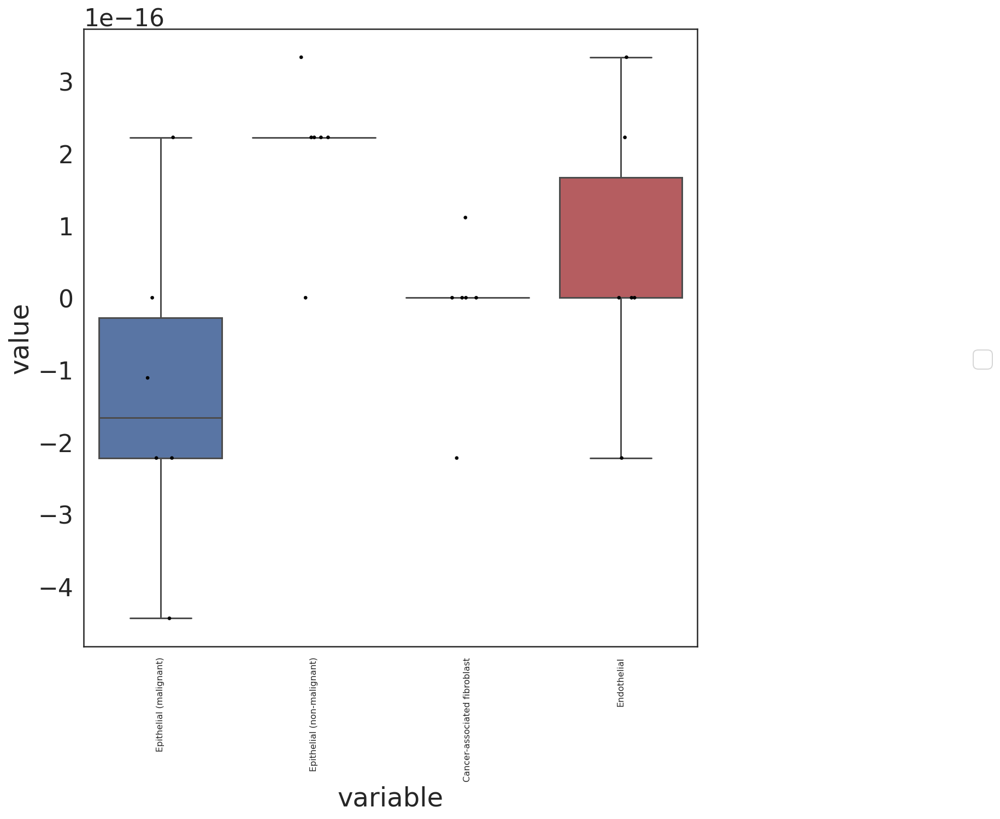

In [320]:
#plot
sns.set_style('white')
save_name ='Carbon_intrapatient_mod_230607.svg'
order = ['Epithelial (malignant)','Epithelial (non-malignant)','Cancer-associated fibroblast', 'Endothelial']
fig, ax = plt.subplots(figsize=(10,10))
sns.boxplot(data=modularity_df_melt,x='variable',
                y='value', order=order, 
                orient=None, saturation=0.75, width=0.8, 
                dodge=True, fliersize=0, linewidth=None, whis=1.5, ax=None)
sns.stripplot(data=modularity_df_melt,x='variable',
                y='value', order=order, 
                orient=None, color='#000000',s=3,
                dodge=True, linewidth=None, ax=None)
#plt.ylim(-.2,1)
#plt.axhline(1)
plt.legend(bbox_to_anchor=[1.5, 0.5])
plt.xticks(rotation=90,size=8)
plt.savefig(fig_save_path+save_name)
print(save_name)

In [252]:
adata

AnnData object with n_obs × n_vars = 224988 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCA

In [260]:
adata_input = adata[adata.obs['pretreated']=='True']
import sys
import warnings

if not sys.warnoptions:
    warnings.simplefilter("ignore")

downsample = 15000#50
all_vars = all_chemokines
sample_cat = 'pid'
linkage_distances = [1.0,1.1,1.2,1.3,1.4,1.5,1.6,1.7,1.8]

sample_ids = merged_high_patients

celltype_iter = ['Epithelial (malignant)','Cancer-associated fibroblast','Endothelial',
                'Epithelial (non-malignant)']
celltype_obs = 'Level 1 Annotation'

modularity_df = pd.DataFrame()
for celltype in celltype_iter:
    iter_val = 0
    while iter_val <10:
        adata_subset = adata_input[adata_input.obs[celltype_obs]==celltype]
        #adata_ls = []
        #for i in sample_ids:
        #    adata_sub_sub = adata_subset[adata_subset.obs[sample_cat]==i]
        #    adata_sub_sub = adata_sub_sub[adata_sub_sub.obs.sample(n=downsample,replace=True).index,all_vars]
        #    adata_ls.append(adata_sub_sub)
        #adata_sub_sub = adata_ls[0].concatenate(adata_ls[1:])
        adata_sub_sub = adata_subset
        adata_sub_sub = adata_sub_sub[adata_sub_sub.obs.sample(n=downsample,replace=True).index,all_vars]
        plot_df_corr = pd.DataFrame(adata_sub_sub.X.todense(),index=adata_sub_sub.obs_names,
                                                  columns=all_chemokines)


        modularities = []
        for dist in linkage_distances: 

            try:
                corr_clusters =  corr_cov_matrix_cluster(plot_df_corr,markers=['all_markers'], metric='spearman',
                                                clustering_method = 'average', linkage_distance=dist)

                # Convert the correlation matrix into a graph
                corr_matrix = np.array(corr_clusters[0])
                G = nx.from_numpy_matrix(corr_matrix)
                partition = []
                nodes =list(G.nodes)
                clusters = corr_clusters[1]
                for cluster in set(clusters):
                    community = []
                    for ind,va in enumerate(nodes):
                        if clusters[ind]==cluster:
                            community.append(va)
                    partition.append(set(community))


                modularities.append(nx.community.modularity(G, partition, weight='weight', resolution=1))
            except:
                modularities.append(0)
        modularity_df.loc[iter_val,celltype] = np.max(modularities)
        iter_val += 1
    print('finalized celltype',celltype)
modularity_df

finalized celltype Epithelial (malignant)
finalized celltype Cancer-associated fibroblast
finalized celltype Endothelial
finalized celltype Epithelial (non-malignant)


,Epithelial (malignant),Cancer-associated fibroblast,Endothelial,Epithelial (non-malignant)
0,0.852808,0.922710,0.918040,0.861663
1,0.862663,0.894390,0.902544,0.870132
2,0.879770,0.900143,0.902305,0.881326
3,0.867363,0.904021,0.909077,0.895331
4,0.876501,0.928877,0.915295,0.883842
5,0.872882,0.913426,0.915156,0.877270
6,0.874165,0.918918,0.924271,0.857856
7,0.853345,0.914474,0.912773,0.851563
8,0.877192,0.915490,0.915016,0.865921
9,0.872069,0.912305,0.908304,0.869441


In [322]:
def randomize_cells(anndata_object):
    "Randomize cells for plotting "
    index_list = np.arange(anndata_object.shape[0])
    np.random.shuffle(index_list)
    anndata_object = anndata_object[index_list]
    return anndata_object


In [326]:
np.cov(adata_subset[adata_subset[adata_subset.obs[sample_cat]==i].obs.sample(n=n_sampling, replace=True, random_state=1, axis=0).index,:].X.T)

AttributeError: 'float' object has no attribute 'shape'

In [329]:
set(adata_iter.obs['pid'])

{'T1',
 'T10',
 'T11',
 'T12',
 'T13',
 'T14',
 'T15',
 'T16',
 'T17',
 'T18',
 'T19',
 'T2',
 'T20',
 'T21',
 'T3',
 'T4',
 'T5',
 'T6',
 'T7',
 'T8',
 'T9',
 'U1',
 'U10',
 'U11',
 'U12',
 'U13',
 'U14',
 'U15',
 'U16',
 'U17',
 'U18',
 'U2',
 'U3',
 'U4',
 'U5',
 'U6',
 'U7',
 'U8',
 'U9'}

In [359]:
#bootstrap phenotypic volumes
n_iter = 3
sample_ids = merged_high_patients
all_vars = all_chemokines
celltype_iter = ['Epithelial (malignant)','Cancer-associated fibroblast','Endothelial',
                'Epithelial (non-malignant)']
celltype_obs = 'Level 1 Annotation'
sample_cat = 'pid'
n_sampling = 50
adata_iter = adata[adata.obs['pretreated']=='True']
adata_iter = adata_iter[adata_iter.obs[sample_cat].isin(sample_ids)]
adata_iter = adata_iter[:,all_vars]



pheno_vol_df = pd.DataFrame()

for celltype in celltype_iter:
    volume_df = pd.DataFrame()
    adata_subset = adata_iter[adata_iter.obs[celltype_obs]==celltype]
    #untreated samples
    all_samples = list(set(adata_subset.obs[sample_cat]))

    ##initialize variables
    counter = 0

    ##bootstrap
    while counter <n_iter:
        pheno_vol_samples = []
        for i in all_samples:
            print('starting sample', i)
            cov = np.cov(adata_subset[adata_subset[adata_subset.obs[sample_cat]==i].obs.sample(n=n_sampling, replace=True, axis=0).index,:].X.T.todense())
            eigval = scipy.linalg.eigvalsh(cov)
            phenovolume = np.sum(np.log(eigval[~np.isclose(eigval,0)]))
            pheno_vol_samples.append(phenovolume)
        counter=counter+1
        volume_df[counter]= pheno_vol_samples
        print('finalized iteration number ',counter)
    pheno_vol_df[celltype]= np.mean(volume_df,axis=1)
    print('finalized celltype',celltype)
pheno_vol_df.index = all_samples

starting sample T3
starting sample T20
starting sample T1
starting sample T19
starting sample T12
starting sample T7
finalized iteration number  1
starting sample T3
starting sample T20
starting sample T1
starting sample T19
starting sample T12
starting sample T7
finalized iteration number  2
starting sample T3
starting sample T20
starting sample T1
starting sample T19
starting sample T12
starting sample T7
finalized iteration number  3
finalized celltype Epithelial (malignant)
starting sample T3
starting sample T20
starting sample T1
starting sample T19
starting sample T12
starting sample T7
finalized iteration number  1
starting sample T3
starting sample T20
starting sample T1
starting sample T19
starting sample T12
starting sample T7
finalized iteration number  2
starting sample T3
starting sample T20
starting sample T1
starting sample T19
starting sample T12
starting sample T7
finalized iteration number  3
finalized celltype Cancer-associated fibroblast
starting sample T3
starting 

In [361]:
np.mean(pheno_vol_df)

Epithelial (malignant)         -14.052975
Cancer-associated fibroblast    -4.443814
Endothelial                     -8.901950
Epithelial (non-malignant)     -15.621349
dtype: float64

In [362]:
#bootstrap phenotypic volumes
n_iter = 3
sample_ids = merged_high_patients
all_vars = all_chemokines
celltype_iter = ['Epithelial (malignant)','Cancer-associated fibroblast','Endothelial',
                'Epithelial (non-malignant)']
celltype_obs = 'Level 1 Annotation'
sample_cat = 'pid'
n_sampling = 50
adata_iter = adata[adata.obs['pretreated']=='True']
adata_iter = adata_iter[adata_iter.obs[sample_cat].isin(sample_ids)]
adata_iter = adata_iter[:,all_vars]



pheno_vol_df = pd.DataFrame()

for celltype in celltype_iter:
    adata_subset = adata_iter[adata_iter.obs[celltype_obs]==celltype]
    #untreated samples
    all_samples = list(set(adata_subset.obs[sample_cat]))

    ##initialize variables
    counter = 0

    ##bootstrap
    while counter <n_iter:
        pheno_vol_samples = []
        adata_ls = []
        for i in sample_ids:
            adata_iter_sub = adata_subset[adata_subset.obs[sample_cat]==i]
            adata_ls.append(adata_iter_sub[adata_iter_sub.obs.sample(n=n_sampling, replace=True, axis=0).index,:])
        adata_subset_sampled = adata_ls[0].concatenate(adata_ls[1:])

        cov = np.cov(adata_subset_sampled.X.T.todense())
        eigval = scipy.linalg.eigvalsh(cov)
        phenovolume = np.sum(np.log(eigval[~np.isclose(eigval,0)]))
        counter+=1
        print('finalized iteration number ',counter)
        pheno_vol_df.loc[counter,celltype]= phenovolume
    print('finalized celltype',celltype)


finalized iteration number  1
finalized iteration number  2
finalized iteration number  3
finalized celltype Epithelial (malignant)
finalized iteration number  1
finalized iteration number  2
finalized iteration number  3
finalized celltype Cancer-associated fibroblast
finalized iteration number  1
finalized iteration number  2
finalized iteration number  3
finalized celltype Endothelial
finalized iteration number  1
finalized iteration number  2
finalized iteration number  3
finalized celltype Epithelial (non-malignant)


In [363]:
pheno_vol_df

,Epithelial (malignant),Cancer-associated fibroblast,Endothelial,Epithelial (non-malignant)
1,-57.570823,-18.164140,-34.577889,-43.471645
2,-45.360135,-28.888651,-56.640417,-57.977144
3,-53.944047,-18.764401,-42.772790,-45.240370


In [365]:
np.mean(pheno_vol_df)

Epithelial (malignant)         -52.291668
Cancer-associated fibroblast   -21.939064
Endothelial                    -44.663699
Epithelial (non-malignant)     -48.896386
dtype: float64

In [262]:
modularity_df_melt = pd.melt(modularity_df)
modularity_df_melt

,variable,value
0,Epithelial (malignant),0.852808
1,Epithelial (malignant),0.862663
2,Epithelial (malignant),0.879770
3,Epithelial (malignant),0.867363
4,Epithelial (malignant),0.876501
5,Epithelial (malignant),0.872882
6,Epithelial (malignant),0.874165
7,Epithelial (malignant),0.853345
8,Epithelial (malignant),0.877192
9,Epithelial (malignant),0.872069


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Carbon_intrapatient_mod_230607.svg


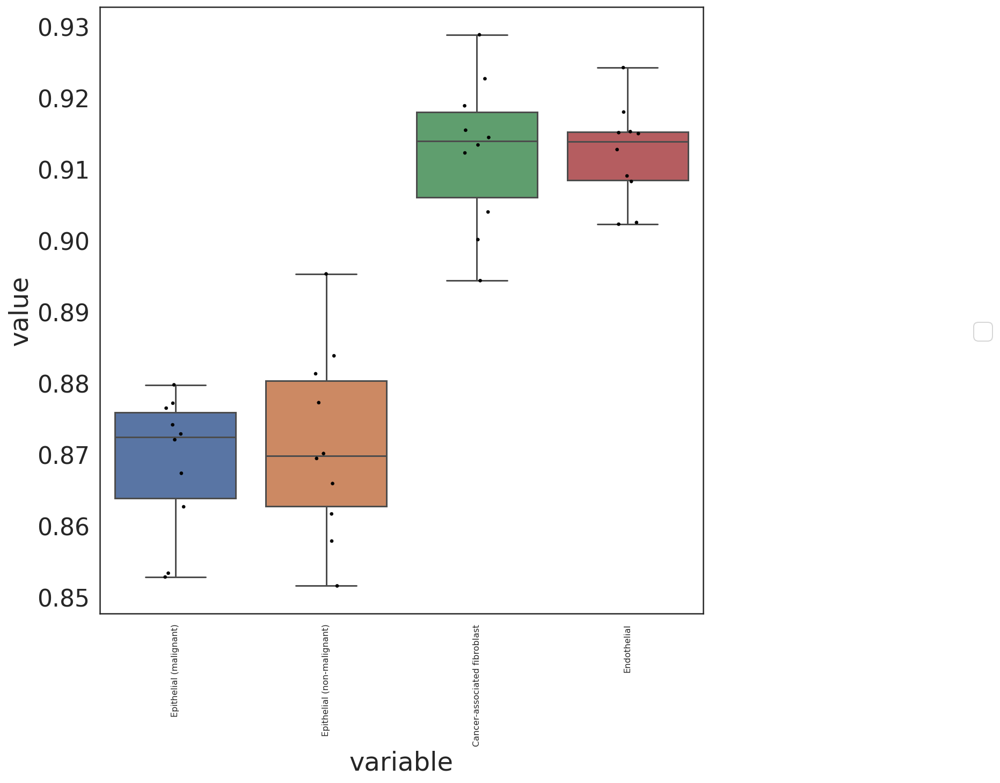

In [263]:
#plot
sns.set_style('white')
save_name ='Carbon_intrapatient_mod_230607.svg'
order = ['Epithelial (malignant)','Epithelial (non-malignant)','Cancer-associated fibroblast', 'Endothelial']
fig, ax = plt.subplots(figsize=(10,10))
sns.boxplot(data=modularity_df_melt,x='variable',
                y='value', order=order, 
                orient=None, saturation=0.75, width=0.8, 
                dodge=True, fliersize=0, linewidth=None, whis=1.5, ax=None)
sns.stripplot(data=modularity_df_melt,x='variable',
                y='value', order=order, 
                orient=None, color='#000000',s=3,
                dodge=True, linewidth=None, ax=None)
#plt.ylim(-.2,1)
#plt.axhline(1)
plt.legend(bbox_to_anchor=[1.5, 0.5])
plt.xticks(rotation=90,size=8)
plt.savefig(fig_save_path+save_name)
print(save_name)

In [38]:
cell_type_proportions['treated'] = [x[0] for x in cell_type_proportions.index]
cell_type_proportions = cell_type_proportions[cell_type_proportions['treated']=='T']
cell_type_proportions = cell_type_proportions.drop(columns=['treated'])
cell_type_proportions

Level 1 Annotation,Cancer-associated fibroblast,Pericyte,Endothelial,Epithelial (malignant),Myeloid,Adipocyte,Schwann,Lymphoid,Epithelial (non-malignant),Endocrine,Intra-pancreatic neurons,Vascular smooth muscle
T14,0.569201,0.208751,0.126919,0.041339,0.025142,0.019461,0.005198,0.002901,0.001088,0.000000,0.000000,0.000000
T15,0.341093,0.013602,0.053884,0.010201,0.067748,0.000000,0.012817,0.047345,0.369343,0.080565,0.000262,0.003139
T25,0.468675,0.017802,0.028757,0.152687,0.066758,0.000000,0.003766,0.012325,0.235878,0.007874,0.000000,0.005478
T19,0.380290,0.056234,0.121556,0.028401,0.109628,0.014485,0.007384,0.106788,0.016473,0.155922,0.000852,0.001988
T18,0.299479,0.132440,0.083705,0.024182,0.129464,0.000372,0.009673,0.102679,0.001116,0.213542,0.000000,0.003348
T16,0.746535,0.019487,0.027446,0.003294,0.113353,0.016879,0.002333,0.064361,0.000823,0.000274,0.000000,0.005215
T24,0.104613,0.013440,0.058845,0.011624,0.023247,0.000363,0.004359,0.004359,0.767890,0.011260,0.000000,0.000000
T23,0.158106,0.021526,0.077494,0.023011,0.046467,0.000000,0.008165,0.024792,0.598872,0.037559,0.000000,0.004008
T1,0.039831,0.005745,0.085025,0.233244,0.025278,0.000000,0.011107,0.164305,0.249330,0.186136,0.000000,0.000000
T10,0.099875,0.017969,0.116590,0.001672,0.096949,0.001254,0.004597,0.022148,0.591308,0.047639,0.000000,0.000000


In [46]:
celltype_pp = adata[adata.obs['pid'].isin(cell_type_proportions.index)].obs['pid'].value_counts() * cell_type_proportions.T
celltype_pp

,T1,T10,T11,T12,T13,T14,T15,T16,T17,T18,...,T23,T24,T25,T3,T4,T5,T6,T7,T8,T9
Level 1 Annotation,,,,,,,,,,,,,,,,,,,,,
Cancer-associated fibroblast,104.0,239.0,1198.0,494.0,3223.0,4709.0,1304.0,5440.0,265.0,805.0,...,1065.0,288.0,1369.0,145.0,484.0,3223.0,2737.0,1699.0,239.0,183.0
Pericyte,15.0,43.0,1742.0,95.0,1606.0,1727.0,52.0,142.0,28.0,356.0,...,145.0,37.0,52.0,17.0,88.0,106.0,243.0,126.0,109.0,16.0
Endothelial,222.0,279.0,1014.0,380.0,2466.0,1050.0,206.0,200.0,95.0,225.0,...,522.0,162.0,84.0,101.0,244.0,313.0,477.0,318.0,167.0,70.0
Epithelial (malignant),609.0,4.0,33.0,1304.0,6.0,342.0,39.0,24.0,182.0,65.0,...,155.0,32.0,446.0,4865.0,46.0,1426.0,1501.0,85.0,35.0,3.0
Myeloid,66.0,232.0,93.0,90.0,468.0,208.0,259.0,826.0,540.0,348.0,...,313.0,64.0,195.0,2.0,648.0,209.0,334.0,545.0,155.0,14.0
Adipocyte,0.0,3.0,10.0,2.0,102.0,161.0,0.0,123.0,0.0,1.0,...,0.0,1.0,0.0,0.0,11.0,0.0,0.0,0.0,19.0,2.0
Schwann,29.0,11.0,46.0,8.0,86.0,43.0,49.0,17.0,2.0,26.0,...,55.0,12.0,11.0,5.0,17.0,40.0,134.0,48.0,27.0,15.0
Lymphoid,429.0,53.0,32.0,36.0,1178.0,24.0,181.0,469.0,111.0,276.0,...,167.0,12.0,36.0,1.0,152.0,2.0,37.0,125.0,858.0,2.0
Epithelial (non-malignant),651.0,1415.0,488.0,1597.0,103.0,9.0,1412.0,6.0,3.0,3.0,...,4034.0,2114.0,689.0,346.0,3220.0,2.0,0.0,3055.0,1.0,2793.0


In [66]:
celltype_pp.loc['Cancer-associated fibroblast'].sort_values()

T21      14.0
T1      104.0
T3      145.0
T9      183.0
T10     239.0
T8      239.0
T17     265.0
T24     288.0
T4      484.0
T12     494.0
T18     805.0
T2      819.0
T23    1065.0
T11    1198.0
T22    1258.0
T15    1304.0
T19    1339.0
T25    1369.0
T20    1491.0
T7     1699.0
T6     2737.0
T13    3223.0
T5     3223.0
T14    4709.0
T16    5440.0
Name: Cancer-associated fibroblast, dtype: float64

In [65]:
celltype_pp.loc['Endothelial'].sort_values()

T9       70.0
T25      84.0
T21      92.0
T17      95.0
T3      101.0
T24     162.0
T8      167.0
T16     200.0
T22     206.0
T15     206.0
T1      222.0
T18     225.0
T4      244.0
T2      262.0
T10     279.0
T5      313.0
T7      318.0
T12     380.0
T19     428.0
T6      477.0
T23     522.0
T20     924.0
T11    1014.0
T14    1050.0
T13    2466.0
Name: Endothelial, dtype: float64

In [63]:
celltype_pp.loc['Epithelial (malignant)'].sort_values()

T9        3.0
T10       4.0
T13       6.0
T2        9.0
T21       9.0
T16      24.0
T24      32.0
T11      33.0
T8       35.0
T15      39.0
T22      44.0
T4       46.0
T18      65.0
T7       85.0
T19     100.0
T23     155.0
T20     175.0
T17     182.0
T14     342.0
T25     446.0
T1      609.0
T12    1304.0
T5     1426.0
T6     1501.0
T3     4865.0
Name: Epithelial (malignant), dtype: float64

In [64]:
celltype_pp.loc['Epithelial (non-malignant)'].sort_values()

T6        0.0
T8        1.0
T5        2.0
T17       3.0
T18       3.0
T16       6.0
T14       9.0
T21      25.0
T19      58.0
T13     103.0
T3      346.0
T11     488.0
T20     507.0
T1      651.0
T25     689.0
T15    1412.0
T10    1415.0
T12    1597.0
T22    1983.0
T24    2114.0
T9     2793.0
T2     3052.0
T7     3055.0
T4     3220.0
T23    4034.0
Name: Epithelial (non-malignant), dtype: float64

In [105]:
thresh = 50
less_50_fibro = celltype_pp.loc['Cancer-associated fibroblast'].sort_values()[celltype_pp.loc['Cancer-associated fibroblast'].sort_values()>thresh]
less_50_fibro.index

Index(['T1', 'T3', 'T9', 'T10', 'T8', 'T17', 'T24', 'T4', 'T12', 'T18', 'T2',
       'T23', 'T11', 'T22', 'T15', 'T19', 'T25', 'T20', 'T7', 'T6', 'T13',
       'T5', 'T14', 'T16'],
      dtype='object')

In [106]:
less_50_epinm = celltype_pp.loc['Epithelial (non-malignant)'].sort_values()[celltype_pp.loc['Epithelial (non-malignant)'].sort_values()>thresh]
less_50_epinm.index

Index(['T19', 'T13', 'T3', 'T11', 'T20', 'T1', 'T25', 'T15', 'T10', 'T12',
       'T22', 'T24', 'T9', 'T2', 'T7', 'T4', 'T23'],
      dtype='object')

In [107]:
less_50_epim = celltype_pp.loc['Epithelial (malignant)'].sort_values()[celltype_pp.loc['Epithelial (malignant)'].sort_values()>thresh]
less_50_epim.index

Index(['T18', 'T7', 'T19', 'T23', 'T20', 'T17', 'T14', 'T25', 'T1', 'T12',
       'T5', 'T6', 'T3'],
      dtype='object')

In [108]:
less_50_fibro = celltype_pp.loc['Endothelial'].sort_values()[celltype_pp.loc['Endothelial'].sort_values()>thresh]
less_50_fibro.index

Index(['T9', 'T25', 'T21', 'T17', 'T3', 'T24', 'T8', 'T16', 'T22', 'T15', 'T1',
       'T18', 'T4', 'T2', 'T10', 'T5', 'T7', 'T12', 'T19', 'T6', 'T23', 'T20',
       'T11', 'T14', 'T13'],
      dtype='object')

In [109]:
merged_high_patients = set(less_50_fibro.index).intersection(set(less_50_epim.index))
merged_high_patients =merged_high_patients.intersection(set(less_50_epinm.index))
merged_high_patients =merged_high_patients.intersection(set(less_50_fibro.index))
len(merged_high_patients)

8

In [132]:
corr_clusters =  corr_cov_matrix_cluster(plot_df_corr,markers=['all_markers'], metric='spearman',
                                        clustering_method = 'average', linkage_distance=dist)

In [ ]:

plot_df_corr = pd.DataFrame(adata_subset[:,all_chemokines].layers['imputed'],index=adata_subset.obs_names,
                                              columns=all_chemokines)
#plot_df_corr =scipy.stats.zscore(plot_df_corr)
plot_df_corr =  corr_cov_matrix_cluster(plot_df_corr,markers=['all_markers'], metric='spearman',
                                        clustering_method = 'average', linkage_distance=1.65)
plot_df_corr

## Receptor modules

In [697]:
interaction_dict_path = '/data/peer/wallet/Jupyter/2023_Particle_SASP/2023_Particle_SASP/notebooks/Ligand_Receptor_Pairs_TW_220804.csv'
ligand_modules = [['CCL19', 'CCL21', 'CCL4', 'CCL5', 'CXCL10', 'CXCL12', 'CXCL13', 'CXCL9'],
 ['CXCL2', 'CXCL3'],
 ['CCL13', 'CCL18', 'CCL3', 'CCL7'],
 ['CCL14',
  'CCL15',
  'CCL16',
  'CCL17',
  'CCL23',
  'CCL24',
  'CCL25',
  'CCL26',
  'CCL8'],
 ['CCL11',
  'CCL2',
  'CCL20',
  'CCL22',
  'CCL27',
  'CCL28',
  'CX3CL1',
  'CXCL1',
  'CXCL11',
  'CXCL16',
  'CXCL5',
  'CXCL6',
  'CXCL8']]

In [578]:
interaction_df = pd.read_csv(interaction_dict_path)
interaction_df

,Ligand,Ligand_ENSEMBL,Receptor,Receptor_ENSEMBL,species,SOURCE (Literature or DAC-curated),DOI
0,ADIPOQ,NaN,ADIPOR1,NaN,homo_sapiens,DAC-curated,NaN
1,ADIPOQ,NaN,ADIPOR2,NaN,homo_sapiens,DAC-curated,NaN
2,ADORA1,NaN,ADORA2A,NaN,homo_sapiens,Steele et al. Nature Cancer 2020 (SUP TABLE 5),NaN
3,APOB,NaN,LDLR,NaN,homo_sapiens,Steele et al. Nature Cancer 2020 (SUP TABLE 5),NaN
4,APOE,NaN,LDLR,NaN,homo_sapiens,Steele et al. Nature Cancer 2020 (SUP TABLE 5),NaN
...,...,...,...,...,...,...,...
1076,TNFSF8,MGP_LPJ_G0028287,TNFRSF8,ENSMUSG00000028602,NaN,wallet,NaN
1077,NaN,NaN,VSIR,ENSMUSG00000020101,NaN,wallet,NaN
1078,NaN,NaN,VSIR,ENSG00000107738,NaN,wallet,NaN
1079,XCL1,ENSMUSG00000026573,XCR1,ENSMUSG00000060509,NaN,wallet,NaN


In [579]:
interaction_df = interaction_df[interaction_df['species']=='homo_sapiens']
interaction_df = interaction_df.set_index('Ligand')
interaction_df

,Ligand_ENSEMBL,Receptor,Receptor_ENSEMBL,species,SOURCE (Literature or DAC-curated),DOI
Ligand,,,,,,
ADIPOQ,NaN,ADIPOR1,NaN,homo_sapiens,DAC-curated,NaN
ADIPOQ,NaN,ADIPOR2,NaN,homo_sapiens,DAC-curated,NaN
ADORA1,NaN,ADORA2A,NaN,homo_sapiens,Steele et al. Nature Cancer 2020 (SUP TABLE 5),NaN
APOB,NaN,LDLR,NaN,homo_sapiens,Steele et al. Nature Cancer 2020 (SUP TABLE 5),NaN
APOE,NaN,LDLR,NaN,homo_sapiens,Steele et al. Nature Cancer 2020 (SUP TABLE 5),NaN
...,...,...,...,...,...,...
IFNA2,ENSG00000188379,IFNAR2,ENSG00000159110,homo_sapiens,wallet,NaN
IFNA7,ENSG00000214042,IFNAR2,ENSG00000159110,homo_sapiens,wallet,NaN
IFNA8,ENSG00000120242,IFNAR2,ENSG00000159110,homo_sapiens,wallet,NaN


In [580]:
interaction_dict = {}
for i in set(interaction_df.index):
    interaction_df_sub = interaction_df.loc[i]
    if isinstance(interaction_df.loc[i]['Receptor'],pd.core.series.Series):
        interaction_dict[i] = list(interaction_df.loc[i]['Receptor'])
    else:
        interaction_dict[i] = [interaction_df.loc[i]['Receptor']]

In [599]:
receptors= []
for i in ligand_modules:
    for x in i:
        receptors = receptors+ interaction_dict[x]      

receptors = list(set(receptors))
receptors = [x for x in receptors if x in adata.var_names]

In [600]:
receptors

['CCR6',
 'CXCR3',
 'CCRL2',
 'ACKR4',
 'ACKR2',
 'SDC2',
 'CCR10',
 'ACKR1',
 'GPR75',
 'CCR2',
 'CCR5',
 'CXCR4',
 'CCR3',
 'CXCR1',
 'CCR4',
 'CCR9',
 'SDC1',
 'SDC4',
 'ACKR3',
 'CD4',
 'CCR8',
 'CX3CR1',
 'CXCR2',
 'CCR1',
 'HRH4',
 'CCR7',
 'ITGB1',
 'CXCR5',
 'CXCR6']

In [601]:
set(adata.obs['Level 1 Annotation'])

{'Adipocyte',
 'Cancer-associated fibroblast',
 'Endocrine',
 'Endothelial',
 'Epithelial (malignant)',
 'Epithelial (non-malignant)',
 'Intra-pancreatic neurons',
 'Lymphoid',
 'Myeloid',
 'Pericyte',
 'Schwann',
 'Vascular smooth muscle'}

In [602]:
adata_crc = adata[adata.obs['Level 1 Annotation'].isin([ 'Lymphoid',
 'Myeloid',])]


In [780]:
adata_subset = adata[adata.obs['Level 1 Annotation'].isin([ 'Lymphoid',
 'Myeloid',])]
adata_subset = adata_subset[adata_subset.obs['pretreated']=='True']
plot_df_corr = pd.DataFrame(adata_subset[:,receptors].layers['imputed'],index=adata_subset.obs_names,
                                              columns=receptors)
#plot_df_corr =scipy.stats.zscore(plot_df_corr)
plot_df_corr =  corr_cov_matrix_cluster(plot_df_corr,markers=['all_markers'], metric='spearman',
                                        clustering_method = 'average', linkage_distance=1.5)
plot_df_corr

[            CCR6     CXCR3     CCRL2     ACKR4     ACKR2      SDC2     CCR10  \
 CCR6    1.000000  0.125826 -0.298342  0.353422  0.030236 -0.371836  0.023872   
 CXCR3   0.125826  1.000000 -0.131084  0.133475  0.394357 -0.164535  0.043987   
 CCRL2  -0.298342 -0.131084  1.000000 -0.041436 -0.019107  0.684716  0.005453   
 ACKR4   0.353422  0.133475 -0.041436  1.000000  0.157692 -0.043017 -0.022162   
 ACKR2   0.030236  0.394357 -0.019107  0.157692  1.000000 -0.016544  0.017624   
 SDC2   -0.371836 -0.164535  0.684716 -0.043017 -0.016544  1.000000 -0.082103   
 CCR10   0.023872  0.043987  0.005453 -0.022162  0.017624 -0.082103  1.000000   
 ACKR1   0.110964  0.073884 -0.077912  0.061417  0.002766 -0.081127 -0.010219   
 CCR2    0.145138  0.078813 -0.184869  0.011221  0.068092 -0.199507  0.101158   
 CCR5    0.208672 -0.043340 -0.105273  0.115391  0.049740 -0.168419 -0.107344   
 CXCR4   0.362057  0.167990 -0.188042 -0.016156 -0.036379 -0.382558  0.172176   
 CCR3    0.091813  0.538836 

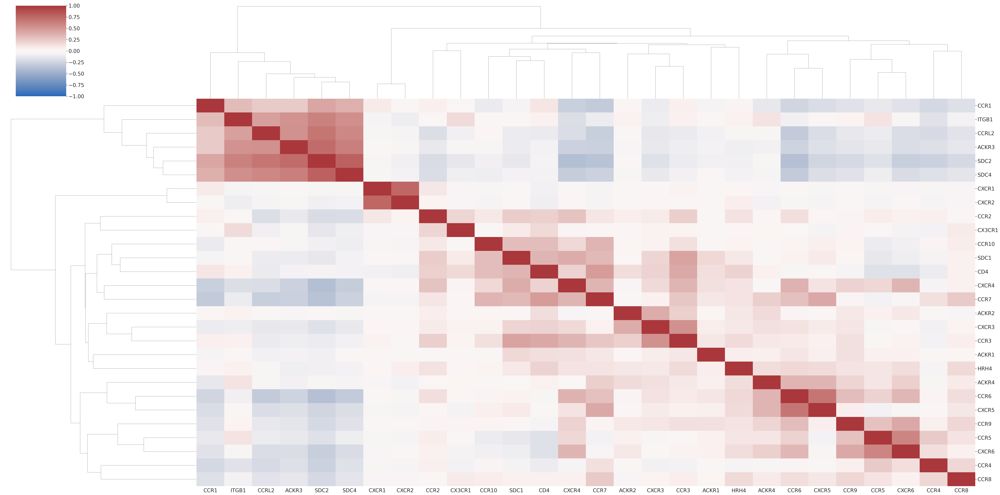

In [781]:
#SEACElls non imputed
import scipy
%matplotlib inline
sns.set(font_scale=2)
clustergrid = sns.clustermap(plot_df_corr[0], cmap='vlag', col_cluster=True,row_cluster=True, figsize=(60,30), 
                             #row_linkage=plot_df_corr[1],col_linkage=plot_df_corr[2],
                             vmin=-1,vmax=1,center=0,
               z_score=None) 

In [782]:
#SEACElls non imputed
row_colors = [color_map_clusters_nogrey[x] for x in plot_df_corr[1]]
col_colors = [color_map_clusters_nogrey[x] for x in plot_df_corr[1]]
sns.set(font_scale=2)
clustergrid = sns.clustermap(plot_df_corr[0], cmap='vlag',# col_cluster=True,row_cluster=True, 
                             figsize=(60,60), 
                             row_linkage=plot_df_corr[2],col_linkage=plot_df_corr[2],
                             row_colors = row_colors, col_colors=col_colors,
                             vmin=-.6,vmax=.6,center=0,
               z_score=None) 

In [783]:
cluster_labels =plot_df_corr[1]
variable_names =plot_df_corr[0].index
# Get the indices of samples in each cluster
clusters = np.unique(cluster_labels)
cluster_indices = [np.where(cluster_labels == c)[0] for c in clusters]

# Get the variable names for each cluster
cluster_variable_names = [[variable_names[i] for i in ci] for ci in cluster_indices]

print(cluster_variable_names)

[['CCRL2', 'SDC2', 'SDC4', 'ACKR3', 'CCR1', 'ITGB1'], ['CXCR1', 'CXCR2'], ['CXCR3', 'ACKR2', 'CCR10', 'ACKR1', 'CCR2', 'CXCR4', 'CCR3', 'SDC1', 'CD4', 'CX3CR1', 'HRH4', 'CCR7'], ['CCR6', 'ACKR4', 'CXCR5'], ['CCR5', 'CCR4', 'CCR9', 'CCR8', 'CXCR6']]


In [787]:
receptor_modules =[['CCRL2', 'SDC2', 'SDC4', 'ACKR3', 'CCR1', 'ITGB1'], ['CXCR1', 'CXCR2'], ['CXCR3', 'ACKR2', 'CCR10', 'ACKR1', 'CCR2', 'CXCR4', 'CCR3', 'SDC1', 'CD4', 'CX3CR1', 'HRH4', 'CCR7'], ['CCR6', 'ACKR4', 'CXCR5'], ['CCR5', 'CCR4', 'CCR9', 'CCR8', 'CXCR6']]
receptor_modules

[['CCRL2', 'SDC2', 'SDC4', 'ACKR3', 'CCR1', 'ITGB1'],
 ['CXCR1', 'CXCR2'],
 ['CXCR3',
  'ACKR2',
  'CCR10',
  'ACKR1',
  'CCR2',
  'CXCR4',
  'CCR3',
  'SDC1',
  'CD4',
  'CX3CR1',
  'HRH4',
  'CCR7'],
 ['CCR6', 'ACKR4', 'CXCR5'],
 ['CCR5', 'CCR4', 'CCR9', 'CCR8', 'CXCR6']]

In [788]:
connection_df = pd.DataFrame()
for i,module in enumerate(ligand_modules):
    for j,receptor_module in enumerate(receptor_modules):
        connections_sum = 0
        for ligand in module:
            interaction_partners = interaction_dict[ligand]
            connections = [x for x in interaction_partners if x in receptor_module]
            connections_sum += len(connections)
        connection_df.loc['ligand_mod_'+str(i),'receptor_mod_'+str(j)] = connections_sum

In [789]:
connection_df

,receptor_mod_0,receptor_mod_1,receptor_mod_2,receptor_mod_3,receptor_mod_4
ligand_mod_0,7.0,0.0,23.0,5.0,4.0
ligand_mod_1,0.0,6.0,0.0,0.0,0.0
ligand_mod_2,3.0,0.0,12.0,2.0,4.0
ligand_mod_3,6.0,0.0,17.0,2.0,7.0
ligand_mod_4,3.0,8.0,22.0,3.0,5.0


In [790]:
import random
import copy

iter_count=0
df_comp_list = []
iter_num = 10000

ligand_modules_random = copy.deepcopy(ligand_modules)
elements = set()
for l in ligand_modules_random:
    elements.update(l)
        
while iter_count <iter_num:

    connection_df_random = pd.DataFrame()

    #shuffle the ligand list of lists randomly

    for l in ligand_modules_random:
        l[:] = random.sample(elements, len(l))
    for i,module in enumerate(ligand_modules_random):
        for j,receptor_module in enumerate(receptor_modules):
            connections_sum = 0
            for ligand in module:
                interaction_partners = interaction_dict[ligand]
                connections = [x for x in interaction_partners if x in receptor_module]
                connections_sum += len(connections)
            connection_df_random.loc['ligand_mod_'+str(i),'receptor_mod_'+str(j)] = connections_sum

    #compare whether the real data has more connections than the random
    df_comp_list.append( connection_df_random>connection_df)

    iter_count+=1

In [791]:
merged_df = df_comp_list[0].astype(int)
for i in df_comp_list[1:]:
    merged_df = merged_df+ i.astype(int)

In [792]:
merged_df/iter_num

,receptor_mod_0,receptor_mod_1,receptor_mod_2,receptor_mod_3,receptor_mod_4
ligand_mod_0,0.0167,0.8065,0.0470,0.0206,0.4737
ligand_mod_1,0.7275,0.0000,0.9665,0.5327,0.6283
ligand_mod_2,0.1240,0.5303,0.0851,0.1297,0.0692
ligand_mod_3,0.1322,0.8478,0.5757,0.6170,0.1096
ligand_mod_4,0.9747,0.1075,0.8175,0.7003,0.7792


In [793]:
set(adata_subset.obs['Level 2 Annotation'])

{'B',
 'CD4+ T',
 'CD8+ T',
 'Dendritic',
 'Macrophage',
 'Mast',
 'Natural killer',
 'Neutrophil',
 'Plasma',
 'Treg'}

In [794]:
set(adata_subset.obs['pretreated'])

{'True'}

In [855]:
receptor_name_ls = []
for i,v in enumerate(receptor_modules):
    receptor_name = 'receptor_mod_'+str(i)
    adata_subset.obs[receptor_name] = list(np.mean(adata_subset[:,v].layers['zscored'],axis=1))
    receptor_name_ls.append(receptor_name)

In [845]:
receptor_name_ls_imputed = []
for i,v in enumerate(receptor_modules):
    receptor_name = 'receptor_mod_imputed_'+str(i)
    adata_subset.obs[receptor_name] = list(np.mean(np.array(adata_subset[:,v].X.todense()),axis=1))
    receptor_name_ls_imputed.append(receptor_name)

In [846]:
receptor_name_ls_imputed

['receptor_mod_imputed_0',
 'receptor_mod_imputed_1',
 'receptor_mod_imputed_2',
 'receptor_mod_imputed_3',
 'receptor_mod_imputed_4']

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_Level 2 Annotation']`


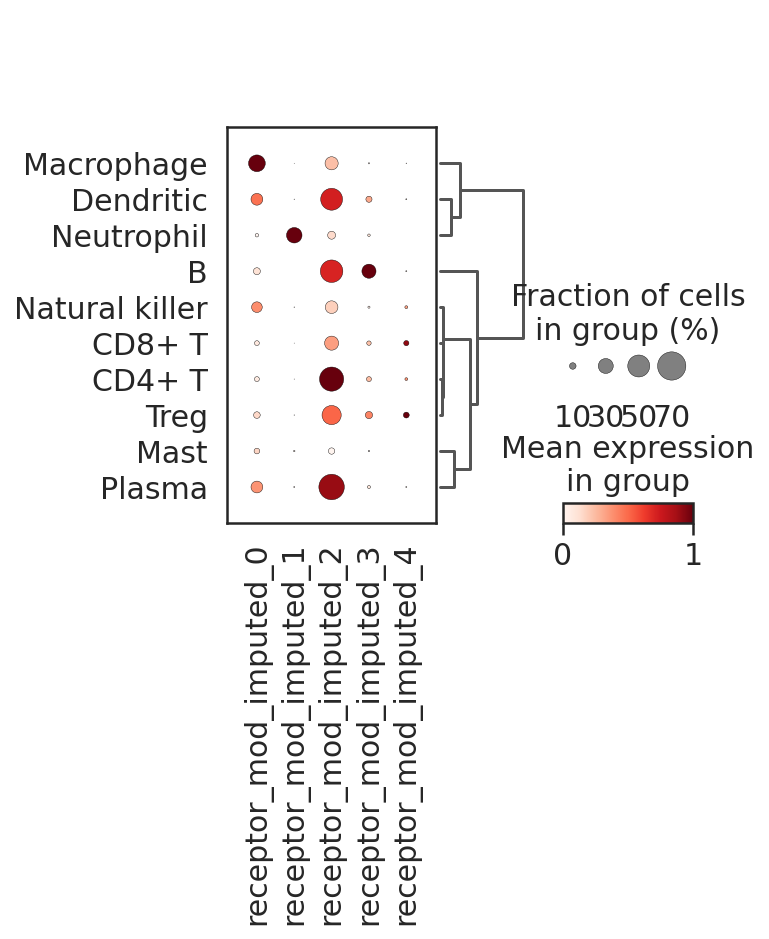

In [836]:
#dotplot
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')

sc.tl.dendrogram(adata_subset, groupby='Level 2 Annotation')
sc.pl.dotplot(adata_subset, receptor_name_ls_imputed, groupby='Level 2 Annotation', dendrogram=True, standard_scale='var')

In [810]:
receptor_name_ls

['receptor_mod_0',
 'receptor_mod_1',
 'receptor_mod_2',
 'receptor_mod_3',
 'receptor_mod_4']

In [856]:
pheno_heat = 'Level 2 Annotation'

plot_df = adata_subset.obs[receptor_name_ls+[pheno_heat]].groupby('Level 2 Annotation').mean()
plot_df

,receptor_mod_0,receptor_mod_1,receptor_mod_2,receptor_mod_3,receptor_mod_4
Level 2 Annotation,,,,,
B,-0.195684,-0.014567,0.391414,1.162176,0.019445
CD4+ T,-0.219363,0.050061,0.600341,0.267106,0.200264
CD8+ T,-0.190299,0.019877,0.179264,0.231285,0.484801
Dendritic,-0.074079,0.073817,0.452005,0.316890,0.012972
Macrophage,0.124796,0.035996,0.121135,-0.029723,-0.010836
Mast,-0.064713,0.285362,-0.018979,-0.033710,-0.027590
Natural killer,-0.135948,0.102280,0.177690,0.018311,0.135064
Neutrophil,-0.156043,13.824487,0.054227,0.067595,-0.027590
Plasma,-0.133262,0.111650,0.495076,0.065789,0.015592


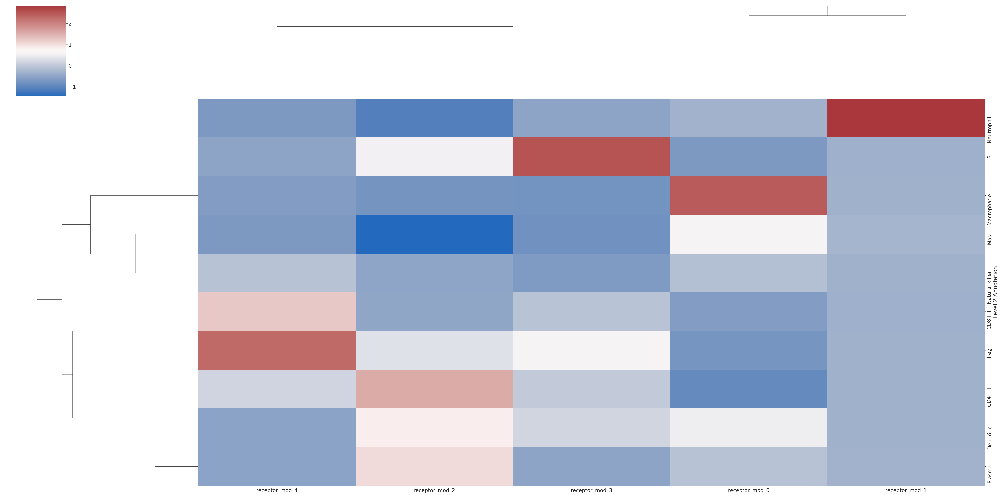

In [857]:
#SEACElls non imputed
import scipy
%matplotlib inline
sns.set(font_scale=2)
clustergrid = sns.clustermap(plot_df, cmap='vlag', col_cluster=True,row_cluster=True, figsize=(60,30), 
                             #row_linkage=plot_df_corr[1],col_linkage=plot_df_corr[2],
                             #vmin=-.5,vmax=.5,center=0,

                             z_score=1) 

[-0.044986717,
 -0.044986717,
 5.7762117,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 1.3763452,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 1.7059431,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 1.8211153,
 -0.044986717,
 -0.044986717,
 1.6895392,
 1.7040406,
 -0.044986717,
 -0.044986717,
 1.13917,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0.044986717,
 -0

## non malignant epi

In [196]:
set(adata.obs['Level 1 Annotation'])

{'Adipocyte',
 'Cancer-associated fibroblast',
 'Endocrine',
 'Endothelial',
 'Epithelial (malignant)',
 'Epithelial (non-malignant)',
 'Intra-pancreatic neurons',
 'Lymphoid',
 'Myeloid',
 'Pericyte',
 'Schwann',
 'Vascular smooth muscle'}

In [197]:
celltype = 'Epithelial (non-malignant)'

In [198]:
adata_crc = adata[adata.obs['Level 1 Annotation']==celltype]


In [199]:
adata_crc

View of AnnData object with n_obs × n_vars = 29388 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF'

In [200]:
adata_subset = adata[adata.obs['Level 1 Annotation']==celltype]
adata_subset = adata_subset[adata_subset.obs['pretreated']=='True']
plot_df_corr = pd.DataFrame(adata_subset[:,all_chemokines].layers['imputed'],index=adata_subset.obs_names,
                                              columns=all_chemokines)
#plot_df_corr =scipy.stats.zscore(plot_df_corr)
plot_df_corr =  corr_cov_matrix_cluster(plot_df_corr,markers=['all_markers'], metric='spearman',
                                        clustering_method = 'average', linkage_distance=1.65)
plot_df_corr

output list order: dataframe, hierarchical flat clusters, row linkage, column linkage


[           CCL11     CCL13     CCL14     CCL15     CCL16     CCL17     CCL18  \
 CCL11   1.000000  0.075787  0.000731 -0.003848  0.007390  0.036741 -0.001482   
 CCL13   0.075787  1.000000  0.000695 -0.000335 -0.001159 -0.002108  0.001492   
 CCL14   0.000731  0.000695  1.000000  0.008400  0.157189 -0.007485  0.048826   
 CCL15  -0.003848 -0.000335  0.008400  1.000000 -0.007455  0.072402  0.020563   
 CCL16   0.007390 -0.001159  0.157189 -0.007455  1.000000 -0.038372 -0.016695   
 CCL17   0.036741 -0.002108 -0.007485  0.072402 -0.038372  1.000000 -0.026030   
 CCL18  -0.001482  0.001492  0.048826  0.020563 -0.016695 -0.026030  1.000000   
 CCL19   0.016529  0.000891  0.021844  0.011185  0.030267 -0.021551  0.043868   
 CCL2   -0.035774 -0.001563  0.055220  0.011726 -0.019564 -0.071400  0.238103   
 CCL20  -0.004736  0.008165  0.046034  0.069835  0.092299  0.037009  0.156169   
 CCL21   0.000442 -0.000590  0.064025  0.167631  0.089850  0.035737  0.021663   
 CCL22  -0.009627 -0.000871 

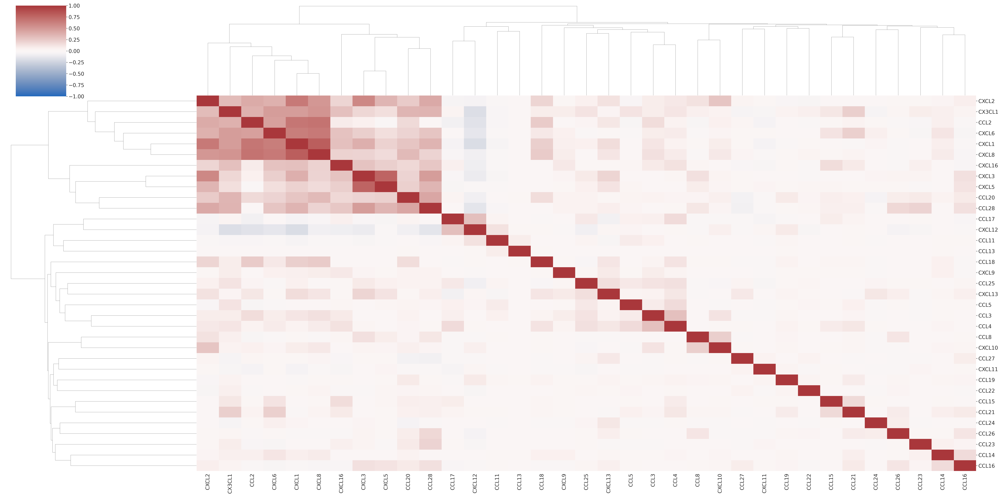

In [201]:
#SEACElls non imputed
import scipy
%matplotlib inline
sns.set(font_scale=2)
clustergrid = sns.clustermap(plot_df_corr[0], cmap='vlag', col_cluster=True,row_cluster=True, figsize=(60,30), 
                             #row_linkage=plot_df_corr[1],col_linkage=plot_df_corr[2],
                             vmin=-1,vmax=1,center=0,
               z_score=None) 

In [202]:
#SEACElls non imputed
row_colors = [color_map_clusters_nogrey[x] for x in plot_df_corr[1]]
col_colors = [color_map_clusters_nogrey[x] for x in plot_df_corr[1]]
sns.set(font_scale=2)
clustergrid = sns.clustermap(plot_df_corr[0], cmap='vlag',# col_cluster=True,row_cluster=True, 
                             figsize=(60,60), 
                             row_linkage=plot_df_corr[2],col_linkage=plot_df_corr[2],
                             row_colors = row_colors, col_colors=col_colors,
                             vmin=-.8,vmax=.8,center=0,
               z_score=None) 

In [203]:
cluster_labels =plot_df_corr[1]
variable_names =plot_df_corr[0].index
# Get the indices of samples in each cluster
clusters = np.unique(cluster_labels)
cluster_indices = [np.where(cluster_labels == c)[0] for c in clusters]

# Get the variable names for each cluster
cluster_variable_names = [[variable_names[i] for i in ci] for ci in cluster_indices]

print(cluster_variable_names)

[['CCL2', 'CCL20', 'CCL28', 'CX3CL1', 'CXCL1', 'CXCL16', 'CXCL2', 'CXCL3', 'CXCL5', 'CXCL6', 'CXCL8'], ['CCL11', 'CCL13', 'CCL14', 'CCL15', 'CCL16', 'CCL17', 'CCL18', 'CCL19', 'CCL21', 'CCL22', 'CCL23', 'CCL24', 'CCL25', 'CCL26', 'CCL27', 'CCL3', 'CCL4', 'CCL5', 'CCL8', 'CXCL10', 'CXCL11', 'CXCL12', 'CXCL13', 'CXCL9']]


In [204]:
#delete last cluster
cluster_variable_names_crc = cluster_variable_names
cluster_variable_names_crc

[['CCL2',
  'CCL20',
  'CCL28',
  'CX3CL1',
  'CXCL1',
  'CXCL16',
  'CXCL2',
  'CXCL3',
  'CXCL5',
  'CXCL6',
  'CXCL8'],
 ['CCL11',
  'CCL13',
  'CCL14',
  'CCL15',
  'CCL16',
  'CCL17',
  'CCL18',
  'CCL19',
  'CCL21',
  'CCL22',
  'CCL23',
  'CCL24',
  'CCL25',
  'CCL26',
  'CCL27',
  'CCL3',
  'CCL4',
  'CCL5',
  'CCL8',
  'CXCL10',
  'CXCL11',
  'CXCL12',
  'CXCL13',
  'CXCL9']]

In [205]:
adata.layers['zscored'] = scipy.stats.zscore(np.array(adata.X.todense()),axis=0)


In [206]:
for i,v in enumerate(cluster_variable_names_crc):
    adata.obs['score_crc_'+str(i)] =  list(np.mean(adata[:,v].layers['zscored'],axis=1))
    adata.obs['score_crc_nonzscored_'+str(i)] =   list(np.mean(np.array(adata[:,v].X.todense()),axis=1))

In [207]:
adata_crc

View of AnnData object with n_obs × n_vars = 29388 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF'

In [208]:
score_list = ['score_crc_0','score_crc_1','score_crc_2','score_crc_3','score_crc_4']
crc_mean_df, crc_frac_df = aggregate_scores(adata_crc,score_list,'pid',
                            zero_cutoff =None,aggregate_function='mean')

In [209]:
score_list = ['score_crc_nonzscored_0','score_crc_nonzscored_1','score_crc_nonzscored_2','score_crc_nonzscored_3','score_crc_nonzscored_4']
crc_mean_df_non_zscored, crc_frac_df_non_zscored = aggregate_scores(adata_crc,score_list,'pid',
                            zero_cutoff =None,aggregate_function='mean')

In [210]:
np.mean(crc_mean_df_non_zscored)

/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3438: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


score_crc_nonzscored_0    0.065269
score_crc_nonzscored_1    0.002154
score_crc_nonzscored_2    0.000136
score_crc_nonzscored_3    0.000580
score_crc_nonzscored_4    0.037332
dtype: float64

In [211]:
crc_mean_df['pretreated'] = crc_mean_df.index.map(metadata_df['pretreated'].to_dict())
crc_mean_df['pretreated']= crc_mean_df['pretreated'].astype(str)
crc_mean_df

,score_crc_0,score_crc_1,score_crc_2,score_crc_3,score_crc_4,pretreated
T7,0.114748,-0.025170,-0.030567,-0.010906,0.060051,True
U7,0.292397,-0.020298,-0.031076,-0.026969,0.180980,False
T17,0.018652,-0.039851,-0.031076,-0.026969,-0.082288,True
T21,-0.082606,-0.004759,-0.031076,-0.026969,-0.006040,True
T11,0.091922,-0.039215,-0.027259,-0.026969,0.072292,True
T3,0.020850,-0.029156,-0.031076,-0.026969,0.040284,True
T2,-0.022795,-0.017600,-0.031076,-0.014099,-0.014316,True
U1,0.039854,-0.033798,-0.031076,-0.025617,0.045325,False
U17,0.034259,0.010964,-0.023507,-0.014511,0.024135,False
T5,-0.121777,-0.039851,-0.031076,-0.026969,-0.082288,True


In [212]:
def get_proportions(adata, sample_obs, celltype_obs):
    '''
    get cell type proportions from an adata
    adata: adata element containing cell type labels
    sample_obs: key in adata.obs containing sample ids
    patient_obs: key in adata.obs containing patient ids
    comparison_obs: key in adata.obs for additional variable to add to the dataframe
    '''
    try:
        cell_type_df = adata.obs[[sample_obs, celltype_obs]]
    except:
        raise ValueError('obs keys not contained in adata')
    
    #calculate celltype prop. per sample
    proportions_df = pd.DataFrame()
    for i in set(cell_type_df[sample_obs]):
        cell_type_df_sub = cell_type_df[cell_type_df[sample_obs]==i]
        proportions_df[i] = cell_type_df_sub.value_counts(celltype_obs,normalize=True)
    return proportions_df


In [213]:
cell_type_proportions = get_proportions(adata,'pid','Level 2 Annotation').T
cell_type_proportions

Level 2 Annotation,Ductal,CAF,Macrophage,Alpha,Beta,Ductal (atypical),Vascular,Pericyte,Dendritic,CD8+ T,...,Acinar,CD4+ T,Intra-pancreatic neurons,Gamma,Plasma,ADM,Neutrophil,Epsilon,Adipocyte,Vascular smooth muscle
T7,0.398654,0.239280,0.063515,0.057222,0.055905,0.047856,0.045368,0.018440,0.015513,0.013757,...,0.000439,0.000293,0.000146,0.000146,0.000146,0.000146,0.000000,0.000000,0.000000,0.000000
U7,0.000651,0.153212,0.071832,0.006727,0.008464,0.003038,0.054036,0.028646,0.008030,0.067925,...,0.000000,0.032986,0.000000,0.000217,0.027561,0.000000,0.000000,0.000000,0.000000,0.000000
T17,0.000815,0.203749,0.429503,0.000000,0.000000,0.000000,0.076610,0.022820,0.004890,0.065200,...,0.001630,0.018745,0.000000,0.000815,0.000000,0.000000,0.005705,0.000000,0.000000,0.000000
T21,0.011309,0.007539,0.019925,0.068928,0.000000,0.000000,0.049004,0.010232,0.000539,0.004308,...,0.002154,0.000539,0.000000,0.004308,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
T11,0.088397,0.239873,0.018143,0.009705,0.005907,0.014346,0.208439,0.367511,0.001266,0.004008,...,0.000211,0.000211,0.000000,0.000211,0.000000,0.000000,0.000000,0.000000,0.002110,0.000844
T3,0.049073,0.026354,0.000364,0.000000,0.000364,0.013631,0.017448,0.003090,0.000000,0.000000,...,0.000182,0.000000,0.000000,0.003090,0.000000,0.000000,0.000000,0.000000,0.000000,0.000182
T2,0.429568,0.157721,0.063747,0.031777,0.049990,0.063941,0.047278,0.013370,0.005813,0.008525,...,0.069948,0.000388,0.000000,0.006007,0.000775,0.027902,0.000000,0.000000,0.000000,0.000000
U1,0.136942,0.382149,0.050105,0.031255,0.022555,0.086193,0.081038,0.036088,0.014661,0.021589,...,0.003061,0.017883,0.000000,0.000161,0.000644,0.000161,0.000644,0.000000,0.000000,0.000000
U17,0.257987,0.101637,0.001198,0.004593,0.016573,0.002796,0.039936,0.013379,0.000399,0.000200,...,0.299121,0.000000,0.000000,0.001198,0.000000,0.150559,0.000000,0.000000,0.000200,0.000000
T5,0.000328,0.471070,0.032290,0.044255,0.072283,0.000000,0.049008,0.017374,0.001967,0.000164,...,0.000000,0.000000,0.000000,0.001803,0.000000,0.000000,0.000000,0.000000,0.000000,0.000328


In [214]:
merged_df = pd.merge(crc_mean_df, cell_type_proportions, left_index=True, right_index=True)
merged_df = merged_df[merged_df['pretreated']=='True']
merged_df

,score_crc_0,score_crc_1,score_crc_2,score_crc_3,score_crc_4,pretreated,Ductal,CAF,Macrophage,Alpha,...,Acinar,CD4+ T,Intra-pancreatic neurons,Gamma,Plasma,ADM,Neutrophil,Epsilon,Adipocyte,Vascular smooth muscle
T7,0.114748,-0.025170,-0.030567,-0.010906,0.060051,True,0.398654,0.239280,0.063515,0.057222,...,0.000439,0.000293,0.000146,0.000146,0.000146,0.000146,0.000000,0.000000,0.000000,0.000000
T17,0.018652,-0.039851,-0.031076,-0.026969,-0.082288,True,0.000815,0.203749,0.429503,0.000000,...,0.001630,0.018745,0.000000,0.000815,0.000000,0.000000,0.005705,0.000000,0.000000,0.000000
T21,-0.082606,-0.004759,-0.031076,-0.026969,-0.006040,True,0.011309,0.007539,0.019925,0.068928,...,0.002154,0.000539,0.000000,0.004308,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
T11,0.091922,-0.039215,-0.027259,-0.026969,0.072292,True,0.088397,0.239873,0.018143,0.009705,...,0.000211,0.000211,0.000000,0.000211,0.000000,0.000000,0.000000,0.000000,0.002110,0.000844
T3,0.020850,-0.029156,-0.031076,-0.026969,0.040284,True,0.049073,0.026354,0.000364,0.000000,...,0.000182,0.000000,0.000000,0.003090,0.000000,0.000000,0.000000,0.000000,0.000000,0.000182
T2,-0.022795,-0.017600,-0.031076,-0.014099,-0.014316,True,0.429568,0.157721,0.063747,0.031777,...,0.069948,0.000388,0.000000,0.006007,0.000775,0.027902,0.000000,0.000000,0.000000,0.000000
T5,-0.121777,-0.039851,-0.031076,-0.026969,-0.082288,True,0.000328,0.471070,0.032290,0.044255,...,0.000000,0.000000,0.000000,0.001803,0.000000,0.000000,0.000000,0.000000,0.000000,0.000328
T16,-0.121777,0.030902,-0.031076,-0.026969,-0.082288,True,0.000137,0.682448,0.107863,0.000000,...,0.000686,0.008783,0.000000,0.000000,0.001647,0.000000,0.001921,0.000000,0.016879,0.005215
T20,0.074896,-0.030086,-0.023643,-0.015357,0.004203,True,0.049151,0.249116,0.020332,0.016973,...,0.002122,0.003006,0.000354,0.000177,0.001768,0.000000,0.000884,0.000000,0.000000,0.026521
T8,-0.121777,-0.039851,-0.031076,-0.026969,-0.082288,True,0.000000,0.147896,0.040842,0.000000,...,0.000000,0.123144,0.000000,0.000000,0.001856,0.000000,0.002475,0.000000,0.011757,0.003094


In [215]:
cell_type_proportions.columns

CategoricalIndex(['Ductal', 'CAF', 'Macrophage', 'Alpha', 'Beta',
                  'Ductal (atypical)', 'Vascular', 'Pericyte', 'Dendritic',
                  'CD8+ T', 'Malignant', 'myCAF', 'Delta', 'Schwann', 'Treg',
                  'B', 'Hormone-negative neuroendocrine', 'Lymphatic', 'Mast',
                  'Natural killer', 'Acinar', 'CD4+ T',
                  'Intra-pancreatic neurons', 'Gamma', 'Plasma', 'ADM',
                  'Neutrophil', 'Epsilon', 'Adipocyte',
                  'Vascular smooth muscle'],
                 categories=['ADM', 'Acinar', 'Adipocyte', 'Alpha', ..., 'Treg', 'Vascular', 'Vascular smooth muscle', 'myCAF'], ordered=False, dtype='category', name='Level 2 Annotation')

In [216]:
adata_crc

View of AnnData object with n_obs × n_vars = 29388 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF'

In [217]:
set(adata.obs['Level 3 Annotation'])

{'ADM',
 'Acinar',
 'Acinar (REG+)',
 'Adipocyte',
 'Alpha',
 'B',
 'Beta',
 'CAF',
 'CD4+ T',
 'CD8+ T',
 'CD8+ T (dysfunctional)',
 'CD8+ T (progenitor dysfunctional)',
 'CD8+ T (terminally dysfunctional)',
 'Delta',
 'Dendritic (activated)',
 'Dendritic (conventional type 1)',
 'Dendritic (conventional type 2)',
 'Dendritic (plasmacytoid)',
 'Ductal',
 'Ductal (atypical)',
 'Epsilon',
 'Gamma',
 'Hormone-negative neuroendocrine',
 'Intra-pancreatic neurons',
 'Lymphatic',
 'Macrophage',
 'Malignant',
 'Mast',
 'Natural killer',
 'Neutrophil',
 'Pericyte',
 'Plasma',
 'Schwann',
 'Treg',
 'Treg (activated)',
 'Treg (quiescent)',
 'Vascular',
 'Vascular smooth muscle',
 'myCAF'}

In [218]:
celltypes_oi = [ 'Macrophage','CD8+ T', 'Natural killer','Treg','Dendritic','CD4+ T', 'B', 'Plasma','Mast','Neutrophil', ]
programs_oi = ['score_crc_0','score_crc_1']

In [219]:
corr_df = pd.DataFrame()
p_df = pd.DataFrame()

for i in programs_oi:
    for j in celltypes_oi:
        corr, pval = scipy.stats.spearmanr(merged_df[i], merged_df[j])
        corr_df.loc[i,j] = corr
        p_df.loc[i,j] = pval

In [220]:
cluster_variable_names_crc

[['CCL2',
  'CCL20',
  'CCL28',
  'CX3CL1',
  'CXCL1',
  'CXCL16',
  'CXCL2',
  'CXCL3',
  'CXCL5',
  'CXCL6',
  'CXCL8'],
 ['CCL11',
  'CCL13',
  'CCL14',
  'CCL15',
  'CCL16',
  'CCL17',
  'CCL18',
  'CCL19',
  'CCL21',
  'CCL22',
  'CCL23',
  'CCL24',
  'CCL25',
  'CCL26',
  'CCL27',
  'CCL3',
  'CCL4',
  'CCL5',
  'CCL8',
  'CXCL10',
  'CXCL11',
  'CXCL12',
  'CXCL13',
  'CXCL9']]

In [221]:
corr_df

,Macrophage,CD8+ T,Natural killer,Treg,Dendritic,CD4+ T,B,Plasma,Mast,Neutrophil
score_crc_0,0.114458,0.242470,0.198795,0.256236,0.313253,0.096153,0.259068,-0.175824,0.263130,0.105506
score_crc_1,0.065153,-0.028789,0.028789,-0.021293,0.009091,-0.006142,0.126800,0.257514,0.222932,-0.028196


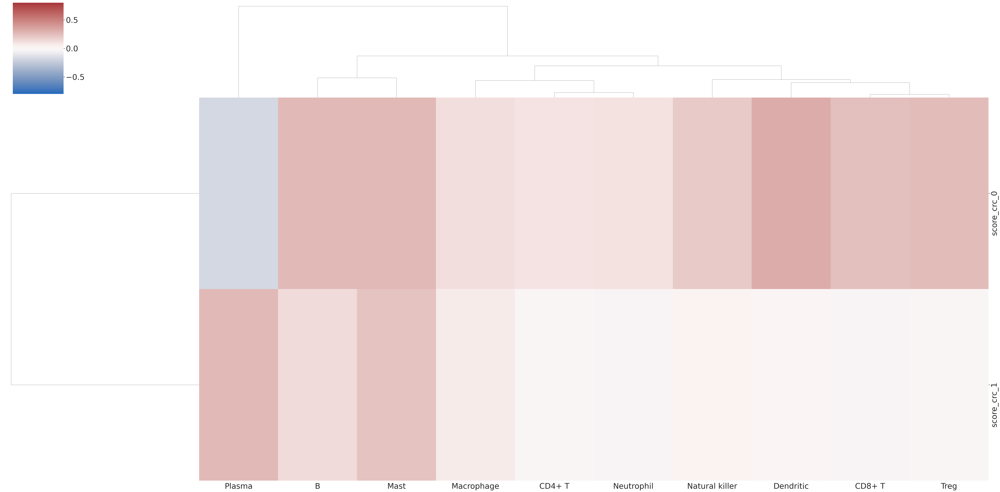

In [222]:
sns.set(font_scale=3)
clustergrid = sns.clustermap(corr_df, cmap='vlag', col_cluster=True,row_cluster=True, figsize=(60,30), vmin=-.8,center=0,vmax=.8,
               z_score=None) 

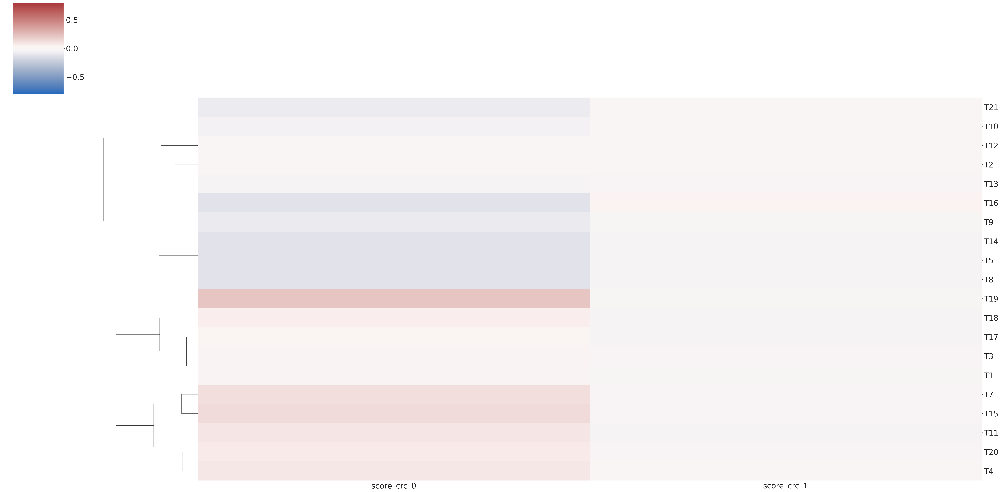

In [223]:
sns.set(font_scale=3)
plot_patients = crc_mean_df[crc_mean_df['pretreated']=='True'].drop(columns=['pretreated'])
clustergrid = sns.clustermap(plot_patients[programs_oi], cmap='vlag', col_cluster=True,row_cluster=True, figsize=(60,30), vmin=-.8,center=0,
                             vmax=.8,
               z_score=None) 

## CAF

In [196]:
set(adata.obs['Level 1 Annotation'])

{'Adipocyte',
 'Cancer-associated fibroblast',
 'Endocrine',
 'Endothelial',
 'Epithelial (malignant)',
 'Epithelial (non-malignant)',
 'Intra-pancreatic neurons',
 'Lymphoid',
 'Myeloid',
 'Pericyte',
 'Schwann',
 'Vascular smooth muscle'}

In [224]:
celltype = 'Cancer-associated fibroblast'

In [225]:
adata_crc = adata[adata.obs['Level 1 Annotation']==celltype]


In [226]:
adata_crc

View of AnnData object with n_obs × n_vars = 50955 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF'

In [227]:
adata_subset = adata[adata.obs['Level 1 Annotation']==celltype]
adata_subset = adata_subset[adata_subset.obs['pretreated']=='True']
plot_df_corr = pd.DataFrame(adata_subset[:,all_chemokines].layers['imputed'],index=adata_subset.obs_names,
                                              columns=all_chemokines)
#plot_df_corr =scipy.stats.zscore(plot_df_corr)
plot_df_corr =  corr_cov_matrix_cluster(plot_df_corr,markers=['all_markers'], metric='spearman',
                                        clustering_method = 'average', linkage_distance=1.65)
plot_df_corr

output list order: dataframe, hierarchical flat clusters, row linkage, column linkage


[           CCL11     CCL13     CCL14     CCL16     CCL17     CCL18     CCL19  \
 CCL11   1.000000 -0.019931  0.025307 -0.014656 -0.043480 -0.019113 -0.050801   
 CCL13  -0.019931  1.000000 -0.001430  0.011218  0.013578  0.019631  0.085562   
 CCL14   0.025307 -0.001430  1.000000  0.019048  0.001530 -0.002191  0.001574   
 CCL16  -0.014656  0.011218  0.019048  1.000000 -0.006574 -0.041472  0.114620   
 CCL17  -0.043480  0.013578  0.001530 -0.006574  1.000000 -0.005235  0.046050   
 CCL18  -0.019113  0.019631 -0.002191 -0.041472 -0.005235  1.000000 -0.067214   
 CCL19  -0.050801  0.085562  0.001574  0.114620  0.046050 -0.067214  1.000000   
 CCL2   -0.005043  0.108014  0.003014  0.055208 -0.036261 -0.022466  0.511372   
 CCL20  -0.050562 -0.042745 -0.003803  0.027806  0.086545 -0.032157 -0.116259   
 CCL21  -0.047003  0.120951  0.000456  0.139729  0.054417 -0.058604  0.911074   
 CCL22  -0.002266 -0.013936 -0.000518 -0.018456 -0.013409  0.038260 -0.032671   
 CCL23   0.005325 -0.019589 

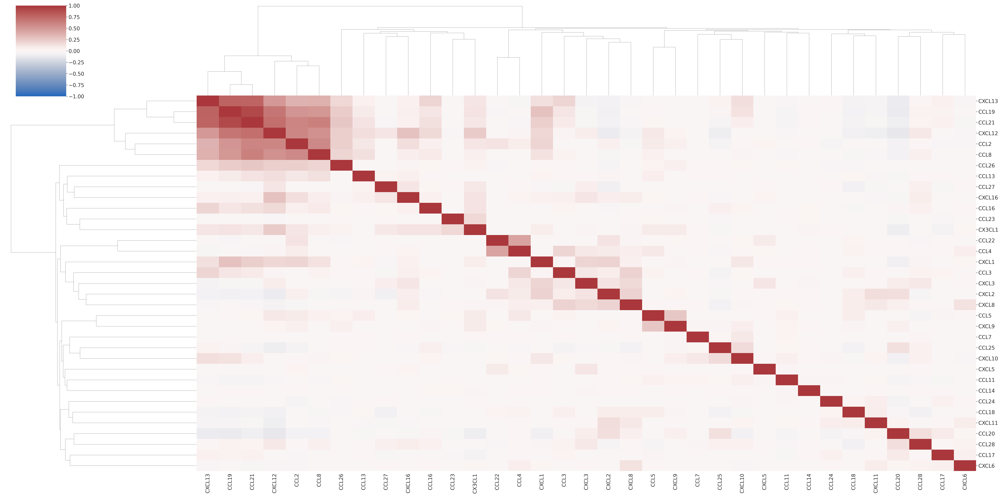

In [228]:
#SEACElls non imputed
import scipy
%matplotlib inline
sns.set(font_scale=2)
clustergrid = sns.clustermap(plot_df_corr[0], cmap='vlag', col_cluster=True,row_cluster=True, figsize=(60,30), 
                             #row_linkage=plot_df_corr[1],col_linkage=plot_df_corr[2],
                             vmin=-1,vmax=1,center=0,
               z_score=None) 

In [229]:
#SEACElls non imputed
row_colors = [color_map_clusters_nogrey[x] for x in plot_df_corr[1]]
col_colors = [color_map_clusters_nogrey[x] for x in plot_df_corr[1]]
sns.set(font_scale=2)
clustergrid = sns.clustermap(plot_df_corr[0], cmap='vlag',# col_cluster=True,row_cluster=True, 
                             figsize=(60,60), 
                             row_linkage=plot_df_corr[2],col_linkage=plot_df_corr[2],
                             row_colors = row_colors, col_colors=col_colors,
                             vmin=-.8,vmax=.8,center=0,
               z_score=None) 

In [230]:
cluster_labels =plot_df_corr[1]
variable_names =plot_df_corr[0].index
# Get the indices of samples in each cluster
clusters = np.unique(cluster_labels)
cluster_indices = [np.where(cluster_labels == c)[0] for c in clusters]

# Get the variable names for each cluster
cluster_variable_names = [[variable_names[i] for i in ci] for ci in cluster_indices]

print(cluster_variable_names)

[['CCL19', 'CCL2', 'CCL21', 'CCL8', 'CXCL12', 'CXCL13'], ['CCL11', 'CCL13', 'CCL14', 'CCL16', 'CCL17', 'CCL18', 'CCL20', 'CCL22', 'CCL23', 'CCL24', 'CCL25', 'CCL26', 'CCL27', 'CCL28', 'CCL3', 'CCL4', 'CCL5', 'CCL7', 'CX3CL1', 'CXCL1', 'CXCL10', 'CXCL11', 'CXCL16', 'CXCL2', 'CXCL3', 'CXCL5', 'CXCL6', 'CXCL8', 'CXCL9']]


In [231]:
#delete last cluster
cluster_variable_names_crc = cluster_variable_names
cluster_variable_names_crc

[['CCL19', 'CCL2', 'CCL21', 'CCL8', 'CXCL12', 'CXCL13'],
 ['CCL11',
  'CCL13',
  'CCL14',
  'CCL16',
  'CCL17',
  'CCL18',
  'CCL20',
  'CCL22',
  'CCL23',
  'CCL24',
  'CCL25',
  'CCL26',
  'CCL27',
  'CCL28',
  'CCL3',
  'CCL4',
  'CCL5',
  'CCL7',
  'CX3CL1',
  'CXCL1',
  'CXCL10',
  'CXCL11',
  'CXCL16',
  'CXCL2',
  'CXCL3',
  'CXCL5',
  'CXCL6',
  'CXCL8',
  'CXCL9']]

In [232]:
adata.layers['zscored'] = scipy.stats.zscore(np.array(adata.X.todense()),axis=0)


In [233]:
for i,v in enumerate(cluster_variable_names_crc):
    adata.obs['score_crc_'+str(i)] =  list(np.mean(adata[:,v].layers['zscored'],axis=1))
    adata.obs['score_crc_nonzscored_'+str(i)] =   list(np.mean(np.array(adata[:,v].X.todense()),axis=1))

In [234]:
adata_crc

View of AnnData object with n_obs × n_vars = 50955 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF'

In [235]:
score_list = ['score_crc_0','score_crc_1','score_crc_2','score_crc_3','score_crc_4']
crc_mean_df, crc_frac_df = aggregate_scores(adata_crc,score_list,'pid',
                            zero_cutoff =None,aggregate_function='mean')

In [236]:
score_list = ['score_crc_nonzscored_0','score_crc_nonzscored_1','score_crc_nonzscored_2','score_crc_nonzscored_3','score_crc_nonzscored_4']
crc_mean_df_non_zscored, crc_frac_df_non_zscored = aggregate_scores(adata_crc,score_list,'pid',
                            zero_cutoff =None,aggregate_function='mean')

In [237]:
np.mean(crc_mean_df_non_zscored)

/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3438: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


score_crc_nonzscored_0    0.021054
score_crc_nonzscored_1    0.002845
score_crc_nonzscored_2    0.000691
score_crc_nonzscored_3    0.002251
score_crc_nonzscored_4    0.004376
dtype: float64

In [238]:
crc_mean_df['pretreated'] = crc_mean_df.index.map(metadata_df['pretreated'].to_dict())
crc_mean_df['pretreated']= crc_mean_df['pretreated'].astype(str)
crc_mean_df

,score_crc_0,score_crc_1,score_crc_2,score_crc_3,score_crc_4,pretreated
T7,0.015608,-0.052248,-0.031076,-0.010653,-0.063004,True
U7,0.016068,-0.040162,-0.022260,-0.008887,-0.073151,False
T17,0.052882,-0.045213,-0.031076,-0.015979,-0.068352,True
T21,0.366424,0.386916,-0.031076,1.261997,0.186875,True
T11,0.025064,-0.061249,-0.031076,-0.021516,-0.073133,True
T3,-0.070666,-0.048316,-0.031076,-0.026969,-0.046109,True
T2,0.271569,-0.054113,-0.031076,-0.017330,-0.055521,True
U1,-0.011608,-0.058394,-0.031076,-0.016742,-0.076189,False
U17,0.270141,-0.007847,0.022761,-0.023885,0.020536,False
T5,-0.026118,-0.054017,0.006747,-0.021737,-0.075288,True


In [239]:
def get_proportions(adata, sample_obs, celltype_obs):
    '''
    get cell type proportions from an adata
    adata: adata element containing cell type labels
    sample_obs: key in adata.obs containing sample ids
    patient_obs: key in adata.obs containing patient ids
    comparison_obs: key in adata.obs for additional variable to add to the dataframe
    '''
    try:
        cell_type_df = adata.obs[[sample_obs, celltype_obs]]
    except:
        raise ValueError('obs keys not contained in adata')
    
    #calculate celltype prop. per sample
    proportions_df = pd.DataFrame()
    for i in set(cell_type_df[sample_obs]):
        cell_type_df_sub = cell_type_df[cell_type_df[sample_obs]==i]
        proportions_df[i] = cell_type_df_sub.value_counts(celltype_obs,normalize=True)
    return proportions_df


In [240]:
cell_type_proportions = get_proportions(adata,'pid','Level 2 Annotation').T
cell_type_proportions

Level 2 Annotation,Ductal,CAF,Macrophage,Alpha,Beta,Ductal (atypical),Vascular,Pericyte,Dendritic,CD8+ T,...,Acinar,CD4+ T,Intra-pancreatic neurons,Gamma,Plasma,ADM,Neutrophil,Epsilon,Adipocyte,Vascular smooth muscle
T7,0.398654,0.239280,0.063515,0.057222,0.055905,0.047856,0.045368,0.018440,0.015513,0.013757,...,0.000439,0.000293,0.000146,0.000146,0.000146,0.000146,0.000000,0.000000,0.000000,0.000000
U7,0.000651,0.153212,0.071832,0.006727,0.008464,0.003038,0.054036,0.028646,0.008030,0.067925,...,0.000000,0.032986,0.000000,0.000217,0.027561,0.000000,0.000000,0.000000,0.000000,0.000000
T17,0.000815,0.203749,0.429503,0.000000,0.000000,0.000000,0.076610,0.022820,0.004890,0.065200,...,0.001630,0.018745,0.000000,0.000815,0.000000,0.000000,0.005705,0.000000,0.000000,0.000000
T21,0.011309,0.007539,0.019925,0.068928,0.000000,0.000000,0.049004,0.010232,0.000539,0.004308,...,0.002154,0.000539,0.000000,0.004308,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
T11,0.088397,0.239873,0.018143,0.009705,0.005907,0.014346,0.208439,0.367511,0.001266,0.004008,...,0.000211,0.000211,0.000000,0.000211,0.000000,0.000000,0.000000,0.000000,0.002110,0.000844
T3,0.049073,0.026354,0.000364,0.000000,0.000364,0.013631,0.017448,0.003090,0.000000,0.000000,...,0.000182,0.000000,0.000000,0.003090,0.000000,0.000000,0.000000,0.000000,0.000000,0.000182
T2,0.429568,0.157721,0.063747,0.031777,0.049990,0.063941,0.047278,0.013370,0.005813,0.008525,...,0.069948,0.000388,0.000000,0.006007,0.000775,0.027902,0.000000,0.000000,0.000000,0.000000
U1,0.136942,0.382149,0.050105,0.031255,0.022555,0.086193,0.081038,0.036088,0.014661,0.021589,...,0.003061,0.017883,0.000000,0.000161,0.000644,0.000161,0.000644,0.000000,0.000000,0.000000
U17,0.257987,0.101637,0.001198,0.004593,0.016573,0.002796,0.039936,0.013379,0.000399,0.000200,...,0.299121,0.000000,0.000000,0.001198,0.000000,0.150559,0.000000,0.000000,0.000200,0.000000
T5,0.000328,0.471070,0.032290,0.044255,0.072283,0.000000,0.049008,0.017374,0.001967,0.000164,...,0.000000,0.000000,0.000000,0.001803,0.000000,0.000000,0.000000,0.000000,0.000000,0.000328


In [241]:
merged_df = pd.merge(crc_mean_df, cell_type_proportions, left_index=True, right_index=True)
merged_df = merged_df[merged_df['pretreated']=='True']
merged_df

,score_crc_0,score_crc_1,score_crc_2,score_crc_3,score_crc_4,pretreated,Ductal,CAF,Macrophage,Alpha,...,Acinar,CD4+ T,Intra-pancreatic neurons,Gamma,Plasma,ADM,Neutrophil,Epsilon,Adipocyte,Vascular smooth muscle
T7,0.015608,-0.052248,-0.031076,-0.010653,-0.063004,True,0.398654,0.239280,0.063515,0.057222,...,0.000439,0.000293,0.000146,0.000146,0.000146,0.000146,0.000000,0.000000,0.000000,0.000000
T17,0.052882,-0.045213,-0.031076,-0.015979,-0.068352,True,0.000815,0.203749,0.429503,0.000000,...,0.001630,0.018745,0.000000,0.000815,0.000000,0.000000,0.005705,0.000000,0.000000,0.000000
T21,0.366424,0.386916,-0.031076,1.261997,0.186875,True,0.011309,0.007539,0.019925,0.068928,...,0.002154,0.000539,0.000000,0.004308,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
T11,0.025064,-0.061249,-0.031076,-0.021516,-0.073133,True,0.088397,0.239873,0.018143,0.009705,...,0.000211,0.000211,0.000000,0.000211,0.000000,0.000000,0.000000,0.000000,0.002110,0.000844
T3,-0.070666,-0.048316,-0.031076,-0.026969,-0.046109,True,0.049073,0.026354,0.000364,0.000000,...,0.000182,0.000000,0.000000,0.003090,0.000000,0.000000,0.000000,0.000000,0.000000,0.000182
T2,0.271569,-0.054113,-0.031076,-0.017330,-0.055521,True,0.429568,0.157721,0.063747,0.031777,...,0.069948,0.000388,0.000000,0.006007,0.000775,0.027902,0.000000,0.000000,0.000000,0.000000
T5,-0.026118,-0.054017,0.006747,-0.021737,-0.075288,True,0.000328,0.471070,0.032290,0.044255,...,0.000000,0.000000,0.000000,0.001803,0.000000,0.000000,0.000000,0.000000,0.000000,0.000328
T16,-0.044697,-0.053066,-0.025224,-0.014243,-0.066224,True,0.000137,0.682448,0.107863,0.000000,...,0.000686,0.008783,0.000000,0.000000,0.001647,0.000000,0.001921,0.000000,0.016879,0.005215
T20,-0.043834,-0.059749,-0.018791,-0.025337,-0.070484,True,0.049151,0.249116,0.020332,0.016973,...,0.002122,0.003006,0.000354,0.000177,0.001768,0.000000,0.000884,0.000000,0.000000,0.026521
T8,0.222499,-0.028500,0.021764,-0.005203,-0.048746,True,0.000000,0.147896,0.040842,0.000000,...,0.000000,0.123144,0.000000,0.000000,0.001856,0.000000,0.002475,0.000000,0.011757,0.003094


In [242]:
cell_type_proportions.columns

CategoricalIndex(['Ductal', 'CAF', 'Macrophage', 'Alpha', 'Beta',
                  'Ductal (atypical)', 'Vascular', 'Pericyte', 'Dendritic',
                  'CD8+ T', 'Malignant', 'myCAF', 'Delta', 'Schwann', 'Treg',
                  'B', 'Hormone-negative neuroendocrine', 'Lymphatic', 'Mast',
                  'Natural killer', 'Acinar', 'CD4+ T',
                  'Intra-pancreatic neurons', 'Gamma', 'Plasma', 'ADM',
                  'Neutrophil', 'Epsilon', 'Adipocyte',
                  'Vascular smooth muscle'],
                 categories=['ADM', 'Acinar', 'Adipocyte', 'Alpha', ..., 'Treg', 'Vascular', 'Vascular smooth muscle', 'myCAF'], ordered=False, dtype='category', name='Level 2 Annotation')

In [243]:
adata_crc

View of AnnData object with n_obs × n_vars = 50955 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF'

In [244]:
set(adata.obs['Level 3 Annotation'])

{'ADM',
 'Acinar',
 'Acinar (REG+)',
 'Adipocyte',
 'Alpha',
 'B',
 'Beta',
 'CAF',
 'CD4+ T',
 'CD8+ T',
 'CD8+ T (dysfunctional)',
 'CD8+ T (progenitor dysfunctional)',
 'CD8+ T (terminally dysfunctional)',
 'Delta',
 'Dendritic (activated)',
 'Dendritic (conventional type 1)',
 'Dendritic (conventional type 2)',
 'Dendritic (plasmacytoid)',
 'Ductal',
 'Ductal (atypical)',
 'Epsilon',
 'Gamma',
 'Hormone-negative neuroendocrine',
 'Intra-pancreatic neurons',
 'Lymphatic',
 'Macrophage',
 'Malignant',
 'Mast',
 'Natural killer',
 'Neutrophil',
 'Pericyte',
 'Plasma',
 'Schwann',
 'Treg',
 'Treg (activated)',
 'Treg (quiescent)',
 'Vascular',
 'Vascular smooth muscle',
 'myCAF'}

In [245]:
celltypes_oi = [ 'Macrophage','CD8+ T', 'Natural killer','Treg','Dendritic','CD4+ T', 'B', 'Plasma','Mast','Neutrophil', ]
programs_oi = ['score_crc_0','score_crc_1']

In [246]:
corr_df = pd.DataFrame()
p_df = pd.DataFrame()

for i in programs_oi:
    for j in celltypes_oi:
        corr, pval = scipy.stats.spearmanr(merged_df[i], merged_df[j])
        corr_df.loc[i,j] = corr
        p_df.loc[i,j] = pval

In [247]:
cluster_variable_names_crc

[['CCL19', 'CCL2', 'CCL21', 'CCL8', 'CXCL12', 'CXCL13'],
 ['CCL11',
  'CCL13',
  'CCL14',
  'CCL16',
  'CCL17',
  'CCL18',
  'CCL20',
  'CCL22',
  'CCL23',
  'CCL24',
  'CCL25',
  'CCL26',
  'CCL27',
  'CCL28',
  'CCL3',
  'CCL4',
  'CCL5',
  'CCL7',
  'CX3CL1',
  'CXCL1',
  'CXCL10',
  'CXCL11',
  'CXCL16',
  'CXCL2',
  'CXCL3',
  'CXCL5',
  'CXCL6',
  'CXCL8',
  'CXCL9']]

In [248]:
corr_df

,Macrophage,CD8+ T,Natural killer,Treg,Dendritic,CD4+ T,B,Plasma,Mast,Neutrophil
score_crc_0,0.300000,0.203896,0.567532,0.388927,0.489610,0.530514,0.199678,0.072124,0.029106,0.202927
score_crc_1,0.083117,0.050649,0.219481,0.178503,0.154545,0.272534,0.052758,0.186322,-0.095254,0.069801


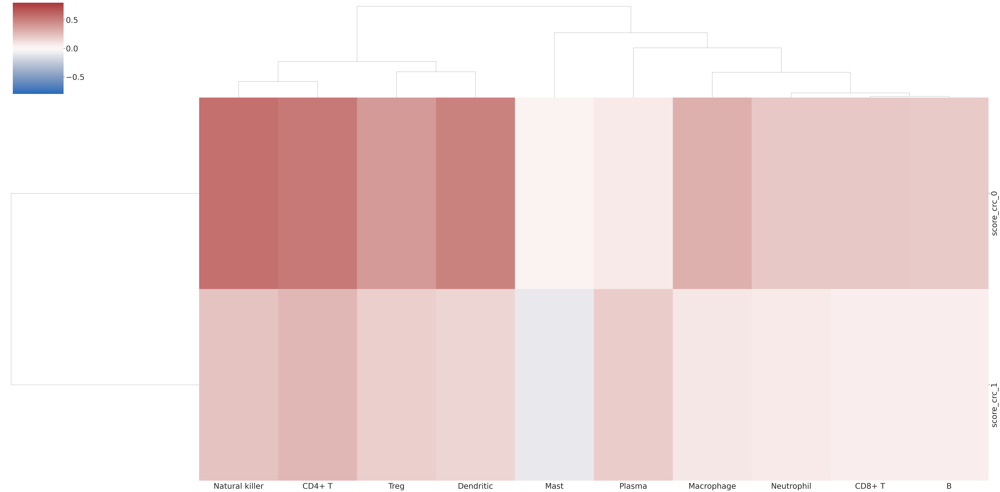

In [249]:
sns.set(font_scale=3)
clustergrid = sns.clustermap(corr_df, cmap='vlag', col_cluster=True,row_cluster=True, figsize=(60,30), vmin=-.8,center=0,vmax=.8,
               z_score=None) 

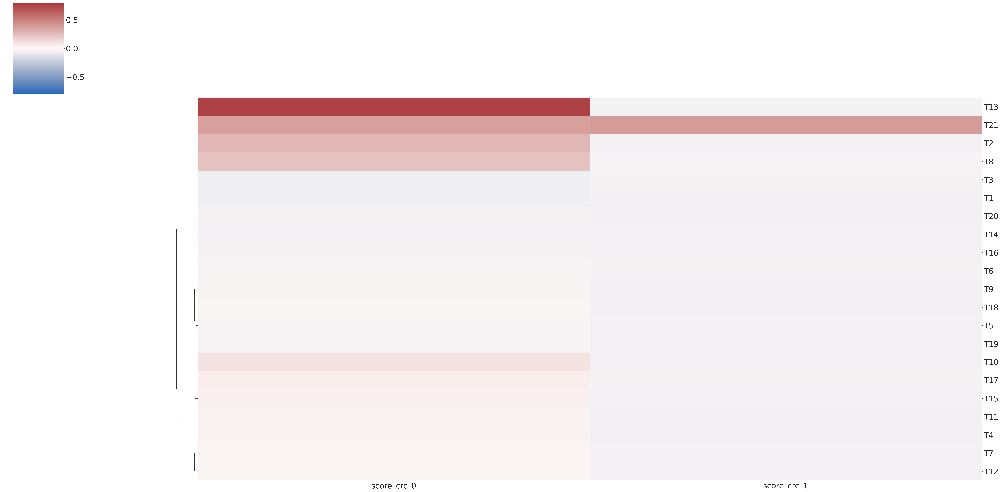

In [250]:
sns.set(font_scale=3)
plot_patients = crc_mean_df[crc_mean_df['pretreated']=='True'].drop(columns=['pretreated'])
clustergrid = sns.clustermap(plot_patients[programs_oi], cmap='vlag', col_cluster=True,row_cluster=True, figsize=(60,30), vmin=-.8,center=0,
                             vmax=.8,
               z_score=None) 

## Endothelial

In [280]:
set(adata.obs['Level 1 Annotation'])

{'Adipocyte',
 'Cancer-associated fibroblast',
 'Endocrine',
 'Endothelial',
 'Epithelial (malignant)',
 'Epithelial (non-malignant)',
 'Intra-pancreatic neurons',
 'Lymphoid',
 'Myeloid',
 'Pericyte',
 'Schwann',
 'Vascular smooth muscle'}

In [281]:
celltype = 'Endothelial'

In [282]:
adata_crc = adata[adata.obs['Level 1 Annotation']==celltype]


In [283]:
adata_crc

View of AnnData object with n_obs × n_vars = 16201 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF'

In [284]:
adata_subset = adata[adata.obs['Level 1 Annotation']==celltype]
adata_subset = adata_subset[adata_subset.obs['pretreated']=='True']
plot_df_corr = pd.DataFrame(adata_subset[:,all_chemokines].layers['imputed'],index=adata_subset.obs_names,
                                              columns=all_chemokines)
#plot_df_corr =scipy.stats.zscore(plot_df_corr)
plot_df_corr =  corr_cov_matrix_cluster(plot_df_corr,markers=['all_markers'], metric='spearman',
                                        clustering_method = 'average', linkage_distance=1.65)
plot_df_corr

output list order: dataframe, hierarchical flat clusters, row linkage, column linkage


[           CCL11     CCL13     CCL14     CCL15     CCL16     CCL17     CCL18  \
 CCL11   1.000000 -0.011226 -0.031334 -0.000965 -0.044507  0.008662  0.017009   
 CCL13  -0.011226  1.000000  0.041322 -0.001310  0.005843  0.042246  0.001401   
 CCL14  -0.031334  0.041322  1.000000 -0.004318  0.550343  0.000136  0.001440   
 CCL15  -0.000965 -0.001310 -0.004318  1.000000 -0.007255 -0.004340 -0.001476   
 CCL16  -0.044507  0.005843  0.550343 -0.007255  1.000000 -0.005242  0.014633   
 CCL17   0.008662  0.042246  0.000136 -0.004340 -0.005242  1.000000 -0.022078   
 CCL18   0.017009  0.001401  0.001440 -0.001476  0.014633 -0.022078  1.000000   
 CCL19   0.004718  0.001415 -0.012616 -0.003146 -0.053526 -0.014944 -0.011498   
 CCL2    0.007005  0.002098 -0.146727  0.002622 -0.239663 -0.019270 -0.030959   
 CCL20  -0.014037 -0.009641 -0.095839  0.003999 -0.116508  0.025365 -0.026676   
 CCL21  -0.008833 -0.010119 -0.073615  0.003530 -0.127877 -0.051860 -0.013821   
 CCL22  -0.011182 -0.002828 

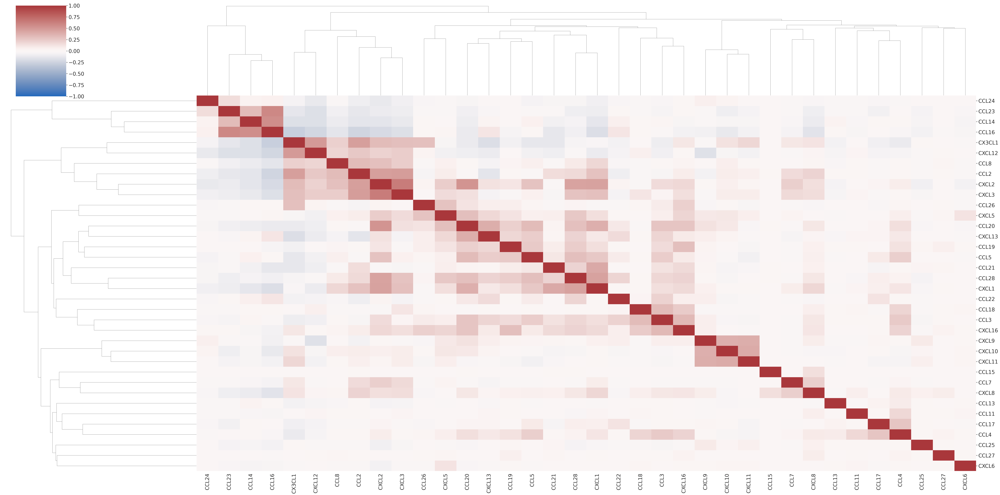

In [285]:
#SEACElls non imputed
import scipy
%matplotlib inline
sns.set(font_scale=2)
clustergrid = sns.clustermap(plot_df_corr[0], cmap='vlag', col_cluster=True,row_cluster=True, figsize=(60,30), 
                             #row_linkage=plot_df_corr[1],col_linkage=plot_df_corr[2],
                             vmin=-1,vmax=1,center=0,
               z_score=None) 

In [286]:
#SEACElls non imputed
row_colors = [color_map_clusters_nogrey[x] for x in plot_df_corr[1]]
col_colors = [color_map_clusters_nogrey[x] for x in plot_df_corr[1]]
sns.set(font_scale=2)
clustergrid = sns.clustermap(plot_df_corr[0], cmap='vlag',# col_cluster=True,row_cluster=True, 
                             figsize=(60,60), 
                             row_linkage=plot_df_corr[2],col_linkage=plot_df_corr[2],
                             row_colors = row_colors, col_colors=col_colors,
                             vmin=-.8,vmax=.8,center=0,
               z_score=None) 

In [287]:
cluster_labels =plot_df_corr[1]
variable_names =plot_df_corr[0].index
# Get the indices of samples in each cluster
clusters = np.unique(cluster_labels)
cluster_indices = [np.where(cluster_labels == c)[0] for c in clusters]

# Get the variable names for each cluster
cluster_variable_names = [[variable_names[i] for i in ci] for ci in cluster_indices]

print(cluster_variable_names)

[['CCL14', 'CCL16', 'CCL23', 'CCL24'], ['CCL2', 'CCL8', 'CX3CL1', 'CXCL12', 'CXCL2', 'CXCL3'], ['CCL11', 'CCL13', 'CCL15', 'CCL17', 'CCL18', 'CCL19', 'CCL20', 'CCL21', 'CCL22', 'CCL25', 'CCL26', 'CCL27', 'CCL28', 'CCL3', 'CCL4', 'CCL5', 'CCL7', 'CXCL1', 'CXCL10', 'CXCL11', 'CXCL13', 'CXCL16', 'CXCL5', 'CXCL6', 'CXCL8', 'CXCL9']]


In [288]:
#delete last cluster
cluster_variable_names_crc = cluster_variable_names
cluster_variable_names_crc

[['CCL14', 'CCL16', 'CCL23', 'CCL24'],
 ['CCL2', 'CCL8', 'CX3CL1', 'CXCL12', 'CXCL2', 'CXCL3'],
 ['CCL11',
  'CCL13',
  'CCL15',
  'CCL17',
  'CCL18',
  'CCL19',
  'CCL20',
  'CCL21',
  'CCL22',
  'CCL25',
  'CCL26',
  'CCL27',
  'CCL28',
  'CCL3',
  'CCL4',
  'CCL5',
  'CCL7',
  'CXCL1',
  'CXCL10',
  'CXCL11',
  'CXCL13',
  'CXCL16',
  'CXCL5',
  'CXCL6',
  'CXCL8',
  'CXCL9']]

-7.264464531975458

In [344]:
indices

[False,
 False,
 True,
 False,
 True,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 True,
 True,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False]

[{2, 4, 12, 13},
 {8, 22, 23, 27, 30, 31},
 {0,
  1,
  3,
  5,
  6,
  7,
  9,
  10,
  11,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  24,
  25,
  26,
  28,
  29,
  32,
  33,
  34,
  35}]

0.4350423940664544

In [289]:
adata.layers['zscored'] = scipy.stats.zscore(np.array(adata.X.todense()),axis=0)


In [290]:
for i,v in enumerate(cluster_variable_names_crc):
    adata.obs['score_crc_'+str(i)] =  list(np.mean(adata[:,v].layers['zscored'],axis=1))
    adata.obs['score_crc_nonzscored_'+str(i)] =   list(np.mean(np.array(adata[:,v].X.todense()),axis=1))

In [291]:
adata_crc

View of AnnData object with n_obs × n_vars = 16201 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF'

In [292]:
score_list = ['score_crc_0','score_crc_1','score_crc_2','score_crc_3','score_crc_4']
crc_mean_df, crc_frac_df = aggregate_scores(adata_crc,score_list,'pid',
                            zero_cutoff =None,aggregate_function='mean')

In [293]:
score_list = ['score_crc_nonzscored_0','score_crc_nonzscored_1','score_crc_nonzscored_2','score_crc_nonzscored_3','score_crc_nonzscored_4']
crc_mean_df_non_zscored, crc_frac_df_non_zscored = aggregate_scores(adata_crc,score_list,'pid',
                            zero_cutoff =None,aggregate_function='mean')

In [294]:
np.mean(crc_mean_df_non_zscored)

/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3438: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


score_crc_nonzscored_0    0.006227
score_crc_nonzscored_1    0.040344
score_crc_nonzscored_2    0.004317
score_crc_nonzscored_3    0.002051
score_crc_nonzscored_4    0.028920
dtype: float64

In [295]:
crc_mean_df['pretreated'] = crc_mean_df.index.map(metadata_df['pretreated'].to_dict())
crc_mean_df['pretreated']= crc_mean_df['pretreated'].astype(str)
crc_mean_df

,score_crc_0,score_crc_1,score_crc_2,score_crc_3,score_crc_4,pretreated
T7,0.195281,-0.044595,-0.026944,-0.096986,-0.017323,True
U7,-0.028718,-0.071825,-0.055346,-0.096986,-0.055877,False
T17,-0.028718,-0.083515,-0.053528,-0.096987,-0.098993,True
T21,-0.028718,0.262832,-0.027713,-0.096987,0.025793,True
T11,0.250517,-0.033259,-0.049213,-0.090135,-0.049270,True
T3,-0.028718,0.031862,-0.056630,-0.096987,-0.077132,True
T2,0.195942,0.101627,-0.028815,-0.084391,0.181009,True
U1,0.185842,0.018198,-0.039194,-0.096986,0.051753,False
U17,-0.028718,0.151196,-0.005842,-0.096986,-0.096562,False
T5,-0.028718,-0.048840,-0.042655,-0.078145,-0.098993,True


In [11]:
def get_proportions(adata, sample_obs, celltype_obs):
    '''
    get cell type proportions from an adata
    adata: adata element containing cell type labels
    sample_obs: key in adata.obs containing sample ids
    patient_obs: key in adata.obs containing patient ids
    comparison_obs: key in adata.obs for additional variable to add to the dataframe
    '''
    try:
        cell_type_df = adata.obs[[sample_obs, celltype_obs]]
    except:
        raise ValueError('obs keys not contained in adata')
    
    #calculate celltype prop. per sample
    proportions_df = pd.DataFrame()
    for i in set(cell_type_df[sample_obs]):
        cell_type_df_sub = cell_type_df[cell_type_df[sample_obs]==i]
        proportions_df[i] = cell_type_df_sub.value_counts(celltype_obs,normalize=True)
    return proportions_df


In [14]:
cell_type_proportions = get_proportions(adata,'pid','Level 1 Annotation').T
cell_type_proportions

Level 1 Annotation,Cancer-associated fibroblast,Pericyte,Endothelial,Epithelial (malignant),Myeloid,Adipocyte,Schwann,Lymphoid,Epithelial (non-malignant),Endocrine,Intra-pancreatic neurons,Vascular smooth muscle
T14,0.569201,0.208751,0.126919,0.041339,0.025142,0.019461,0.005198,0.002901,0.001088,0.000000,0.000000,0.000000
T15,0.341093,0.013602,0.053884,0.010201,0.067748,0.000000,0.012817,0.047345,0.369343,0.080565,0.000262,0.003139
T25,0.468675,0.017802,0.028757,0.152687,0.066758,0.000000,0.003766,0.012325,0.235878,0.007874,0.000000,0.005478
U3,0.150946,0.044377,0.055670,0.605694,0.006999,0.000000,0.003340,0.001272,0.121043,0.010657,0.000000,0.000000
U17,0.104034,0.013379,0.040335,0.095447,0.001597,0.000200,0.001597,0.000799,0.710463,0.032149,0.000000,0.000000
T19,0.380290,0.056234,0.121556,0.028401,0.109628,0.014485,0.007384,0.106788,0.016473,0.155922,0.000852,0.001988
T18,0.299479,0.132440,0.083705,0.024182,0.129464,0.000372,0.009673,0.102679,0.001116,0.213542,0.000000,0.003348
T16,0.746535,0.019487,0.027446,0.003294,0.113353,0.016879,0.002333,0.064361,0.000823,0.000274,0.000000,0.005215
U16,0.003398,0.042186,0.071348,0.881653,0.000566,0.000283,0.000566,0.000000,0.000000,0.000000,0.000000,0.000000
U10,0.258532,0.022327,0.053754,0.144909,0.129266,0.000000,0.005404,0.044084,0.274886,0.066837,0.000000,0.000000


In [298]:
merged_df = pd.merge(crc_mean_df, cell_type_proportions, left_index=True, right_index=True)
merged_df = merged_df[merged_df['pretreated']=='True']
merged_df

,score_crc_0,score_crc_1,score_crc_2,score_crc_3,score_crc_4,pretreated,Ductal,CAF,Macrophage,Alpha,...,Acinar,CD4+ T,Intra-pancreatic neurons,Gamma,Plasma,ADM,Neutrophil,Epsilon,Adipocyte,Vascular smooth muscle
T7,0.195281,-0.044595,-0.026944,-0.096986,-0.017323,True,0.398654,0.239280,0.063515,0.057222,...,0.000439,0.000293,0.000146,0.000146,0.000146,0.000146,0.000000,0.000000,0.000000,0.000000
T17,-0.028718,-0.083515,-0.053528,-0.096987,-0.098993,True,0.000815,0.203749,0.429503,0.000000,...,0.001630,0.018745,0.000000,0.000815,0.000000,0.000000,0.005705,0.000000,0.000000,0.000000
T21,-0.028718,0.262832,-0.027713,-0.096987,0.025793,True,0.011309,0.007539,0.019925,0.068928,...,0.002154,0.000539,0.000000,0.004308,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
T11,0.250517,-0.033259,-0.049213,-0.090135,-0.049270,True,0.088397,0.239873,0.018143,0.009705,...,0.000211,0.000211,0.000000,0.000211,0.000000,0.000000,0.000000,0.000000,0.002110,0.000844
T3,-0.028718,0.031862,-0.056630,-0.096987,-0.077132,True,0.049073,0.026354,0.000364,0.000000,...,0.000182,0.000000,0.000000,0.003090,0.000000,0.000000,0.000000,0.000000,0.000000,0.000182
T2,0.195942,0.101627,-0.028815,-0.084391,0.181009,True,0.429568,0.157721,0.063747,0.031777,...,0.069948,0.000388,0.000000,0.006007,0.000775,0.027902,0.000000,0.000000,0.000000,0.000000
T5,-0.028718,-0.048840,-0.042655,-0.078145,-0.098993,True,0.000328,0.471070,0.032290,0.044255,...,0.000000,0.000000,0.000000,0.001803,0.000000,0.000000,0.000000,0.000000,0.000000,0.000328
T16,-0.028718,0.282510,-0.041839,-0.025550,0.076873,True,0.000137,0.682448,0.107863,0.000000,...,0.000686,0.008783,0.000000,0.000000,0.001647,0.000000,0.001921,0.000000,0.016879,0.005215
T20,0.150269,0.179800,-0.042892,-0.088588,0.073893,True,0.049151,0.249116,0.020332,0.016973,...,0.002122,0.003006,0.000354,0.000177,0.001768,0.000000,0.000884,0.000000,0.000000,0.026521
T8,0.045635,0.242390,-0.029007,-0.050120,0.146724,True,0.000000,0.147896,0.040842,0.000000,...,0.000000,0.123144,0.000000,0.000000,0.001856,0.000000,0.002475,0.000000,0.011757,0.003094


In [ ]:
cell_type_proportions = get_proportions(adata,'pid','Level 1 Annotation').T
cell_type_proportions

In [299]:
cell_type_proportions.columns

CategoricalIndex(['Ductal', 'CAF', 'Macrophage', 'Alpha', 'Beta',
                  'Ductal (atypical)', 'Vascular', 'Pericyte', 'Dendritic',
                  'CD8+ T', 'Malignant', 'myCAF', 'Delta', 'Schwann', 'Treg',
                  'B', 'Hormone-negative neuroendocrine', 'Lymphatic', 'Mast',
                  'Natural killer', 'Acinar', 'CD4+ T',
                  'Intra-pancreatic neurons', 'Gamma', 'Plasma', 'ADM',
                  'Neutrophil', 'Epsilon', 'Adipocyte',
                  'Vascular smooth muscle'],
                 categories=['ADM', 'Acinar', 'Adipocyte', 'Alpha', ..., 'Treg', 'Vascular', 'Vascular smooth muscle', 'myCAF'], ordered=False, dtype='category', name='Level 2 Annotation')

In [300]:
adata_crc

View of AnnData object with n_obs × n_vars = 16201 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF'

In [301]:
set(adata.obs['Level 3 Annotation'])

{'ADM',
 'Acinar',
 'Acinar (REG+)',
 'Adipocyte',
 'Alpha',
 'B',
 'Beta',
 'CAF',
 'CD4+ T',
 'CD8+ T',
 'CD8+ T (dysfunctional)',
 'CD8+ T (progenitor dysfunctional)',
 'CD8+ T (terminally dysfunctional)',
 'Delta',
 'Dendritic (activated)',
 'Dendritic (conventional type 1)',
 'Dendritic (conventional type 2)',
 'Dendritic (plasmacytoid)',
 'Ductal',
 'Ductal (atypical)',
 'Epsilon',
 'Gamma',
 'Hormone-negative neuroendocrine',
 'Intra-pancreatic neurons',
 'Lymphatic',
 'Macrophage',
 'Malignant',
 'Mast',
 'Natural killer',
 'Neutrophil',
 'Pericyte',
 'Plasma',
 'Schwann',
 'Treg',
 'Treg (activated)',
 'Treg (quiescent)',
 'Vascular',
 'Vascular smooth muscle',
 'myCAF'}

In [302]:
celltypes_oi = [ 'Macrophage','CD8+ T', 'Natural killer','Treg','Dendritic','CD4+ T', 'B', 'Plasma','Mast','Neutrophil', ]
programs_oi = ['score_crc_0','score_crc_1']

In [303]:
corr_df = pd.DataFrame()
p_df = pd.DataFrame()

for i in programs_oi:
    for j in celltypes_oi:
        corr, pval = scipy.stats.spearmanr(merged_df[i], merged_df[j])
        corr_df.loc[i,j] = corr
        p_df.loc[i,j] = pval

In [304]:
cluster_variable_names_crc

[['CCL14', 'CCL16', 'CCL23', 'CCL24'],
 ['CCL2', 'CCL8', 'CX3CL1', 'CXCL12', 'CXCL2', 'CXCL3'],
 ['CCL11',
  'CCL13',
  'CCL15',
  'CCL17',
  'CCL18',
  'CCL19',
  'CCL20',
  'CCL21',
  'CCL22',
  'CCL25',
  'CCL26',
  'CCL27',
  'CCL28',
  'CCL3',
  'CCL4',
  'CCL5',
  'CCL7',
  'CXCL1',
  'CXCL10',
  'CXCL11',
  'CXCL13',
  'CXCL16',
  'CXCL5',
  'CXCL6',
  'CXCL8',
  'CXCL9']]

In [305]:
corr_df

,Macrophage,CD8+ T,Natural killer,Treg,Dendritic,CD4+ T,B,Plasma,Mast,Neutrophil
score_crc_0,0.298895,0.336582,0.432749,0.377120,0.601690,0.346846,0.174080,0.195130,0.108555,0.203419
score_crc_1,0.268831,0.272727,0.606494,0.586322,0.354545,0.612539,0.466806,0.521567,0.469657,0.360519


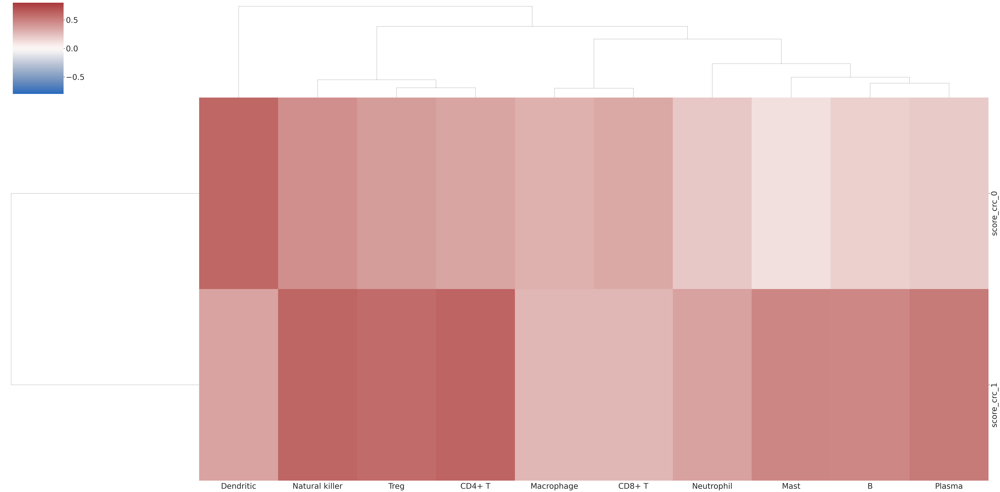

In [306]:
sns.set(font_scale=3)
clustergrid = sns.clustermap(corr_df, cmap='vlag', col_cluster=True,row_cluster=True, figsize=(60,30), vmin=-.8,center=0,vmax=.8,
               z_score=None) 

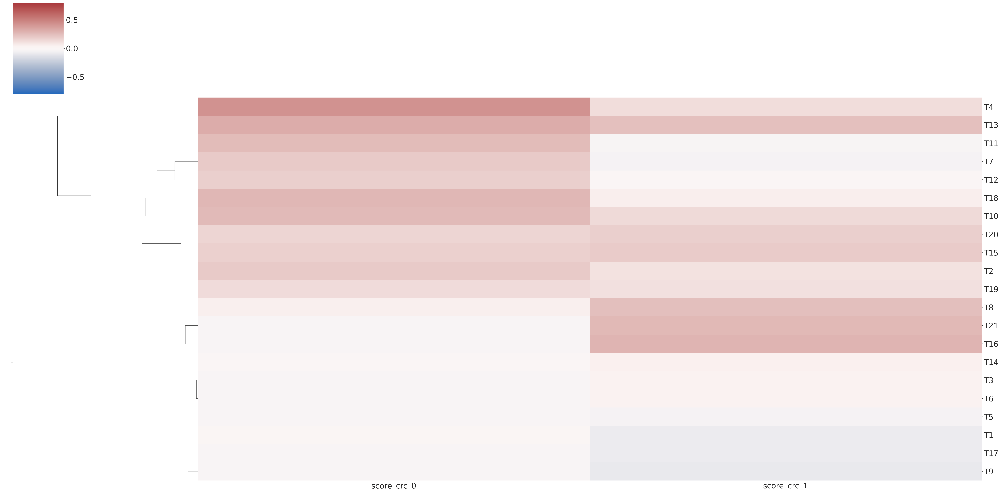

In [307]:
sns.set(font_scale=3)
plot_patients = crc_mean_df[crc_mean_df['pretreated']=='True'].drop(columns=['pretreated'])
clustergrid = sns.clustermap(plot_patients[programs_oi], cmap='vlag', col_cluster=True,row_cluster=True, figsize=(60,30), vmin=-.8,center=0,
                             vmax=.8,
               z_score=None) 

In [107]:
set(adata.obs['Level 1 Annotation'])

{'Adipocyte',
 'Cancer-associated fibroblast',
 'Endocrine',
 'Endothelial',
 'Epithelial (malignant)',
 'Epithelial (non-malignant)',
 'Intra-pancreatic neurons',
 'Lymphoid',
 'Myeloid',
 'Pericyte',
 'Schwann',
 'Vascular smooth muscle'}

In [ ]:
adata_subset = adata[adata.obs['Level 2 Annotation']=='Malignant']
adata_subset = adata_subset[adata_subset.obs['pretreated']=='True']
plot_df_corr = pd.DataFrame(adata_subset[:,all_chemokines].layers['imputed'],index=adata_subset.obs_names,
                                              columns=all_chemokines)
#plot_df_corr =scipy.stats.zscore(plot_df_corr)
plot_df_corr =  corr_cov_matrix_cluster(plot_df_corr,markers=['all_markers'], metric='spearman',
                                        clustering_method = 'average', linkage_distance=1.65)
plot_df_corr

In [62]:
def two_sample_test(df,data_column, comparison_column,sample_column=None, test='matched-pairs-signed-rank'):
    '''
    perform a two-sample test between two groups in a dataframe
    df, pandas.DataFrame containing the data and columns with the boolean categories to compare 'comparison_column' and 
    'sample_column' containing the samples (necessary for paired test only)
    data_column: str, column in df containing the data
    comparison_column: str, column in df containing the boolean Categories to be compared
    sample_column: str, column in df containing the sample identity (categorical)
    test: str, indicating type of test
    returns: test result (scipy object), effect size (list)
    '''
    import pandas as pd
    import scipy
    import numpy as np
    if test=='matched-pairs-signed-rank' and sample_column==None:
        raise ValueError('You must provide the name of the column containing the sample information if test=<matched-pairs-signed-rank>')
    df_subset_1 = df[df[comparison_column]]
    df_subset_2 = df[~df[comparison_column]]
    if test=='matched-pairs-signed-rank':
        #make sure samples are identical for matched pairs test
        intersection = set(df_subset_1[sample_column]).intersection(set(df_subset_2[sample_column]))
        complement = set(df_subset_1[sample_column]).difference(set(df_subset_2[sample_column]))
        print('filtering out samples:',complement)
        df_subset_1 = df_subset_1[df_subset_1[sample_column].isin(intersection)].sort_values(sample_column)
        df_subset_2 = df_subset_2[df_subset_2[sample_column].isin(intersection)].sort_values(sample_column)
        #double check samples are identical
        print('samples are identical:',list(df_subset_1[sample_column])==list(df_subset_2[sample_column]))
        #compare
        
        a = list(df_subset_1[data_column])
        b = list(df_subset_2[data_column])

        test = scipy.stats.wilcoxon(a, b, zero_method='wilcox', correction=False, 
                         alternative='two-sided',  axis=0, 
                         nan_policy='propagate')
        effect = (np.mean(a)- np.mean(b))/np.std(a+b)
    if test=='mann-whitney':
        #make sure samples are identical for matched pairs test
        a = list(df[df[comparison_column]][data_column])
        b = list(df[~df[comparison_column]][data_column])

        test = scipy.stats.mannwhitneyu(a, b, use_continuity=True, alternative='two-sided', 
                                        axis=0, method='auto', nan_policy='propagate')
        effect = (np.mean(a)- np.mean(b))/np.std(a+b)
    return test, effect

In [144]:
crc_mean_df['pretreated'] = crc_mean_df.index.map(metadata_df['pretreated'].to_dict())
crc_mean_df['pretreated']= crc_mean_df['pretreated'].astype(bool)
crc_mean_df

,score_crc_0,score_crc_1,score_crc_2,score_crc_3,score_crc_4,score_crc_5,pretreated
T21,0.000074,0.001415,0.062274,0.256130,0.190463,0.000781,True
U10,0.000325,0.023410,0.408988,0.116333,0.497540,0.014666,False
U6,0.008463,0.130542,0.328741,0.211236,0.274133,0.042102,False
T6,0.002835,0.037003,0.151501,0.125402,0.277307,0.029318,True
T14,0.000180,0.030589,0.284649,0.080263,0.230486,0.001281,True
T2,0.007413,0.085535,0.194340,0.149169,0.288888,0.024261,True
T8,0.045347,0.028370,0.053497,0.140474,0.138435,0.131762,True
T1,0.002398,0.015000,0.134659,0.072235,0.175494,0.030155,True
T9,0.003867,0.075924,0.155460,0.147743,0.184306,0.002420,True
T18,0.003119,0.050558,0.251154,0.149095,0.305078,0.013035,True


In [146]:
two_sample_test(crc_mean_df_test,'score_crc_1', comparison_column='pretreated',
                sample_column=None, test='mann-whitney')

(MannwhitneyuResult(statistic=180.0, pvalue=0.8107486210982506),
 -0.30567770553353146)

In [85]:
cluster_variable_names_crc

[['CXCL10', 'IL6', 'CCL2'],
 ['CXCL8', 'CXCL2', 'CXCL3', 'CXCL1', 'CXCL5'],
 ['ANGPT2', 'KITLG', 'IL7', 'TGFA', 'PDGFA'],
 ['IGFBP3', 'IGFBP2', 'VEGFA'],
 ['TNFRSF1A', 'IL15'],
 ['CXCL12', 'IGFBP4', 'CCL5', 'CCL11', 'IGFBP6', 'CXCL9', 'CXCL11', 'CXCL6']]

In [ ]:
plot_df = plt_gene_heatmap_df(adata[adata.obs['Level 2 Annotation']=='Malignant'],'pid',
                              SASP_genes_focussed,cluster_minus_one_present=False, zscore=None, )#layer_heat = 'imputed')
plot_df

,pretreated,pretreated_purity
SEACell,,
SEACell-0,True,0.826715
SEACell-1000,True,0.812500
SEACell-1001,True,0.814815
SEACell-1005,True,1.000000
SEACell-1007,True,1.000000
...,...,...
SEACell-990,True,0.971698
SEACell-991,True,1.000000
SEACell-994,True,0.913043


In [324]:
len(set(adata.obs['SEACell']))

2769

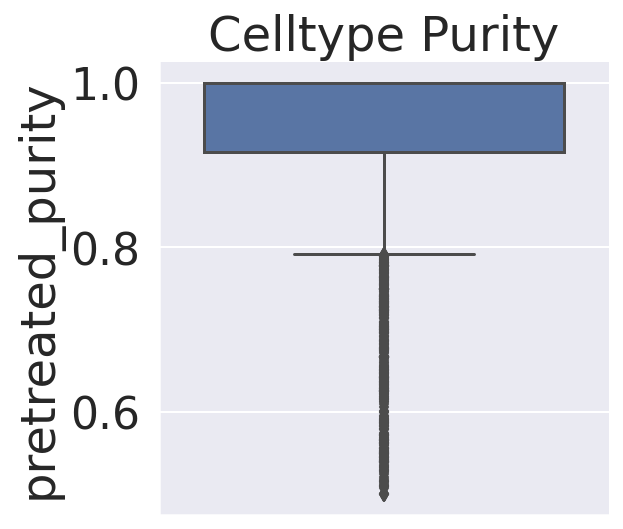

,pretreated,pretreated_purity
SEACell,,
SEACell-0,True,0.826715
SEACell-1,False,0.677326
SEACell-10,False,1.000000
SEACell-100,False,0.965909
SEACell-1000,True,0.812500


In [107]:
SEACell_purity.sort_values('pretreated_purity',ascending=False)[0:50]

,pretreated,pretreated_purity
SEACell,,
SEACell-2243,False,1.0
SEACell-2000,False,1.0
SEACell-2013,False,1.0
SEACell-2012,False,1.0
SEACell-2010,False,1.0
SEACell-30,True,1.0
SEACell-801,False,1.0
SEACell-2008,False,1.0
SEACell-2007,False,1.0


In [101]:
metadata_df

,tissue_type,tissue,pretreated,pretreatment,pretreatment_ICT,pretreatment_CTX,sequencing_technique
patient_ID,,,,,,,
U1,primary,pancreas,False,NaN,False,False,10x_v3
U2,primary,pancreas,False,NaN,False,False,10x_v3
U3,primary,pancreas,False,NaN,False,False,10x_v3
U4,primary,pancreas,False,NaN,False,False,10x_v2
U5,primary,pancreas,False,NaN,False,False,10x_v3
U6,primary,pancreas,False,NaN,False,False,10x_v3
U7,primary,pancreas,False,NaN,False,False,10x_v3
U8,primary,pancreas,False,NaN,False,False,10x_v3
U9,primary,pancreas,False,NaN,False,False,10x_v3


In [192]:
a = np.std(plot_df_corr.loc[:,plot_df_corr.columns.isin(plot_df_corr.columns)], axis=0)
b = pd.DataFrame(a.T, index=a[plot_df_corr.columns.isin(plot_df_corr.columns)].index)


computing MAGIC


Calculating MAGIC...
  Running MAGIC on 140062 cells and 19897 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 65.37 seconds.
    Calculating KNN search...
    Calculated KNN search in 534.71 seconds.
    Calculating affinities...
    Calculated affinities in 533.96 seconds.
  Calculated graph and diffusion operator in 1134.23 seconds.
  Running MAGIC with `solver='exact'` on 19897-dimensional data may take a long time. Consider denoising specific genes with `genes=<list-like>` or using `solver='approximate'`.
  Calculating imputation...
  Calculated imputation in 180.13 seconds.
Calculated MAGIC in 1320.34 seconds.


    finished (0:22:04)


In [15]:
adata = sc.read( DATA_DIR + '2021-10-06_All_Samples_Filtering_Filtered_clustered_nodrops_10000hv_annotated_AMepi_mappedlabels_clean_220818_MvsP_withnorm_frommatrices_221207_unpaired.h5ad')
adata

AnnData object with n_obs × n_vars = 140062 × 19897
    obs: 'total_counts', 'Patient', 'Sample ID', 'Sample Type', 'Treatment', 'batch', 'annotation_level_0', 'annotation_level_1', 'annotation_level_2', 'annotation_SPECTRA', 'annotation_SPECTRA_final', 'patient', 'primary-site', 'sample_type', 'treatment', 'tumor-site', 'Female_1', 'Age', 'Right', 'kras_nras', 'MSI-H', 'site', 'sample_id', 'milo_M_vs_P_all_neighborhoods', 'milo_M_vs_P_sig_neighborhoods', 'MvsP_neighborhood_fdr', 'MvsP_neighborhood_fc'
    uns: 'Patient_colors', 'annotation_SPECTRA_final_colors', 'annotation_level_0_colors', 'neighbors', 'pca', 'site_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'imputed'
    obsp: 'connectivities', 'distances'

/home/wallet/miniconda3/envs/2022_Peer_Milo_jupyter_3/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'annotation_level_0' as categorical


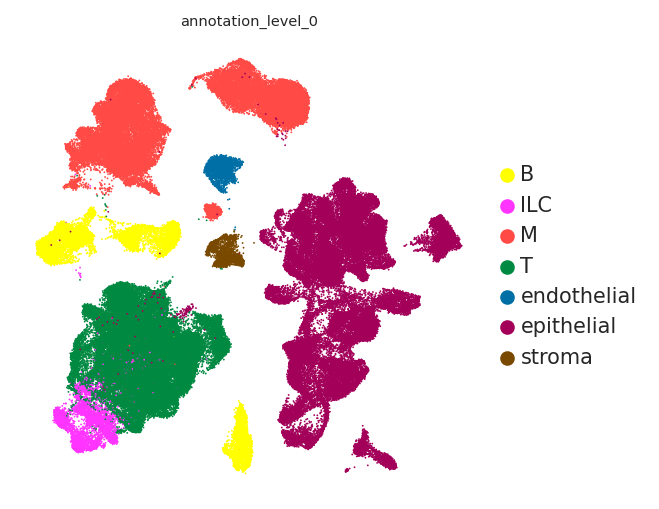

In [18]:
sc.pl.umap(adata, color = ['annotation_level_0'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0,vmax=1)


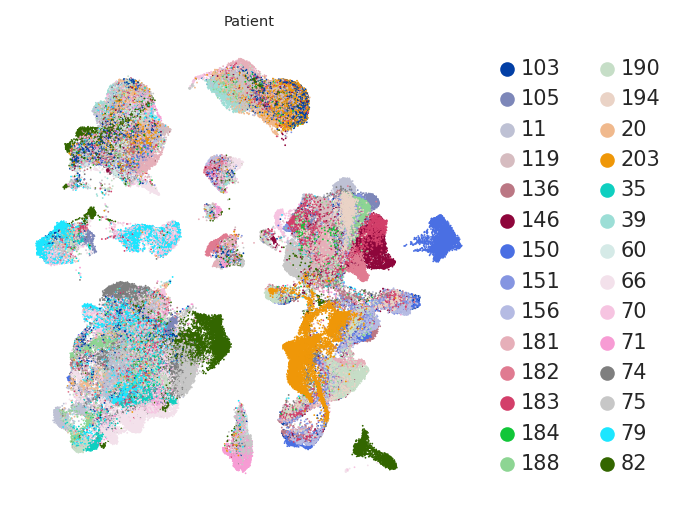

In [26]:
## sc.pl.umap(adata, color = ['annotation_SPECTRA_final'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0,vmax=1)
sc.pl.umap(adata, color = ['Patient'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0,vmax=1)


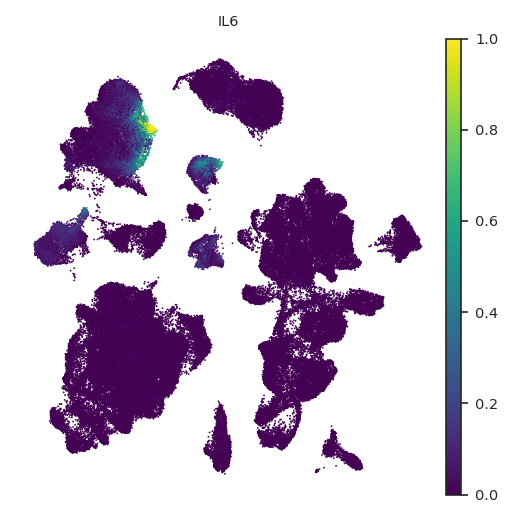

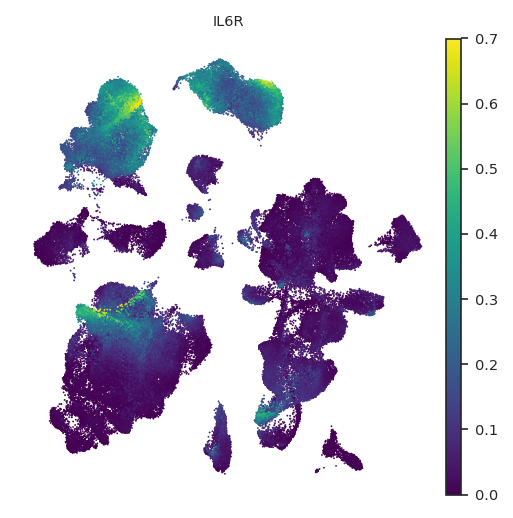

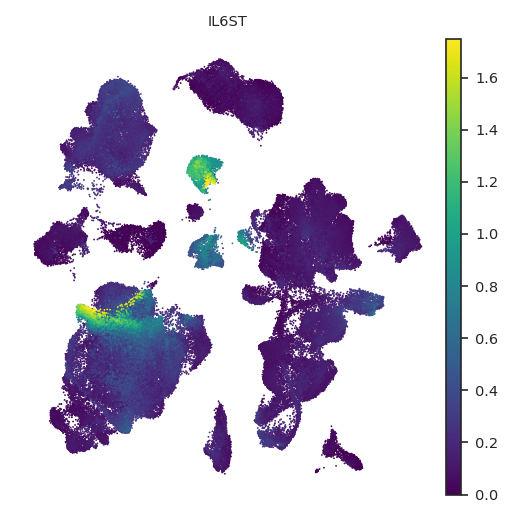

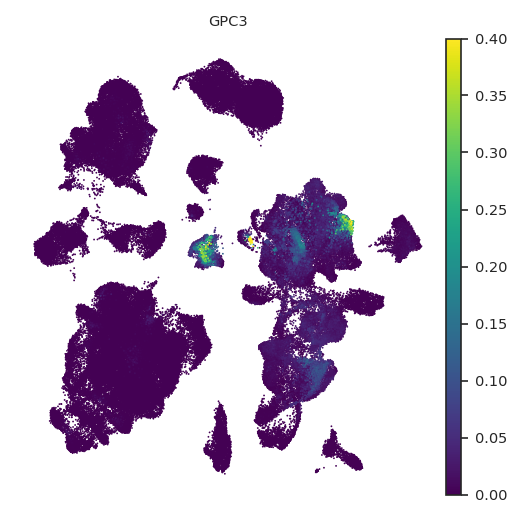

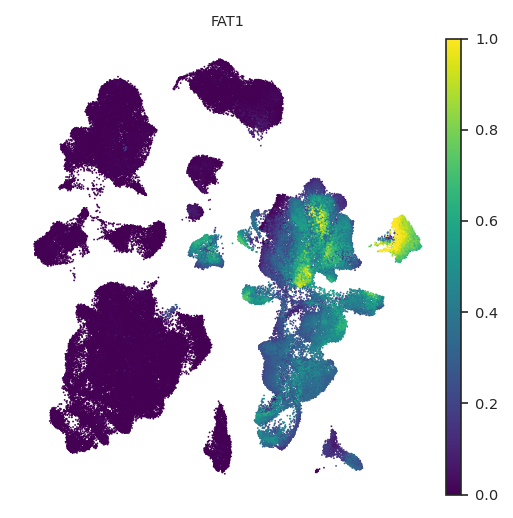

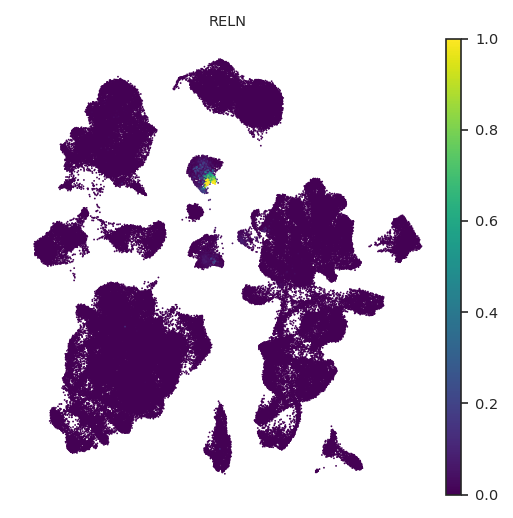

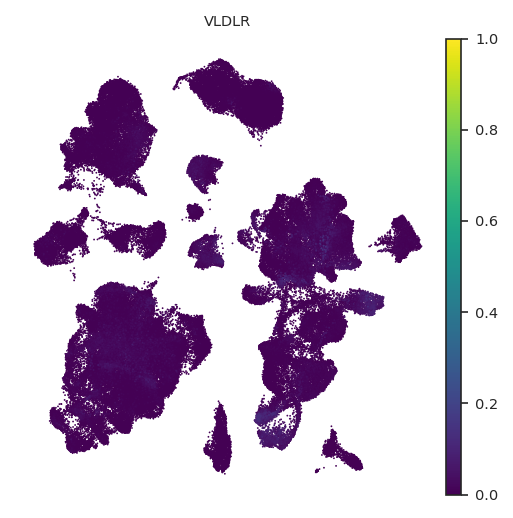

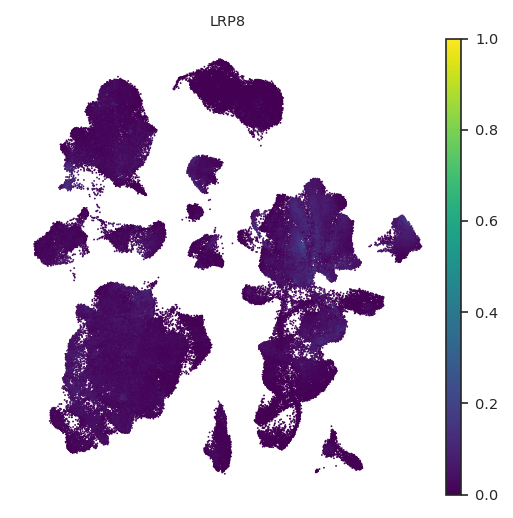

In [19]:

sc.pl.umap(adata, color = ['IL6'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0,vmax=1)
sc.pl.umap(adata, color = ['IL6R'], s = 3, cmap='viridis',legend_fontsize = 10, layer='imputed',vmin=0,vmax=.7)
sc.pl.umap(adata, color = ['IL6ST'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0,vmax=1.75)
sc.pl.umap(adata, color = ['GPC3'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0,vmax=0.4)
sc.pl.umap(adata, color = ['FAT1'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0,vmax=1)
sc.pl.umap(adata, color = ['RELN'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0,vmax=1)
sc.pl.umap(adata, color = ['VLDLR'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0,vmax=1)
sc.pl.umap(adata, color = ['LRP8'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0,vmax=1)


In [20]:
adata_sub = adata[adata.obs['Sample Type']=='Metastasis']

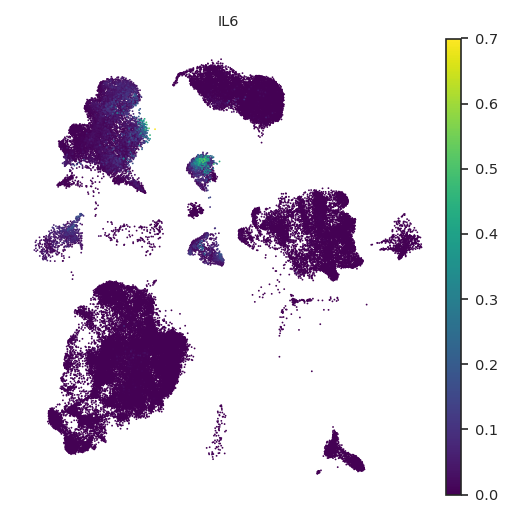

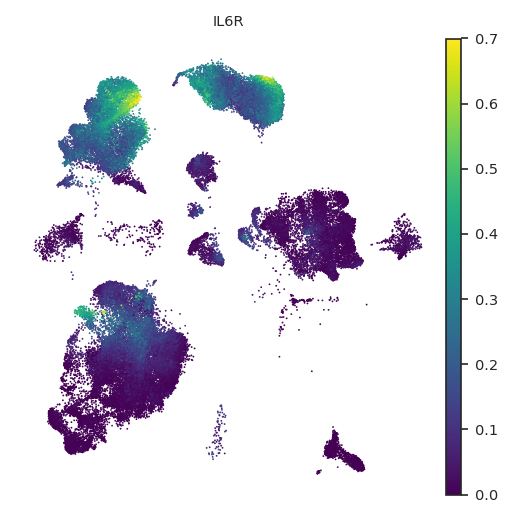

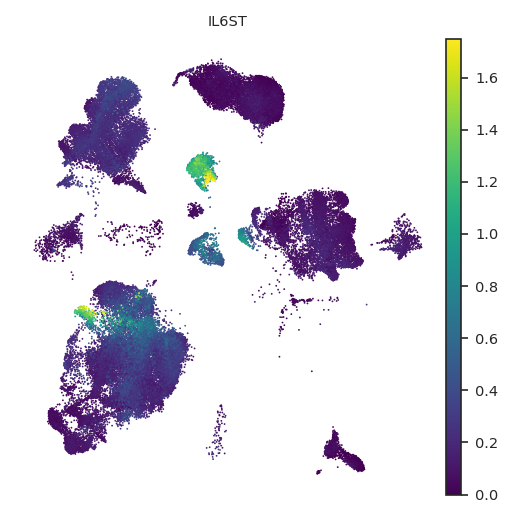

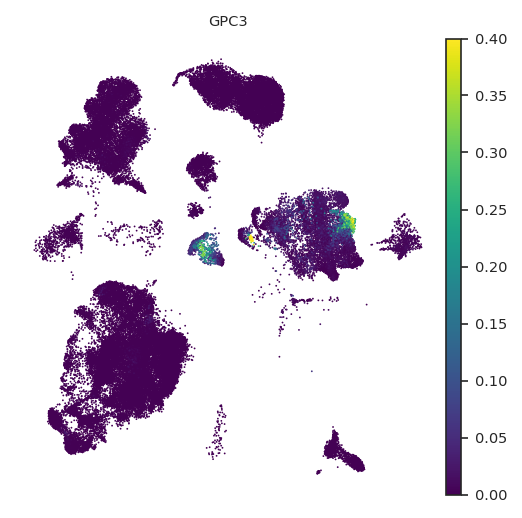

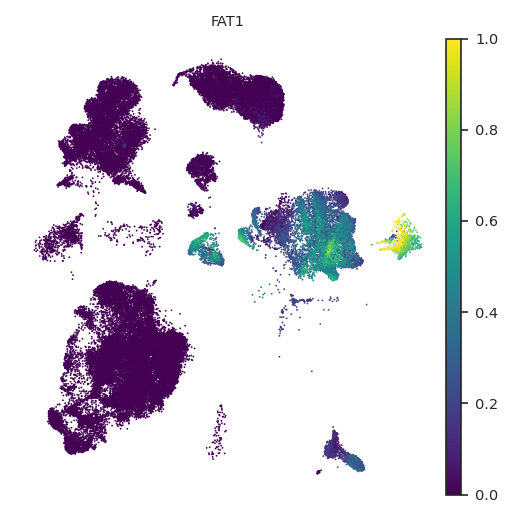

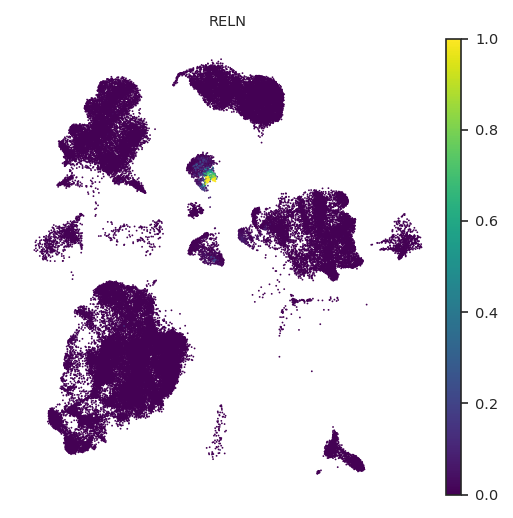

In [21]:

sc.pl.umap(adata_sub, color = ['IL6'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0,vmax=.7)
sc.pl.umap(adata_sub, color = ['IL6R'], s = 3, cmap='viridis',legend_fontsize = 10, layer='imputed',vmin=0,vmax=.7)
sc.pl.umap(adata_sub, color = ['IL6ST'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0,vmax=1.75)
sc.pl.umap(adata_sub, color = ['GPC3'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0,vmax=0.4)
sc.pl.umap(adata_sub, color = ['FAT1'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0,vmax=1)
sc.pl.umap(adata_sub, color = ['RELN'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0,vmax=1)


In [22]:
adata_sub = adata[adata.obs['Sample Type']=='Primary']

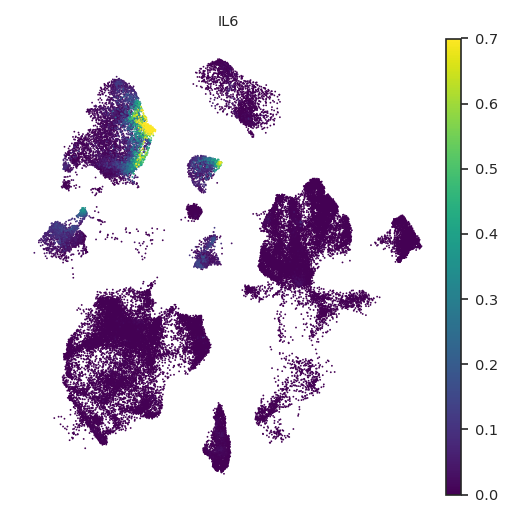

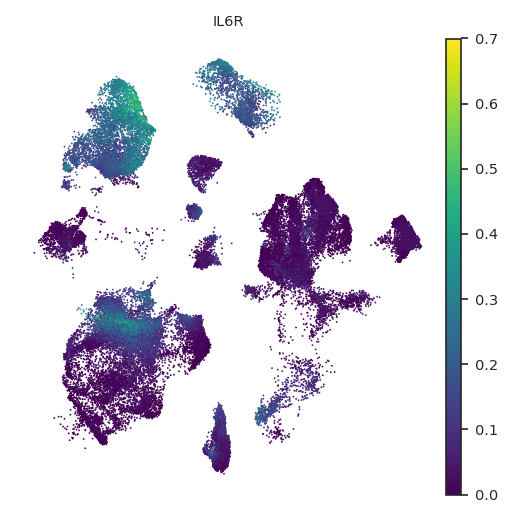

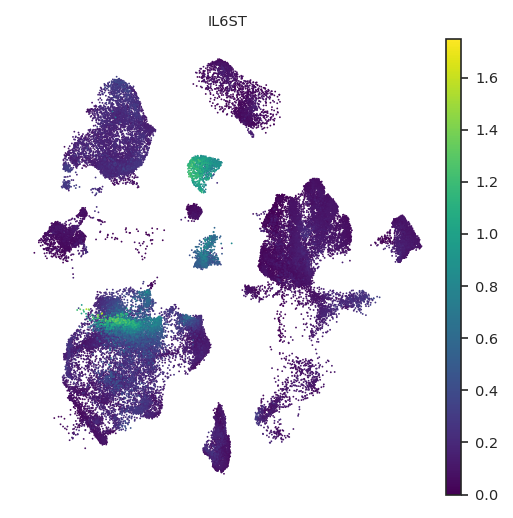

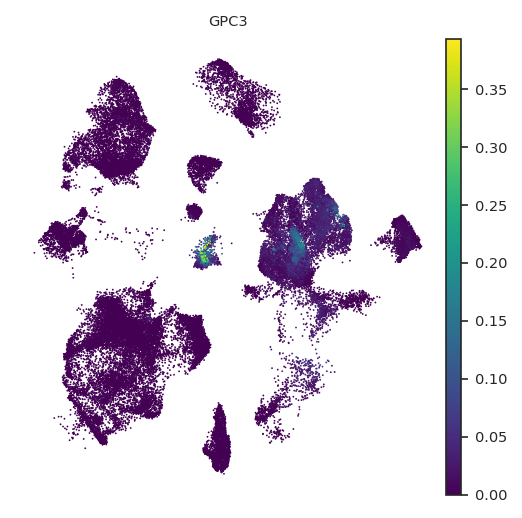

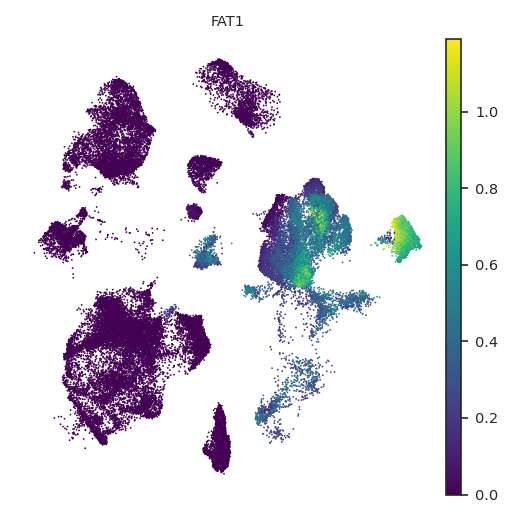

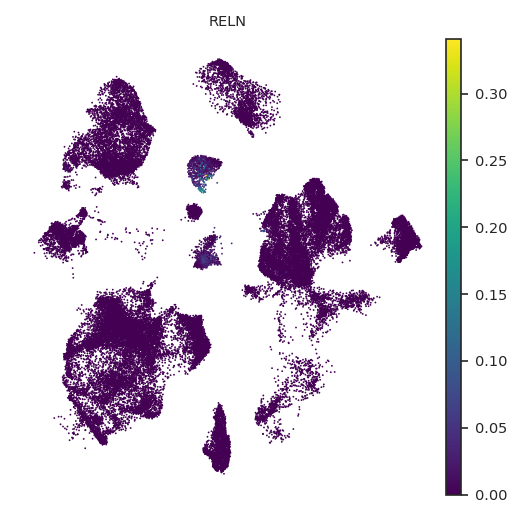

In [23]:

sc.pl.umap(adata_sub, color = ['IL6'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0,vmax=.7)
sc.pl.umap(adata_sub, color = ['IL6R'], s = 3, cmap='viridis',legend_fontsize = 10, layer='imputed',vmin=0,vmax=.7)
sc.pl.umap(adata_sub, color = ['IL6ST'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0,vmax=1.75)
sc.pl.umap(adata_sub, color = ['GPC3'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0)
sc.pl.umap(adata_sub, color = ['FAT1'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0)
sc.pl.umap(adata_sub, color = ['RELN'], s = 3, cmap='viridis', legend_fontsize = 10,layer='imputed',vmin=0)


In [27]:
adata

AnnData object with n_obs × n_vars = 140062 × 19897
    obs: 'total_counts', 'Patient', 'Sample ID', 'Sample Type', 'Treatment', 'batch', 'annotation_level_0', 'annotation_level_1', 'annotation_level_2', 'annotation_SPECTRA', 'annotation_SPECTRA_final', 'patient', 'primary-site', 'sample_type', 'treatment', 'tumor-site', 'Female_1', 'Age', 'Right', 'kras_nras', 'MSI-H', 'site', 'sample_id', 'milo_M_vs_P_all_neighborhoods', 'milo_M_vs_P_sig_neighborhoods', 'MvsP_neighborhood_fdr', 'MvsP_neighborhood_fc'
    uns: 'Patient_colors', 'annotation_SPECTRA_final_colors', 'neighbors', 'pca', 'site_colors', 'umap', 'annotation_level_1_colors', 'annotation_level_0_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'imputed'
    obsp: 'connectivities', 'distances'

In [28]:
#remove cells that contain NaN in PCA space
adata = adata[~np.isnan(adata.obsm["X_pca"]).any(axis=1),:]
adata

View of AnnData object with n_obs × n_vars = 140062 × 19897
    obs: 'total_counts', 'Patient', 'Sample ID', 'Sample Type', 'Treatment', 'batch', 'annotation_level_0', 'annotation_level_1', 'annotation_level_2', 'annotation_SPECTRA', 'annotation_SPECTRA_final', 'patient', 'primary-site', 'sample_type', 'treatment', 'tumor-site', 'Female_1', 'Age', 'Right', 'kras_nras', 'MSI-H', 'site', 'sample_id', 'milo_M_vs_P_all_neighborhoods', 'milo_M_vs_P_sig_neighborhoods', 'MvsP_neighborhood_fdr', 'MvsP_neighborhood_fc'
    uns: 'Patient_colors', 'annotation_SPECTRA_final_colors', 'neighbors', 'pca', 'site_colors', 'umap', 'annotation_level_1_colors', 'annotation_level_0_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'imputed'
    obsp: 'connectivities', 'distances'

In [29]:
#neighbors and umap embedding
sc.pp.neighbors(adata, n_neighbors=40, method= 'umap', n_pcs=number_of_PC_used)
sc.tl.umap(adata)

NameError: name 'number_of_PC_used' is not defined

In [30]:
#tsne embedding
sc.tl.tsne(adata, random_state = 7,n_pcs=number_of_PC_used)



NameError: name 'number_of_PC_used' is not defined

In [ ]:
adata.write(adata_save_path)
print('saved to:',adata_save_path)
adata

In [16]:
adata = sc.read(adata_save_path)
adata

AnnData object with n_obs × n_vars = 140062 × 19897
    obs: 'total_counts', 'Patient', 'Sample ID', 'Sample Type', 'Treatment', 'batch', 'annotation_level_0', 'annotation_level_1', 'annotation_level_2', 'annotation_SPECTRA', 'annotation_SPECTRA_final', 'patient', 'primary-site', 'sample_type', 'treatment', 'tumor-site', 'Female_1', 'Age', 'Right', 'kras_nras', 'MSI-H', 'site', 'sample_id', 'milo_M_vs_P_all_neighborhoods', 'milo_M_vs_P_sig_neighborhoods', 'MvsP_neighborhood_fdr', 'MvsP_neighborhood_fc'
    uns: 'Patient_colors', 'annotation_SPECTRA_final_colors', 'neighbors', 'pca', 'site_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'imputed'
    obsp: 'connectivities', 'distances'

In [31]:
adata.obs['sample_id'] = adata.obs['Sample ID']

Trying to set attribute `.obs` of view, copying.


In [32]:
set(adata.obs['sample_id'])

{'KG103M',
 'KG103N',
 'KG103P',
 'KG105M',
 'KG105P',
 'KG119M',
 'KG119P',
 'KG11M',
 'KG11N',
 'KG11P',
 'KG136M',
 'KG136N',
 'KG136P',
 'KG146M',
 'KG146M2',
 'KG146N',
 'KG146P',
 'KG150M',
 'KG150N',
 'KG150P',
 'KG151M',
 'KG151N',
 'KG151P',
 'KG156M',
 'KG156N',
 'KG156P',
 'KG181N',
 'KG181P',
 'KG182M',
 'KG182M2',
 'KG182N',
 'KG182P',
 'KG183M',
 'KG183M2',
 'KG183N',
 'KG183P',
 'KG184M',
 'KG184N',
 'KG184P',
 'KG188M',
 'KG188N',
 'KG188P',
 'KG190M',
 'KG190N',
 'KG190P',
 'KG194M',
 'KG194N',
 'KG194P',
 'KG203M',
 'KG203N',
 'KG203P',
 'KG20M',
 'KG20N',
 'KG20P',
 'KG35M',
 'KG35P',
 'KG39M',
 'KG60M',
 'KG60P',
 'KG66M',
 'KG66M2',
 'KG66N',
 'KG66P',
 'KG70M',
 'KG70N',
 'KG70P',
 'KG71M',
 'KG71P',
 'KG74M',
 'KG74N',
 'KG74P',
 'KG75M',
 'KG75M2',
 'KG75P',
 'KG75P2',
 'KG79M',
 'KG79N',
 'KG79P',
 'KG82M',
 'KG82M2',
 'KG82P'}

In [33]:
adata = sc.read(adata_save_path)
adata

AnnData object with n_obs × n_vars = 140062 × 19897
    obs: 'total_counts', 'Patient', 'Sample ID', 'Sample Type', 'Treatment', 'batch', 'annotation_level_0', 'annotation_level_1', 'annotation_level_2', 'annotation_SPECTRA', 'annotation_SPECTRA_final', 'patient', 'primary-site', 'sample_type', 'treatment', 'tumor-site', 'Female_1', 'Age', 'Right', 'kras_nras', 'MSI-H', 'site', 'sample_id', 'milo_M_vs_P_all_neighborhoods', 'milo_M_vs_P_sig_neighborhoods', 'MvsP_neighborhood_fdr', 'MvsP_neighborhood_fc'
    uns: 'Patient_colors', 'annotation_SPECTRA_final_colors', 'neighbors', 'pca', 'site_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'imputed'
    obsp: 'connectivities', 'distances'

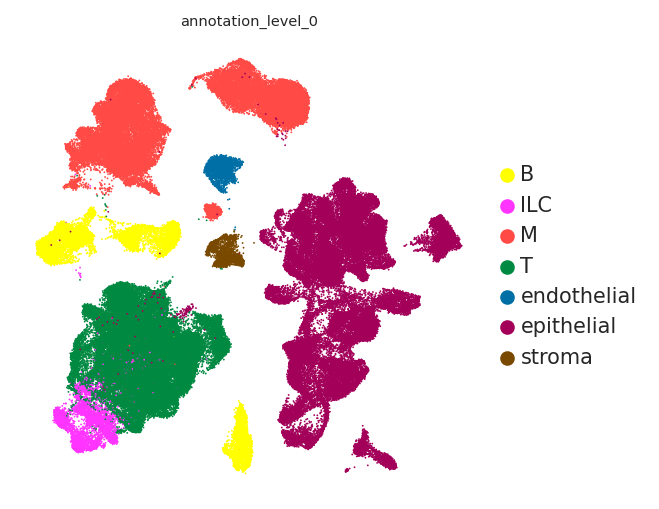

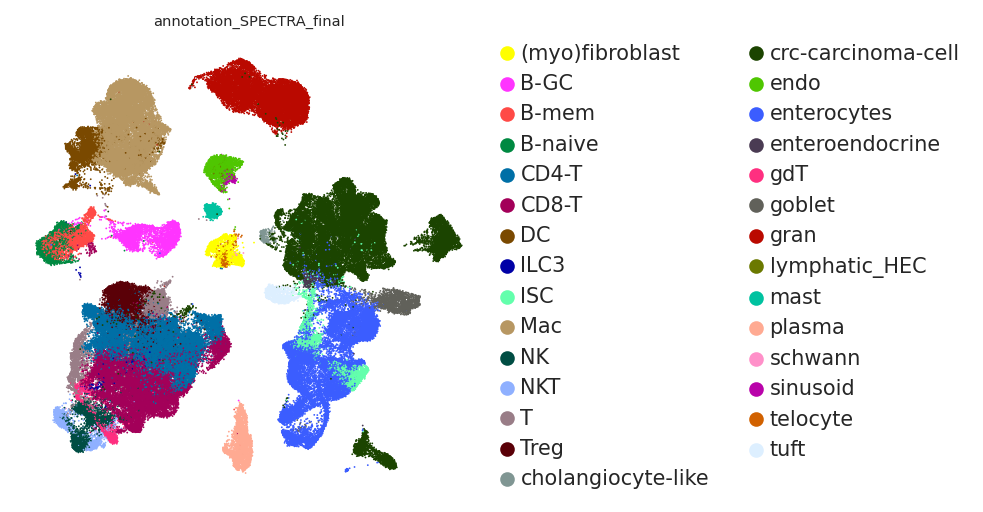

In [20]:
sc.pl.umap(adata, color = ['annotation_level_0'], s = 3, palette=color_map_clusters_nogrey, legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['annotation_SPECTRA_final'], s = 3, palette=color_map_clusters_nogrey, legend_fontsize = 10, vmin=0)


## Milo

### Make Milo object

To start with, we have to convert our anndata object back into a SingleCellExperiment. The `anndata2ri` converter doesn't seem to like converting anndata objects storing the KNN graph in the `adata.obsp` slot, probably because there is no dedicated slot in the `SingleCellExperiment` object. Because of this, we will first make a copy of our `anndata` without KNN graph for conversion.

define your output data directory (this is where we will store the adjacency matrices for each neighborhood later)

%%R
dir = '/data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/'
OUT_RESULT_DIR = paste0(dir, 'milo_MvsP_allandnorm_220823/')

dir = '/data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/'
OUT_RESULT_DIR = dir + 'milo_MvsP_allandnorm_220823/'

%%R
dir = '/data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/'
OUT_RESULT_DIR = paste0(dir, 'milo_MvsAN_allandnorm_220822/')

#This for MvsAN
dir = '/data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/'
OUT_RESULT_DIR = dir + 'milo_MvsAN_allandnorm_220822/'

In [96]:
%%R
dir = '/data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/'
#OUT_RESULT_DIR = paste0(dir, 'milo_MvsP_allandnorm_221207/')
#OUT_RESULT_DIR = paste0(dir, 'milo_MvsAN_allandnorm_221207/')
OUT_RESULT_DIR = paste0(dir, 'milo_PvsAN_allandnorm_221207/')

In [97]:
#This for MvsAN
dir = '/data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/'
#OUT_RESULT_DIR = dir + 'milo_MvsP_allandnorm_221207/'
#OUT_RESULT_DIR = dir + 'milo_MvsAN_allandnorm_221207/'
OUT_RESULT_DIR = dir + 'milo_PvsAN_allandnorm_221207/'

In [98]:
%%R
print(OUT_RESULT_DIR)

[1] "/data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/milo_PvsAN_allandnorm_221207/"


In [99]:
#remove neighbors
adata_no_knn = adata.copy()
adata_no_knn.obsp = None
adata_no_knn.uns.pop("neighbors")
adata_no_knn

AnnData object with n_obs × n_vars = 140062 × 19897
    obs: 'total_counts', 'Patient', 'Sample ID', 'Sample Type', 'Treatment', 'batch', 'annotation_level_0', 'annotation_level_1', 'annotation_level_2', 'annotation_SPECTRA', 'annotation_SPECTRA_final', 'patient', 'primary-site', 'sample_type', 'treatment', 'tumor-site', 'Female_1', 'Age', 'Right', 'kras_nras', 'MSI-H', 'site', 'sample_id', 'milo_M_vs_P_all_neighborhoods', 'milo_M_vs_P_sig_neighborhoods', 'MvsP_neighborhood_fdr', 'MvsP_neighborhood_fc'
    uns: 'Patient_colors', 'annotation_SPECTRA_final_colors', 'annotation_level_0_colors', 'pca', 'site_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'imputed'

In [100]:
set(adata_no_knn.obs['site'])

{'M', 'N', 'P'}

In [101]:
#anndata2ri has difficulty with some .obs so let's reduce them to the minimum we need
adata_no_knn.obs = pd.DataFrame(adata_no_knn.obs[['patient', 'site','sample_id']])
adata_no_knn.obs

,patient,site,sample_id
196115546421469_KG183N,ID-183,N,KG183N
227861662219060_KG103M,ID-103,M,KG103M
134043592218332_KG35M,ID-35,M,KG35M
122427450804980_KG182M2,ID-182,M,KG182M2
156049528215924_KG190P,ID-190,P,KG190P
...,...,...,...
201542895787237_KG203P,ID-203,P,KG203P
227374203038564_KG203P,ID-203,P,KG203P
227449346046301_KG203P,ID-203,P,KG203P
231365388982630_KG203P,ID-203,P,KG203P


In [102]:
#select relevant data and create new anndata object, anndata2ri has problems with indices otherwise
adata_no_knn = anndata.AnnData(X=adata_no_knn.X, obs=adata_no_knn.obs, var=adata_no_knn.var, uns=None, obsm=adata_no_knn.obsm, 
                              varm=None, layers=None, raw=None, dtype='float32', 
                              shape=None, filename=None, filemode=None, asview=False, obsp=None, varp=None, oidx=None, vidx=None)
adata_no_knn

AnnData object with n_obs × n_vars = 140062 × 19897
    obs: 'patient', 'site', 'sample_id'
    obsm: 'X_pca', 'X_tsne', 'X_umap'

This can be converted to a `SingleCellExperiment` using R magic again

In [103]:
%%R -i adata_no_knn
adata_no_knn

class: SingleCellExperiment 
dim: 19897 140062 
metadata(0):
assays(1): X
rownames(19897): B3GALT4 HIST3H2BB ... RP5-1102E8.3 OTUD7B
rowData names(0):
colnames(140062): 196115546421469_KG183N 227861662219060_KG103M ...
  231365388982630_KG203P 241055667743660_KG203P
colData names(3): patient site sample_id
reducedDimNames(3): PCA TSNE UMAP
mainExpName: NULL
altExpNames(0):


And we can make a Milo class object for DA analysis

In [104]:
%%R 
milo <- Milo(adata_no_knn)
milo

class: Milo 
dim: 19897 140062 
metadata(0):
assays(1): X
rownames(19897): B3GALT4 HIST3H2BB ... RP5-1102E8.3 OTUD7B
rowData names(0):
colnames(140062): 196115546421469_KG183N 227861662219060_KG103M ...
  231365388982630_KG203P 241055667743660_KG203P
colData names(3): patient site sample_id
reducedDimNames(3): PCA TSNE UMAP
mainExpName: NULL
altExpNames(0):
nhoods dimensions(2): 1 1
nhoodCounts dimensions(2): 1 1
nhoodDistances dimension(1): 0
graph names(0):
nhoodIndex names(1): 0
nhoodExpression dimension(2): 1 1
nhoodReducedDim names(0):
nhoodGraph names(0):
nhoodAdjacency dimension(2): 1 1


### Add KNN graph

recompute the KNN graph using the dedicated function in `miloR`. 
the is also a way to use the knn graph calculated in python in the Milo tutorial but transfer to R did not work in this case

In [105]:
%%R 
library(miloR)

In [106]:
#how many Pcs does your data have
num_PCs = adata_no_knn.obsm['X_pca'].shape[1]
print('number of PCs in adata is:',num_PCs)

number of PCs in adata is: 50


In [107]:
%%R -i num_PCs
num_PCs

[1] 50


In [108]:
%%R 
milo <- buildGraph(milo, k=40, d=num_PCs,
  transposed = TRUE,
  get.distance = FALSE,
  reduced.dim = "PCA"
)


In [109]:
%%R
milo

class: Milo 
dim: 19897 140062 
metadata(0):
assays(1): X
rownames(19897): B3GALT4 HIST3H2BB ... RP5-1102E8.3 OTUD7B
rowData names(0):
colnames(140062): 196115546421469_KG183N 227861662219060_KG103M ...
  231365388982630_KG203P 241055667743660_KG203P
colData names(3): patient site sample_id
reducedDimNames(3): PCA TSNE UMAP
mainExpName: NULL
altExpNames(0):
nhoods dimensions(2): 1 1
nhoodCounts dimensions(2): 1 1
nhoodDistances dimension(1): 0
graph names(1): graph
nhoodIndex names(1): 0
nhoodExpression dimension(2): 1 1
nhoodReducedDim names(0):
nhoodGraph names(0):
nhoodAdjacency dimension(2): 1 1


### Run Milo analysis

Now we are all set to run the different steps of the Milo analysis in our R chunks. Let's start by defining our design matrix. Here we are going to test for DA between cells in stage M vs P, without a confounding variable

In [110]:
#define dataframe to input in milo (at least cells x independent variable)
design_df = adata.obs[[ 'site', 'sample_id']]# 'treatment', 
     #  'Female_1', 'Age', 'Right', 'kras_nras', 'MSI-H',]]
design_df.drop_duplicates(inplace=True)
design_df.index = design_df['sample_id']
design_df

/home/wallet/.local/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


,site,sample_id
sample_id,,
KG183N,N,KG183N
KG103M,M,KG103M
KG35M,M,KG35M
KG182M2,M,KG182M2
KG190P,P,KG190P
...,...,...
KG146N,N,KG146N
KG203N,N,KG203N
KG181N,N,KG181N


#subset to M vs P
design_df = design_df[design_df['site'].isin(['M','P'])]
design_df

#convert to 0 and 1
design_df['site'] = design_df['site'].map({'M':1,'P':0})
design_df

#subset to M vs AN
design_df = design_df[design_df['site'].isin(['M','N'])]
design_df

#convert to 0 and 1
design_df['site'] = design_df['site'].map({'M':1,'N':0})
design_df

In [111]:
#subset toPvs AN
#design_df = design_df[design_df['site'].isin(['M','P'])]
#design_df = design_df[design_df['site'].isin(['M','N'])]
design_df = design_df[design_df['site'].isin(['P','N'])]

design_df

#convert to 0 and 1
#design_df['site'] = design_df['site'].map({'M':1,'P':0})
#design_df['site'] = design_df['site'].map({'M':1,'N':0})
design_df['site'] = design_df['site'].map({'P':1,'N':0})

design_df

/scratch/lsftmp/13065915.tmpdir/ipykernel_808085/3407902774.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  design_df['site'] = design_df['site'].map({'P':1,'N':0})


,site,sample_id
sample_id,,
KG183N,0.0,KG183N
KG190P,1.0,KG190P
KG66P,1.0,KG66P
KG70P,1.0,KG70P
KG150P,1.0,KG150P
KG183P,1.0,KG183P
KG156P,1.0,KG156P
KG119P,1.0,KG119P
KG60P,1.0,KG60P


In [112]:
#design_df['patient'] = design_df['patient'].astype(str)
design_df['sample_id'] = design_df['sample_id'].astype(str)
design_df['site']= design_df['site'].astype(int)

/scratch/lsftmp/13065915.tmpdir/ipykernel_808085/2503820353.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  design_df['sample_id'] = design_df['sample_id'].astype(str)
/scratch/lsftmp/13065915.tmpdir/ipykernel_808085/2503820353.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  design_df['site']= design_df['site'].astype(int)


Then we just copy the steps from the package vignettes. Again, we need to give the design dataframe in input to the R chunk, and ask for the dataframe storing differential abundance results as output. 

In [113]:
%%R -i design_df -o DA_results
## Define neighbourhoods
set.seed(100)
milo <- makeNhoods(milo, prop = 0.1, k = 40, d=num_PCs, refined = TRUE)

## Count cells in neighbourhoods
milo <- countCells(milo, meta.data = data.frame(colData(milo)), sample="sample_id")

## Calculate distances between cells in neighbourhoods
## for spatial FDR correction
milo <- calcNhoodDistance(milo, d=num_PCs)

## Test for differential abundance set ~ <confounding_variable>  + <independent variable>

#correcting for confounding variable (key of that variable in original adata.obs)
DA_results <- testNhoods(milo, design = ~  site , design.df = design_df)

#without correcting for confounding variable
#DA_results <- testNhoods(milo, design = ~ site , design.df = design_df)

inspect the exported result dataframe in python containing the log fold change and 
false discovery rates computed by milo. Min that every row is a cell and NOT a neighborhood. Also for some unknown reason the indices of the dataframe are NOT the names of the neighborhood. We will export the neighbor-
hood names from R below, which is important for visualizing these in python.

In [114]:
DA_results.sort_values('FDR')

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR
10359,-4.751175e+00,8.736011,30.983012,2.604363e-08,0.000001,10359.0,9.396409e-07
8371,-4.436496e+00,8.612727,30.328246,3.649626e-08,0.000001,8371.0,9.396409e-07
2771,-4.556992e+00,8.656943,30.682621,3.040344e-08,0.000001,2771.0,9.396409e-07
2773,-4.262123e+00,8.548921,30.326013,3.653830e-08,0.000001,2773.0,9.396409e-07
2776,-4.546944e+00,8.654089,30.582634,3.201118e-08,0.000001,2776.0,9.396409e-07
...,...,...,...,...,...,...,...
6496,-2.562741e-15,7.990742,0.000000,1.000000e+00,1.000000,6496.0,1.000000e+00
9400,-2.562741e-15,7.990742,0.000000,1.000000e+00,1.000000,9400.0,1.000000e+00
4103,-1.901444e-02,8.035831,0.004941,9.737241e-01,1.000000,4103.0,1.000000e+00
7778,-2.562741e-15,7.990742,0.000000,1.000000e+00,1.000000,7778.0,1.000000e+00


Text(0, 0.5, '- log10(Spatial FDR)')

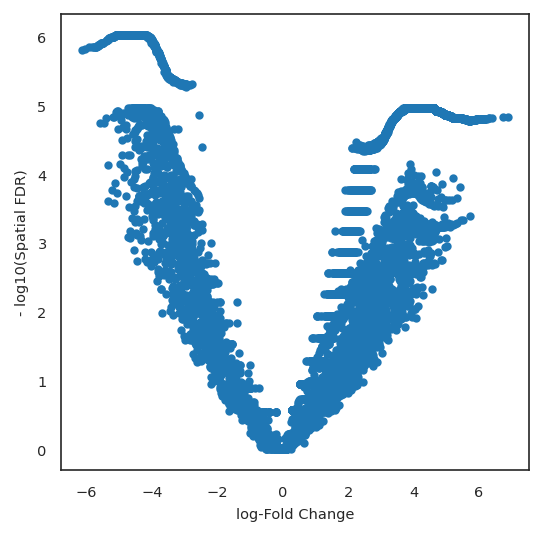

In [115]:
#inspect fold change and FDR in a volcano plot
plt.plot(DA_results.logFC, -np.log10(DA_results.SpatialFDR), '.');
plt.xlabel("log-Fold Change");
plt.ylabel("- log10(Spatial FDR)")

### Visualizing results from Milo analysis

To visualize DA results and relate them to the single-cell embedding, we build an abstracted graph of connecting neighbourhoods that have cells in common. This is implemented in the `buildNhoodGraph` function (shouldn't be too difficult to do a python implementation of this).

In [116]:
%%R
milo <- buildNhoodGraph(milo)
library(ggplot2)

In [117]:
adata

AnnData object with n_obs × n_vars = 140062 × 19897
    obs: 'total_counts', 'Patient', 'Sample ID', 'Sample Type', 'Treatment', 'batch', 'annotation_level_0', 'annotation_level_1', 'annotation_level_2', 'annotation_SPECTRA', 'annotation_SPECTRA_final', 'patient', 'primary-site', 'sample_type', 'treatment', 'tumor-site', 'Female_1', 'Age', 'Right', 'kras_nras', 'MSI-H', 'site', 'sample_id', 'milo_M_vs_P_all_neighborhoods', 'milo_M_vs_P_sig_neighborhoods', 'MvsP_neighborhood_fdr', 'MvsP_neighborhood_fc'
    uns: 'Patient_colors', 'annotation_SPECTRA_final_colors', 'annotation_level_0_colors', 'neighbors', 'pca', 'site_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'imputed'
    obsp: 'connectivities', 'distances'

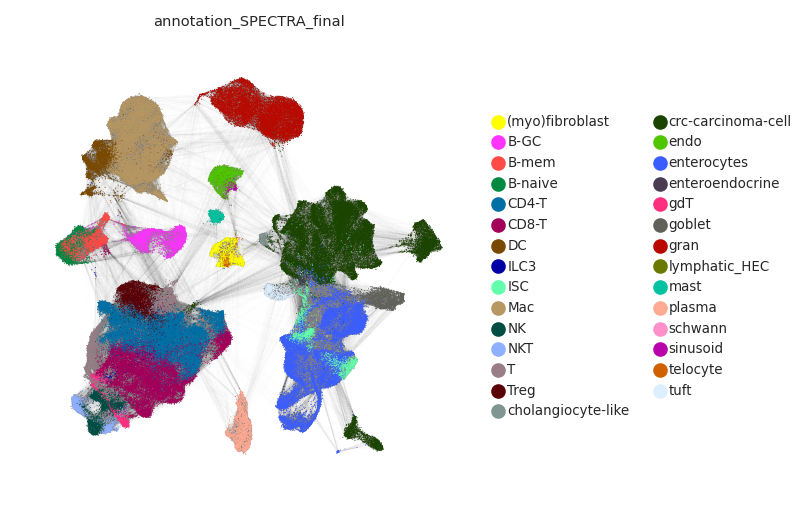

In [118]:
sc.pl.umap(adata, color="annotation_SPECTRA_final", edges=True, edges_width=0.001, edges_color='grey',palette=color_map_clusters_nogrey,
                                                                                 save='Ganesh_CRC_umap_milo_annotation_spectra_final.svg')

To visualize the graph, you have again multiple options. The first one is to just use the functionalities implemented in the `miloR` package in another R chunk.

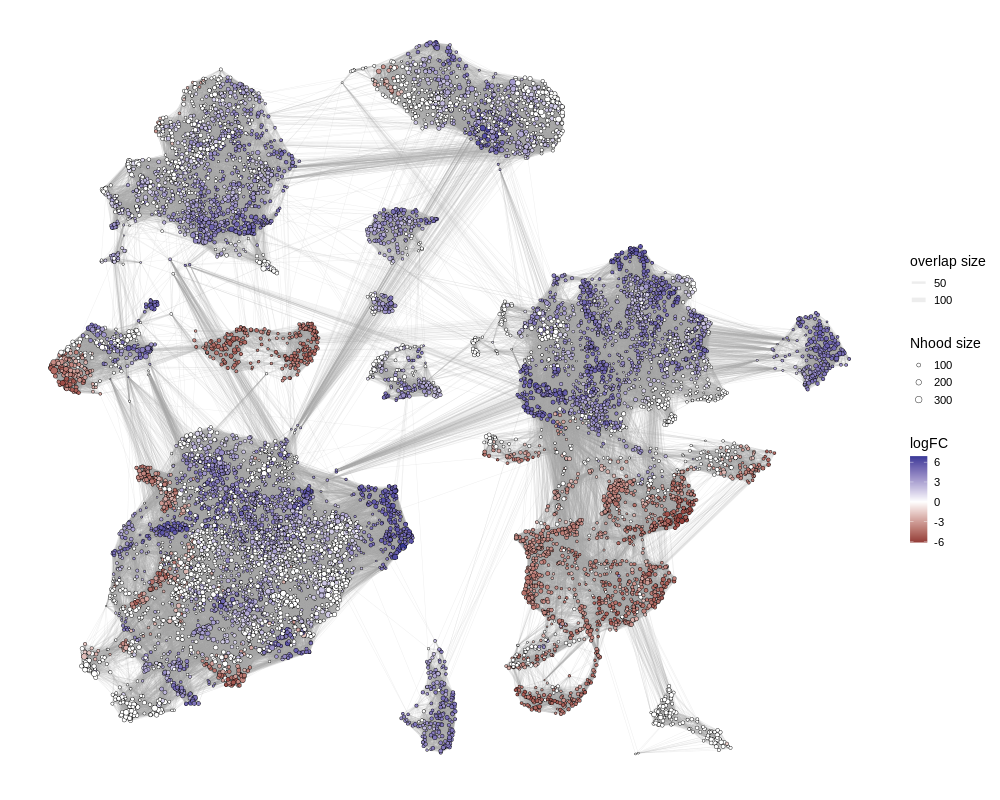

In [119]:
%%R -w 1000 -h 800
g <- plotNhoodGraphDA(milo, DA_results, alpha=0.05, res_column='logFC', layout='UMAP')
g

#this attempt to change color did not work:
#g+scale_color_gradient(low="blue", high="red")
#mid<-mean(milo$logFC)
#g + scale_color_gradient2(midpoint=mid, low="blue", mid="white",
                #     high="red", space ="Lab" )

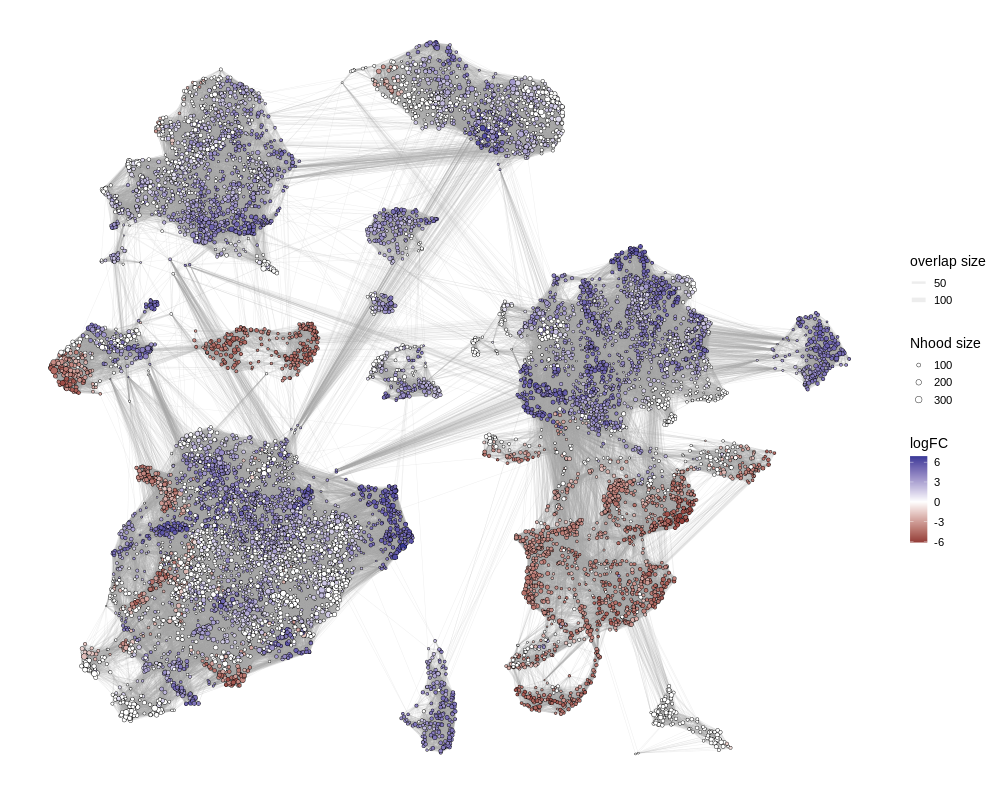

In [120]:
%%R -w 1000 -h 800
g <- plotNhoodGraphDA(milo, DA_results, alpha=0.1, res_column='logFC', layout='UMAP')
g

#this attempt to change color did not work:
#g+scale_color_gradient(low="blue", high="red")
#mid<-mean(milo$logFC)
#g + scale_color_gradient2(midpoint=mid, low="blue", mid="white",
                #     high="red", space ="Lab" )

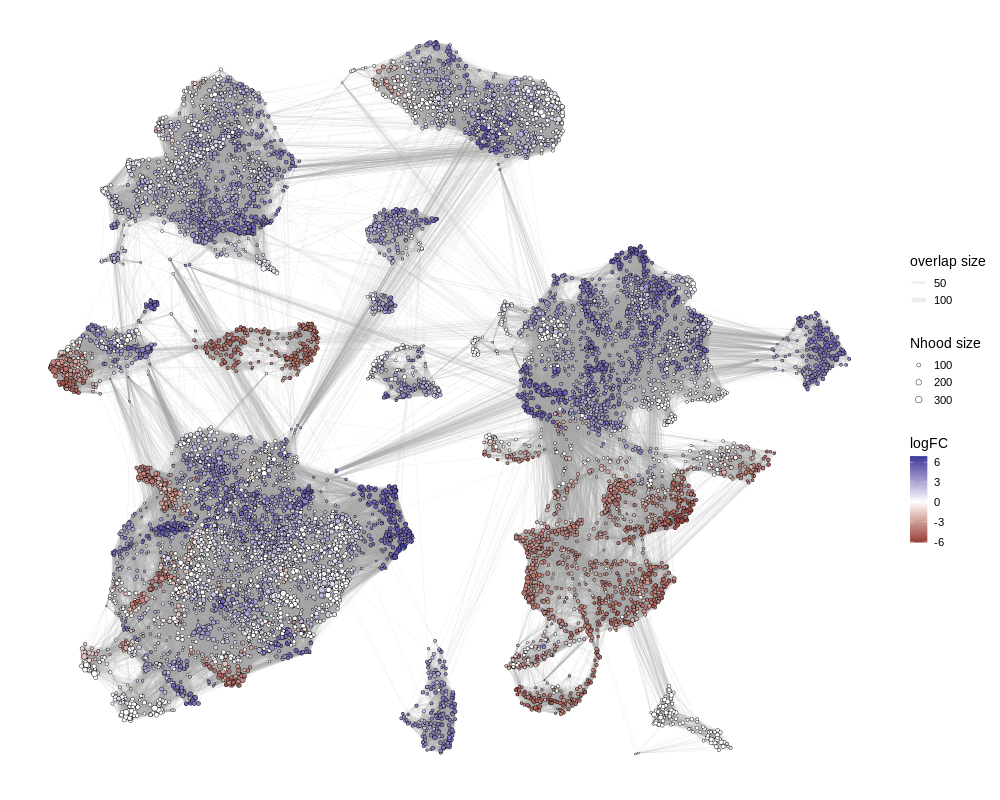

In [121]:
%%R -w 1000 -h 800
g <- plotNhoodGraphDA(milo, DA_results, alpha=0.2, res_column='logFC', layout='UMAP')
g

#this attempt to change color did not work:
#g+scale_color_gradient(low="blue", high="red")
#mid<-mean(milo$logFC)
#g + scale_color_gradient2(midpoint=mid, low="blue", mid="white",
                #     high="red", space ="Lab" )

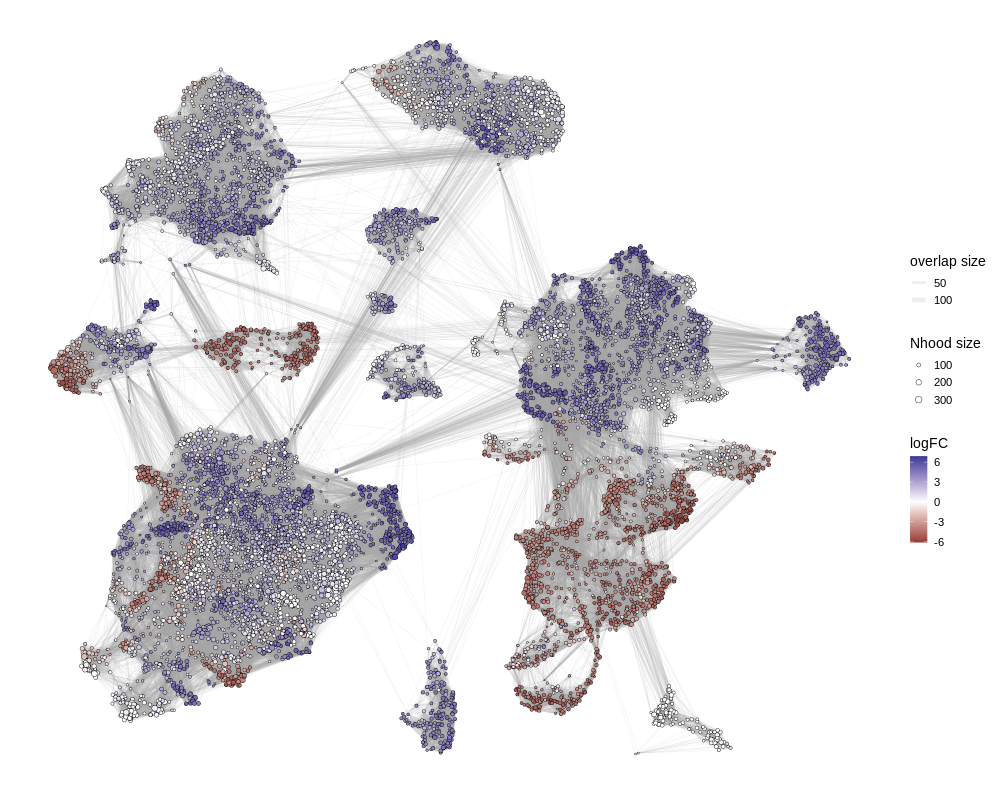

In [122]:
%%R -w 1000 -h 800
g <- plotNhoodGraphDA(milo, DA_results, alpha=1, res_column='logFC', layout='UMAP')
g

#this attempt to change color did not work:
#g+scale_color_gradient(low="blue", high="red")
#mid<-mean(milo$logFC)
#g + scale_color_gradient2(midpoint=mid, low="blue", mid="white",
                #     high="red", space ="Lab" )

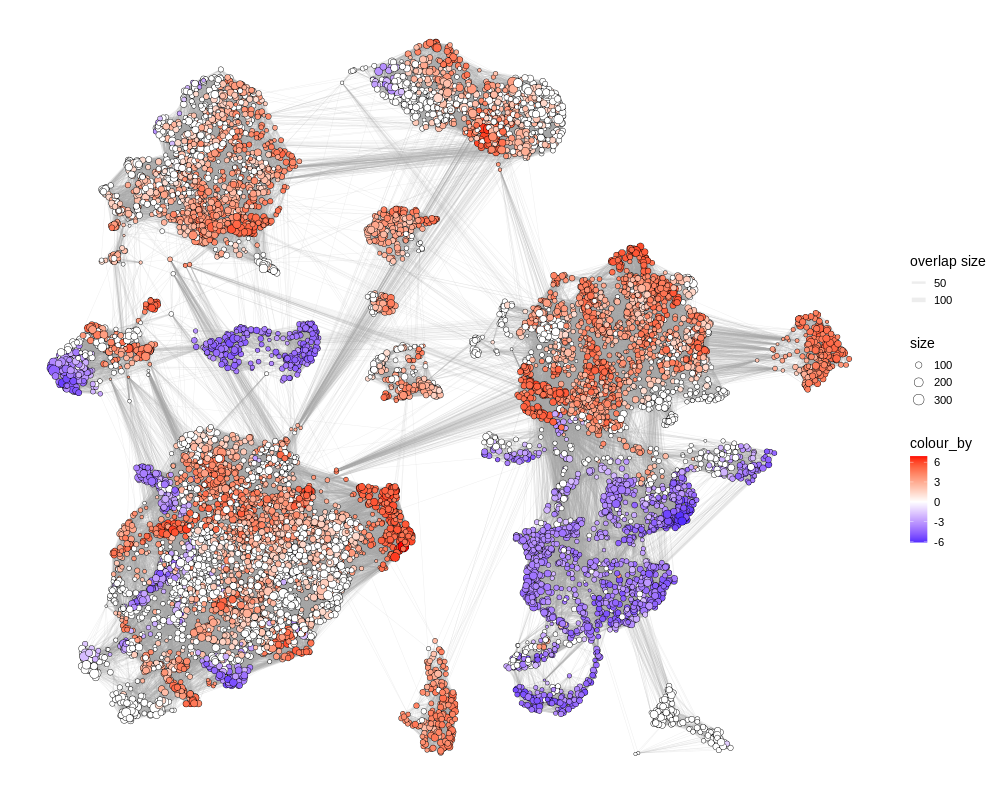

In [123]:
%%R -w 1000 -h 800
g <- plotNhoodGraphDA(milo, DA_results, alpha=0.05, res_column='logFC', layout='UMAP')
g +scale_size_continuous(range = c(1,5))  + scale_fill_gradient2(low = 'blue', mid = 'white', high = 'red',
                        )

#this attempt to change color did not work:
#g+scale_color_gradient(low="blue", high="red")
#mid<-mean(milo$logFC)
#g + scale_color_gradient2(midpoint=mid, low="blue", mid="white",
                #     high="red", space ="Lab" )

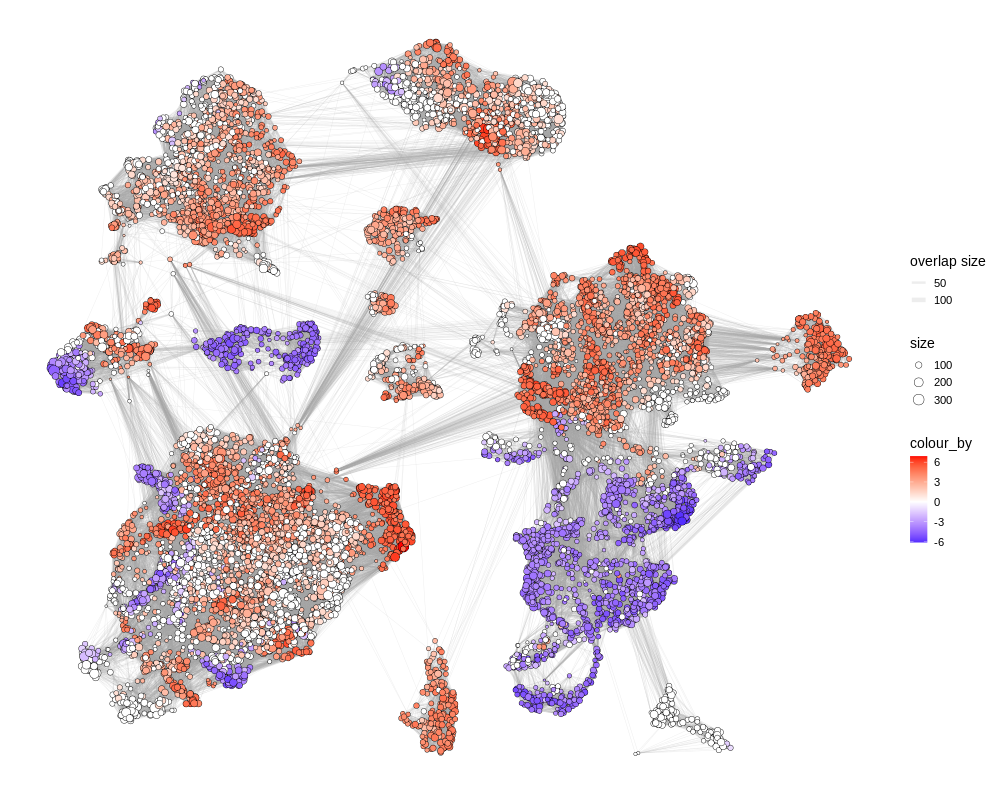

In [124]:
%%R -w 1000 -h 800
g <- plotNhoodGraphDA(milo, DA_results, alpha=0.1, res_column='logFC', layout='UMAP')
g +scale_size_continuous(range = c(1,5))  + scale_fill_gradient2(low = 'blue', mid = 'white', high = 'red',
                        )

#this attempt to change color did not work:
#g+scale_color_gradient(low="blue", high="red")
#mid<-mean(milo$logFC)
#g + scale_color_gradient2(midpoint=mid, low="blue", mid="white",
                #     high="red", space ="Lab" )

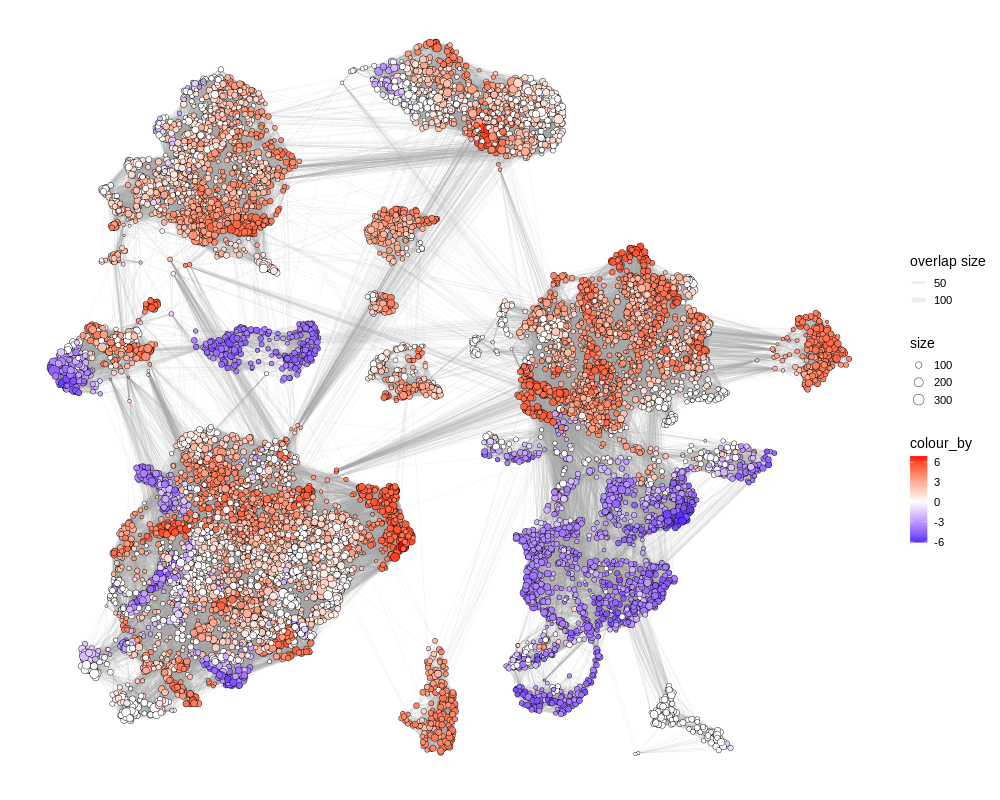

In [125]:
%%R -w 1000 -h 800
g <- plotNhoodGraphDA(milo, DA_results, alpha=0.2, res_column='logFC', layout='UMAP')
g +scale_size_continuous(range = c(1,5))  + scale_fill_gradient2(low = 'blue', mid = 'white', high = 'red',
                        )

#this attempt to change color did not work:
#g+scale_color_gradient(low="blue", high="red")
#mid<-mean(milo$logFC)
#g + scale_color_gradient2(midpoint=mid, low="blue", mid="white",
                #     high="red", space ="Lab" )

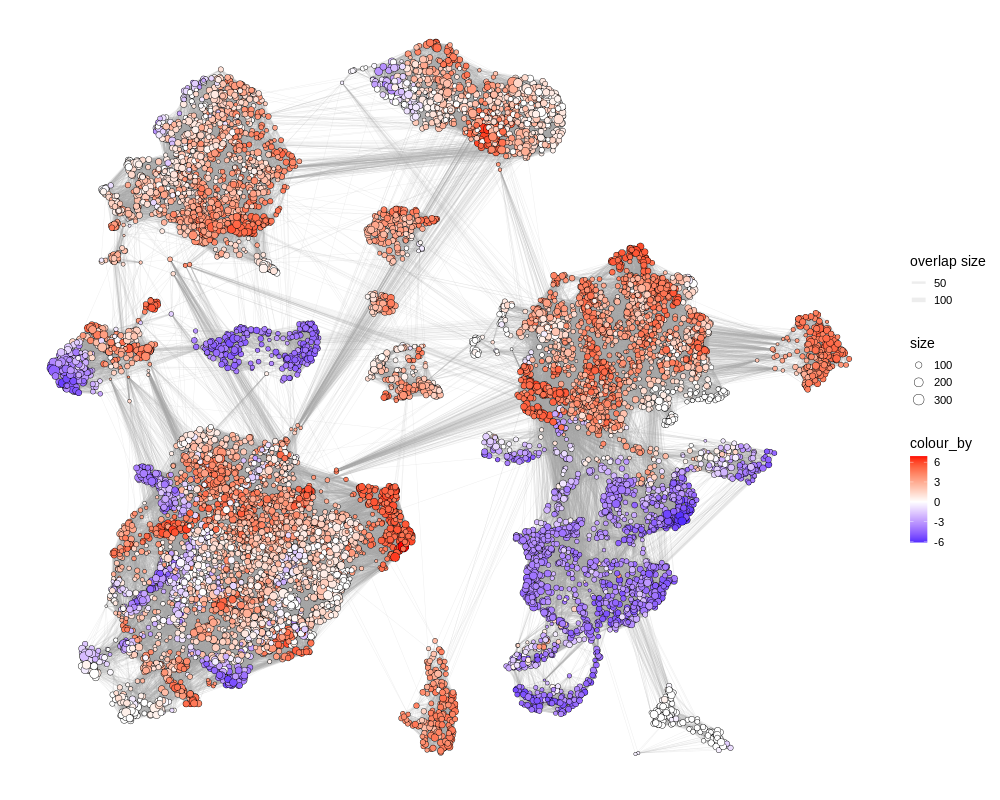

In [126]:
%%R -w 1000 -h 800
g <- plotNhoodGraphDA(milo, DA_results, alpha=1, res_column='logFC', layout='UMAP')
g +scale_size_continuous(range = c(1,5))  + scale_fill_gradient2(low = 'blue', mid = 'white', high = 'red',
                        )

#this attempt to change color did not work:
#g+scale_color_gradient(low="blue", high="red")
#mid<-mean(milo$logFC)
#g + scale_color_gradient2(midpoint=mid, low="blue", mid="white",
                #     high="red", space ="Lab" )

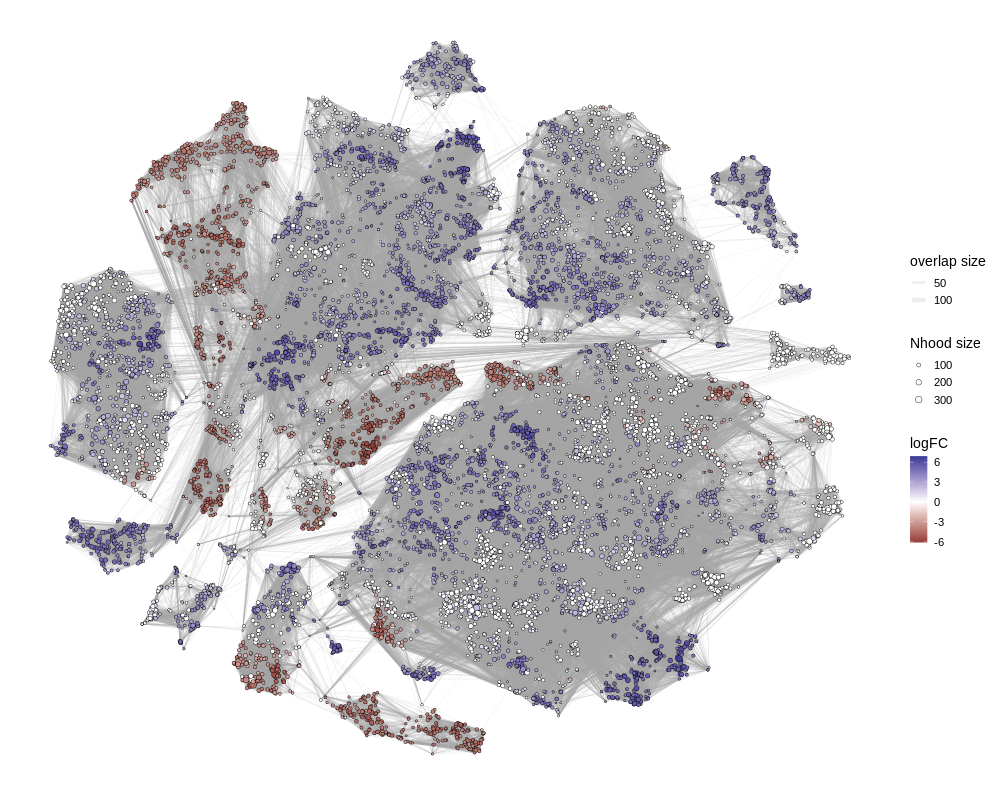

In [127]:
%%R -w 1000 -h 800
g <- plotNhoodGraphDA(milo, DA_results, alpha=0.05, res_column='logFC', layout='TSNE') #+ scale_color_gradient() use ggplot
g

#this attempt to change color did not work:
#g+scale_color_gradient(low="blue", high="red")
#mid<-mean(milo$logFC)
#g + scale_color_gradient2(midpoint=mid, low="blue", mid="white",
                #     high="red", space ="Lab" )

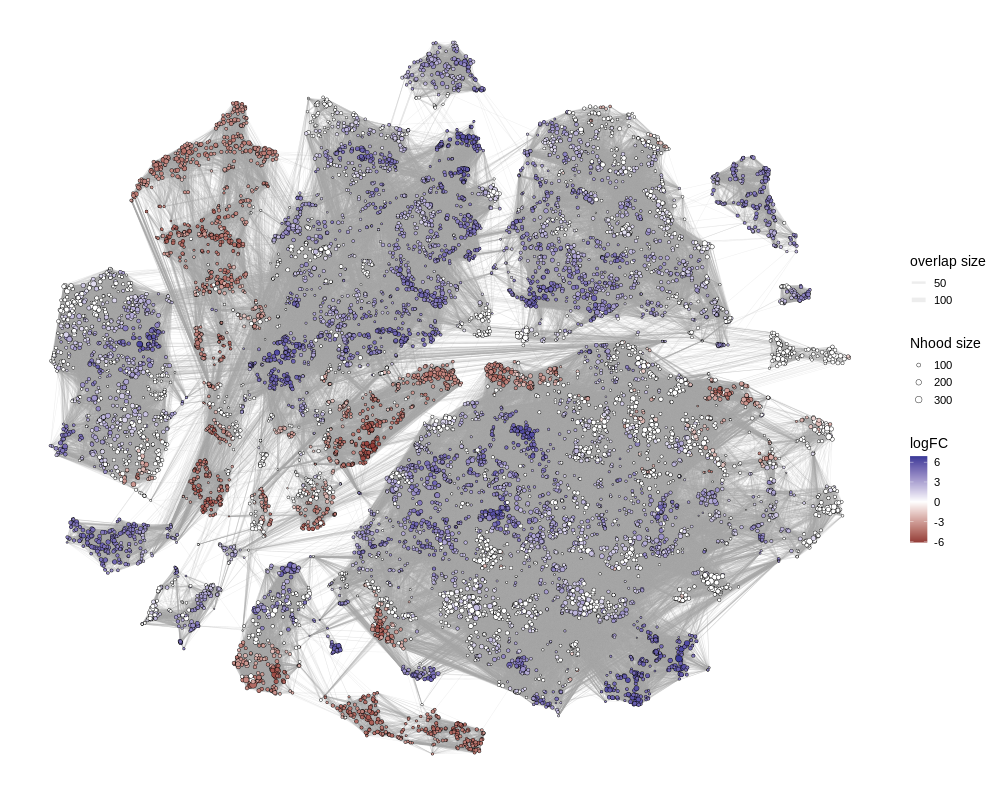

In [128]:
%%R -w 1000 -h 800
g <- plotNhoodGraphDA(milo, DA_results, alpha=0.1, res_column='logFC', layout='TSNE') #+ scale_color_gradient() use ggplot
g

#this attempt to change color did not work:
#g+scale_color_gradient(low="blue", high="red")
#mid<-mean(milo$logFC)
#g + scale_color_gradient2(midpoint=mid, low="blue", mid="white",
                #     high="red", space ="Lab" )

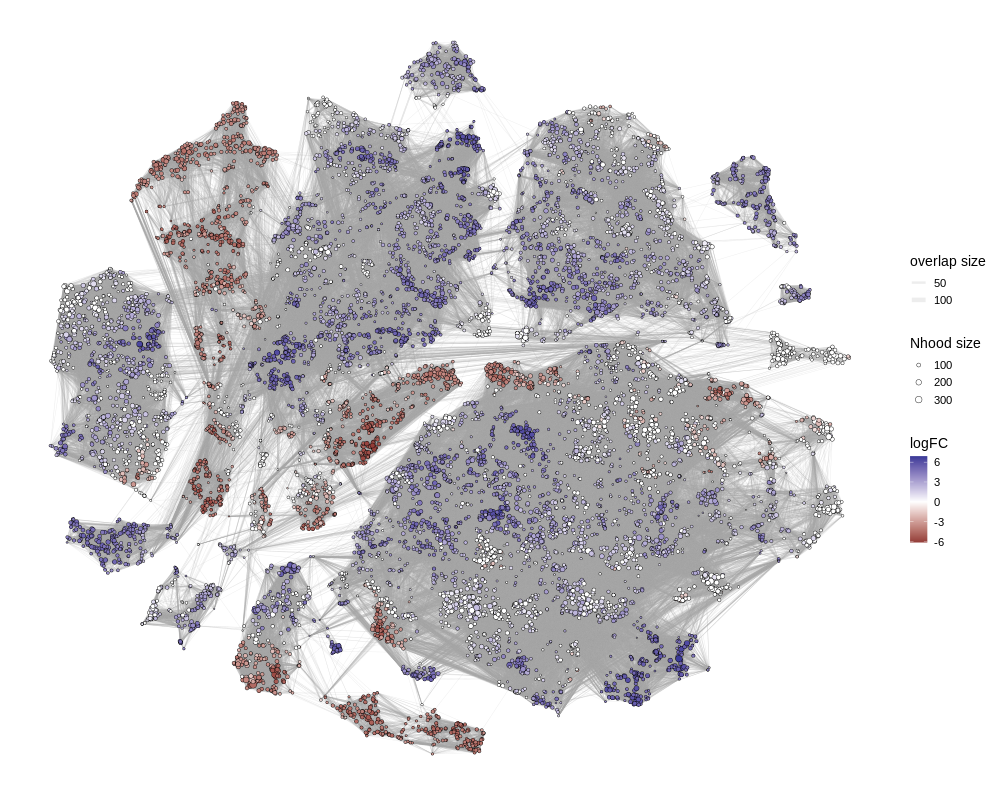

In [129]:
%%R -w 1000 -h 800
g <- plotNhoodGraphDA(milo, DA_results, alpha=0.2, res_column='logFC', layout='TSNE') #+ scale_color_gradient() use ggplot
g

#this attempt to change color did not work:
#g+scale_color_gradient(low="blue", high="red")
#mid<-mean(milo$logFC)
#g + scale_color_gradient2(midpoint=mid, low="blue", mid="white",
                #     high="red", space ="Lab" )

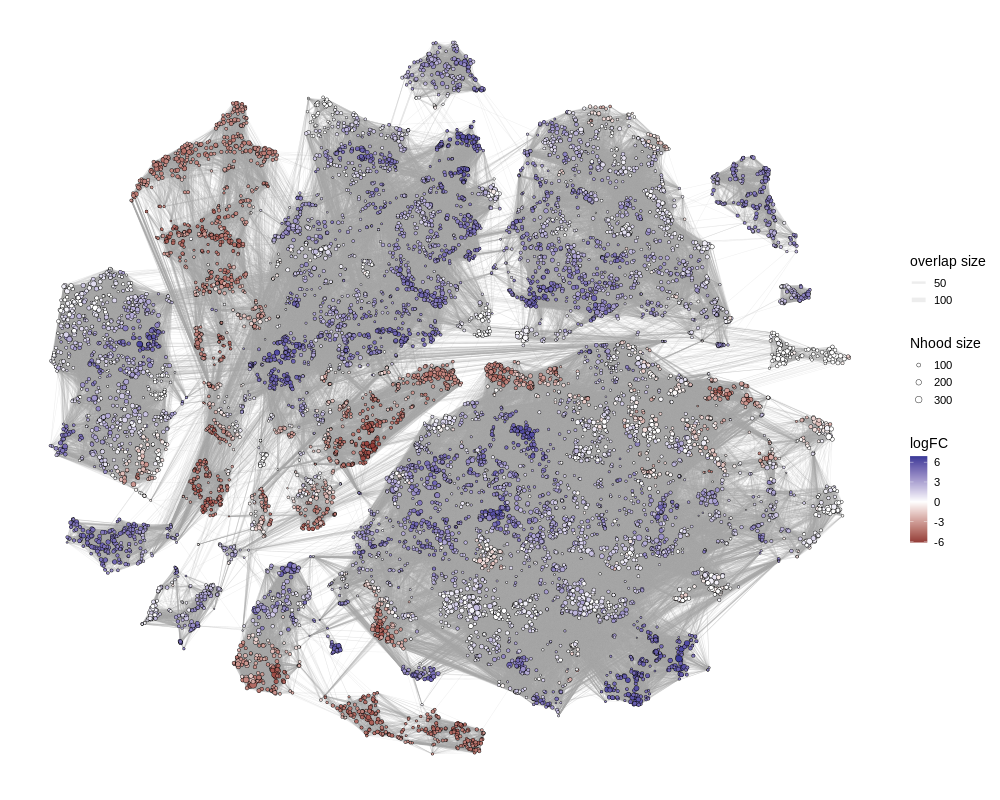

In [130]:
%%R -w 1000 -h 800
g <- plotNhoodGraphDA(milo, DA_results, alpha=1, res_column='logFC', layout='TSNE') #+ scale_color_gradient() use ggplot
g

#this attempt to change color did not work:
#g+scale_color_gradient(low="blue", high="red")
#mid<-mean(milo$logFC)
#g + scale_color_gradient2(midpoint=mid, low="blue", mid="white",
                #     high="red", space ="Lab" )

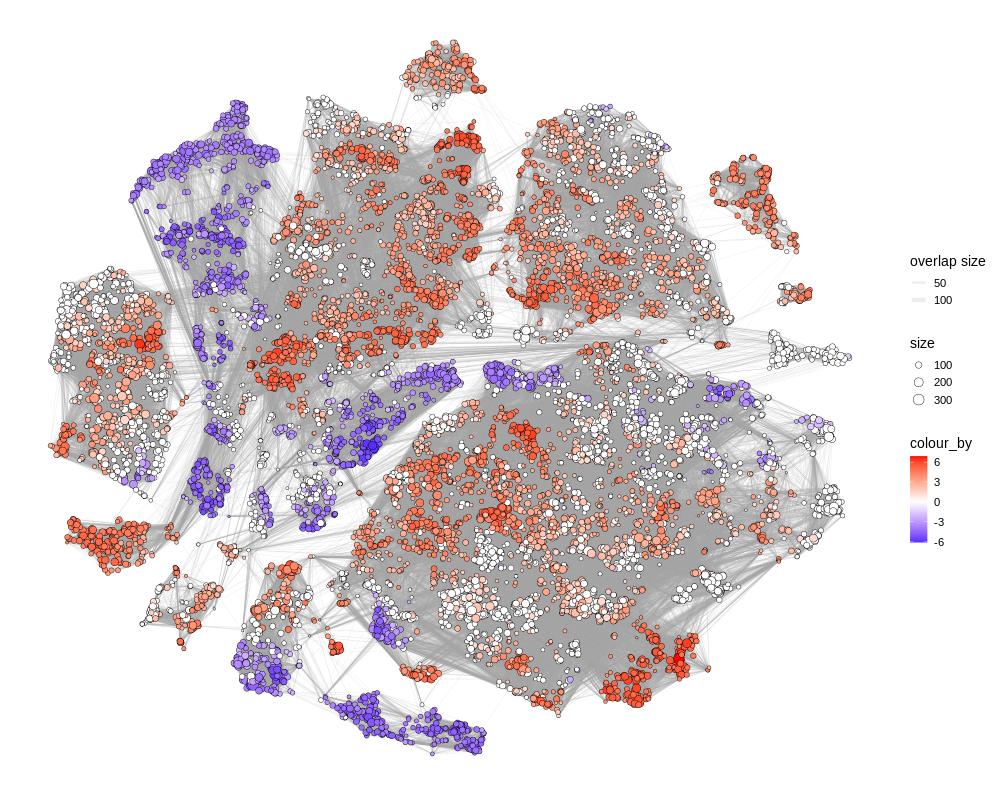

In [131]:
%%R -w 1000 -h 800
g <- plotNhoodGraphDA(milo, DA_results, alpha=0.05, res_column='logFC', layout='TSNE') #+ scale_color_gradient() use ggplot
g +scale_size_continuous(range = c(1,5))  + scale_fill_gradient2(low = 'blue', mid = 'white', high = 'red',
                        )


#this attempt to change color did not work:
#g+scale_color_gradient(low="blue", high="red")
#mid<-mean(milo$logFC)
#g + scale_color_gradient2(midpoint=mid, low="blue", mid="white",
                #     high="red", space ="Lab" )

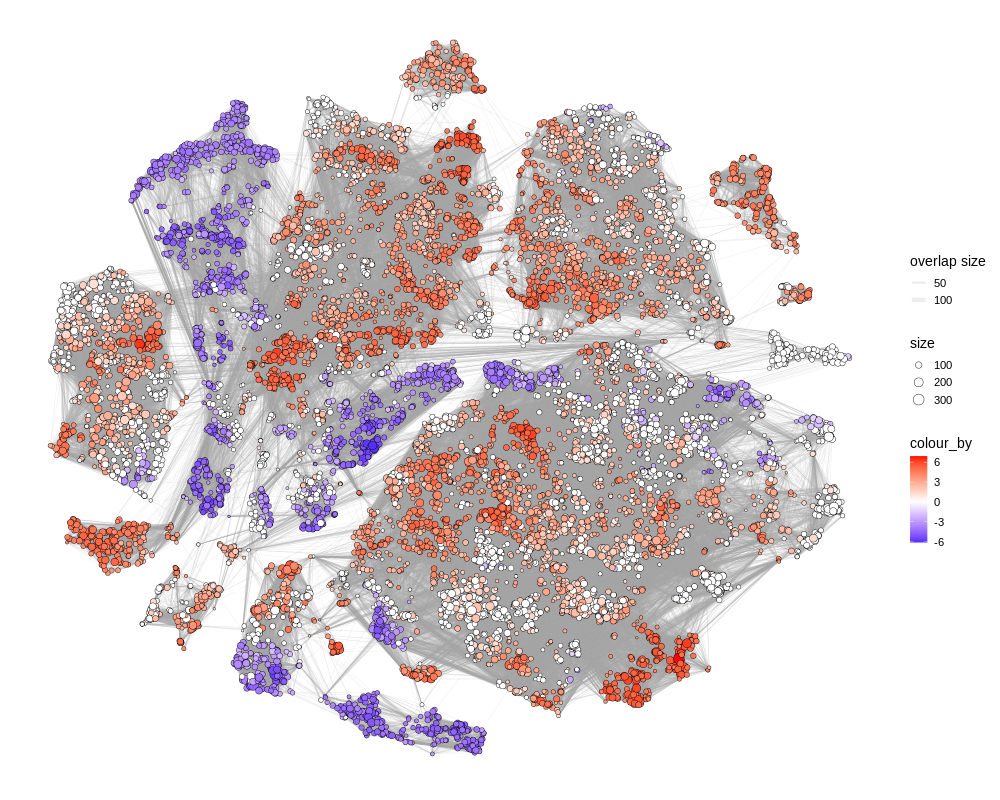

In [132]:
%%R -w 1000 -h 800
g <- plotNhoodGraphDA(milo, DA_results, alpha=0.1, res_column='logFC', layout='TSNE') #+ scale_color_gradient() use ggplot
g +scale_size_continuous(range = c(1,5))  + scale_fill_gradient2(low = 'blue', mid = 'white', high = 'red',
                        )


#this attempt to change color did not work:
#g+scale_color_gradient(low="blue", high="red")
#mid<-mean(milo$logFC)
#g + scale_color_gradient2(midpoint=mid, low="blue", mid="white",
                #     high="red", space ="Lab" )

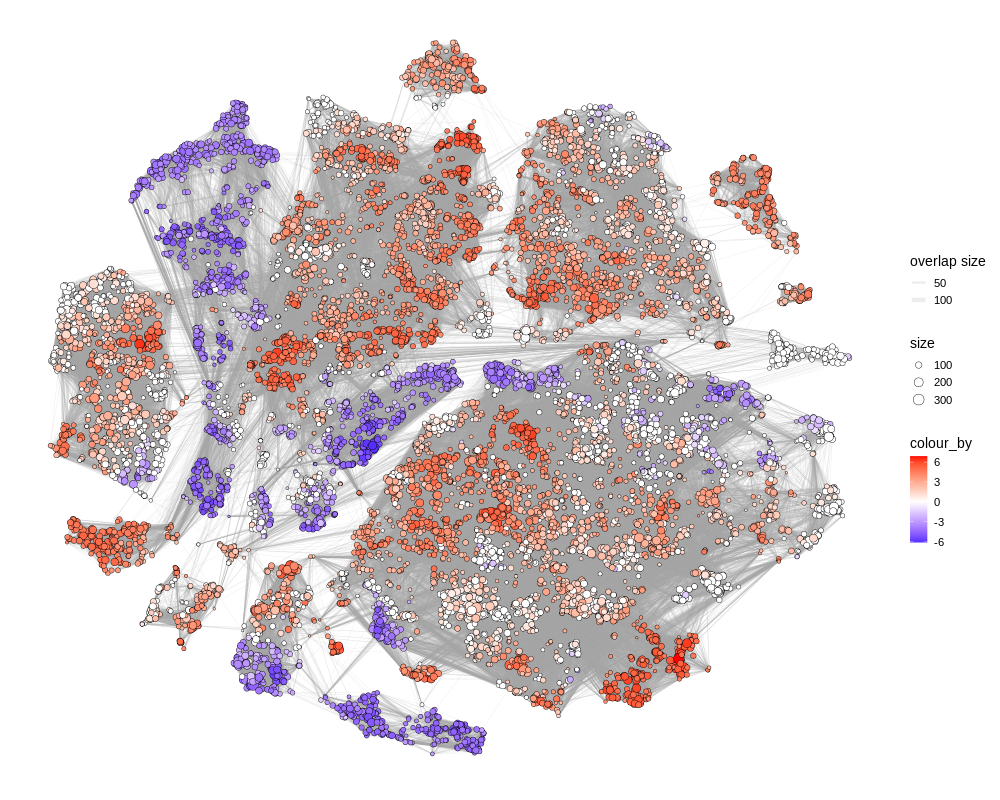

In [133]:
%%R -w 1000 -h 800
g <- plotNhoodGraphDA(milo, DA_results, alpha=0.2, res_column='logFC', layout='TSNE') #+ scale_color_gradient() use ggplot
g +scale_size_continuous(range = c(1,5))  + scale_fill_gradient2(low = 'blue', mid = 'white', high = 'red',
                        )


#this attempt to change color did not work:
#g+scale_color_gradient(low="blue", high="red")
#mid<-mean(milo$logFC)
#g + scale_color_gradient2(midpoint=mid, low="blue", mid="white",
                #     high="red", space ="Lab" )

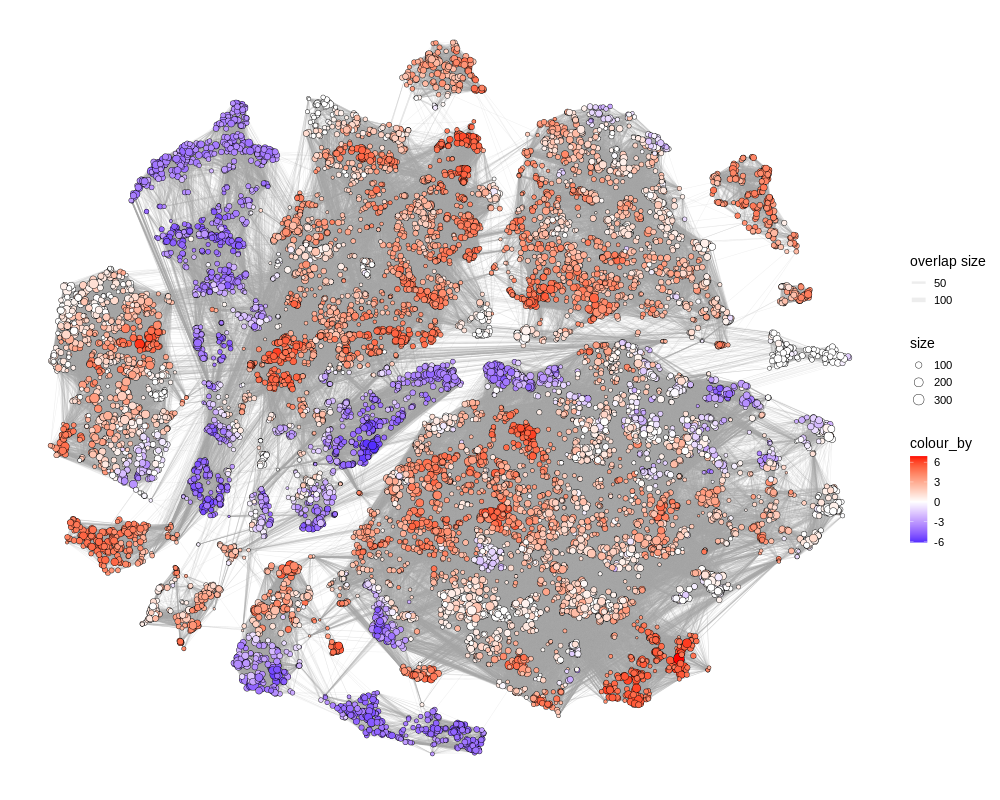

In [134]:
%%R -w 1000 -h 800
g <- plotNhoodGraphDA(milo, DA_results, alpha=1, res_column='logFC', layout='TSNE') #+ scale_color_gradient() use ggplot
g +scale_size_continuous(range = c(1,5))  + scale_fill_gradient2(low = 'blue', mid = 'white', high = 'red',
                        )


#this attempt to change color did not work:
#g+scale_color_gradient(low="blue", high="red")
#mid<-mean(milo$logFC)
#g + scale_color_gradient2(midpoint=mid, low="blue", mid="white",
                #     high="red", space ="Lab" )

Otherwise, If you can't take any more R, then you can make an `anndata` object for the neighbourhoods, storing the abstracted graph in the `obsp` slot.
<-- comment TW I didn't find this very helpful bc it doesnt give you the assignment which cells belong to which neighborhood. We'll extract this info below

In [135]:
%%R -o nhood_graph
## Save the adjacency matrix of the nhood graph
nhood_graph = as_adjacency_matrix(nhoodGraph(milo), attr="weight")

In [136]:
%%R -o nhood_graph_indices

##save the indices of the adjacency matrix

nhood_graph_indices = names(nhoodDistances(milo))

In [137]:
%%R -o nh_umap_df
## Save the positions in UMAP of nhood indices
nh_umap_df = reducedDim(milo, "UMAP")[unlist(nhoodIndex(milo)),]
nh_tsne_df = reducedDim(milo, "TSNE")[unlist(nhoodIndex(milo)),]

In [138]:
%%R -o nh_tsne_df
## Save the positions in tsne of nhood indices
nh_tsne_df = reducedDim(milo, "TSNE")[unlist(nhoodIndex(milo)),]

In [139]:
nhood_adata = anndata.AnnData(obs = DA_results)
nhood_adata

AnnData object with n_obs × n_vars = 10359 × 0
    obs: 'logFC', 'logCPM', 'F', 'PValue', 'FDR', 'Nhood', 'SpatialFDR'

In [140]:
## Add graph
nhood_graph_conn = nhood_graph.copy()
nhood_graph_conn[nhood_graph_conn > 1] = 1 
nhood_adata.obs_names = nhood_graph_indices
nhood_adata.uns["neighbors"] = {}
nhood_adata.obsp['distances'] = nhood_graph
nhood_adata.uns['neighbors']["distances"] = nhood_graph
nhood_adata.obsp['connectivities'] = nhood_graph_conn
nhood_adata.uns['neighbors']["connectivities"] = nhood_graph_conn

/scratch/lsftmp/13065915.tmpdir/ipykernel_808085/725290890.py:7: FutureWarning: This location for 'distances' is deprecated. It has been moved to .obsp[distances], and will not be accesible here in a future version of anndata.
  nhood_adata.uns['neighbors']["distances"] = nhood_graph
/scratch/lsftmp/13065915.tmpdir/ipykernel_808085/725290890.py:9: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  nhood_adata.uns['neighbors']["connectivities"] = nhood_graph_conn


In [141]:
## Add umap positions
nhood_adata.obsm["X_umap"] = nh_umap_df
nhood_adata.obsm["X_tsne"] = nh_tsne_df

In [142]:
adata_neigh_save_path

'/data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/2021-10-06_All_Samples_Filtering_Filtered_clustered_nodrops_10000hv_annotated_AMepi_mappedlabels_clean_220818_PvsAN_withnorm_frommatrices_221207_neigh_unpaired.h5ad'

In [143]:
#save data
nhood_adata.write(adata_neigh_save_path)
print('saved data to:',adata_neigh_save_path)

saved data to: /data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/2021-10-06_All_Samples_Filtering_Filtered_clustered_nodrops_10000hv_annotated_AMepi_mappedlabels_clean_220818_PvsAN_withnorm_frommatrices_221207_neigh_unpaired.h5ad


Then you can use scanpy functions for visualization

In [144]:
adata.obs['site'] = pd.Categorical(adata.obs['site'])

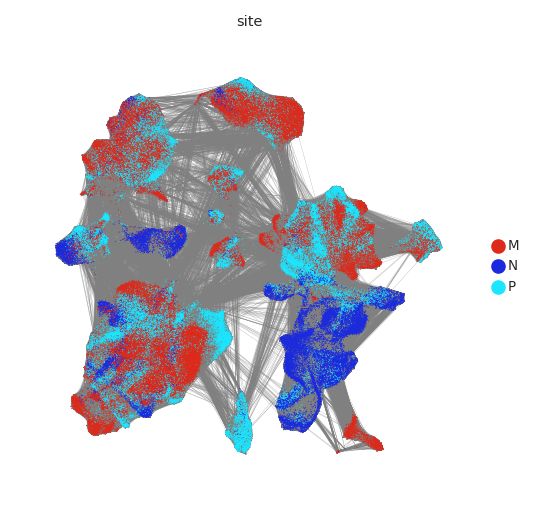

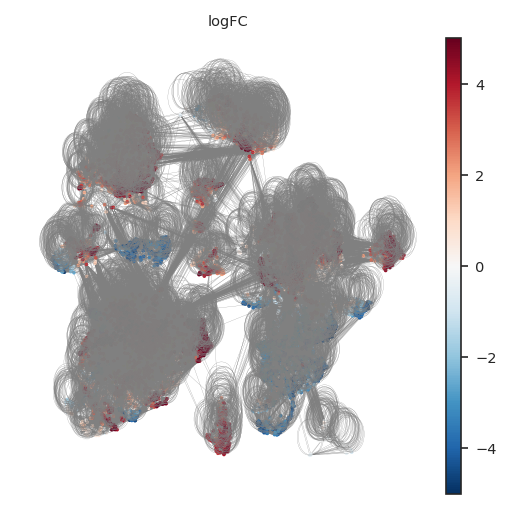

In [145]:
sc.pl.umap(adata, color="site", edges=True, edges_width=0.1, edges_color='grey',palette=blue_red,
                                                                                 save='primary_met_neighborhoods.svg')
sc.pl.umap(nhood_adata, color="logFC", cmap='RdBu_r', vmax=5, vmin=-5, edges=True, edges_width=0.1, edges_color='grey',
          save='primary_met_neighborhoods_foldchange.svg')

# We can color only significant nhoods

In [146]:
nhood_adata.obs["logFC_signif"] = nhood_adata.obs["logFC"]
nhood_adata.obs["logFC_signif"][nhood_adata.obs["SpatialFDR"] > 0.05] = 0

In [147]:
#create dictionary linking logFC to neighborhood ids
fc_dict = nhood_adata.obs['logFC'].to_dict()
fc_dict

{'43635': 1.5434293773283116,
 '51848': 2.8861866084147327,
 '79568': 6.744814688981509,
 '40941': 0.2935602618315529,
 '35696': -3.2261669320594994,
 '114621': -2.562741203051934e-15,
 '80435': 3.554964544568907,
 '125959': 5.439218414119245,
 '124168': -2.9362066551843475,
 '62034': 3.183760896464584,
 '123485': -3.9142714239740033,
 '6392': 3.0095576557808585,
 '64702': 3.1402395675467654,
 '5188': 4.849234120663263,
 '15068': 0.04613804776989111,
 '108594': 4.212957079158461,
 '12176': 0.3817546960660602,
 '32847': 2.44376058758906,
 '11907': 2.0483090561728035,
 '117749': 4.922057607026894,
 '137970': -3.8688292949805714,
 '103628': -0.42279160578727876,
 '114542': 3.7326074822319266,
 '52699': -4.158851979793729,
 '79088': 0.759429577889721,
 '35097': 4.113877302364584,
 '118415': 3.814151189580108,
 '9847': 4.303825644496679,
 '113130': 2.4500971222261114,
 '103315': -2.562741203051934e-15,
 '133523': 3.163552308214577,
 '33584': 1.7058798570819145,
 '10023': 3.924349675171898,


In [148]:
#create dictionary linking FDR to neighborhood ids
fdr_dict = nhood_adata.obs['SpatialFDR'].to_dict()
fdr_dict

{'43635': 0.11789160921549055,
 '51848': 0.022459385556041832,
 '79568': 1.4679556282704943e-05,
 '40941': 0.26738894127812246,
 '35696': 0.0012401341094223316,
 '114621': 1.0,
 '80435': 1.2774124313529734e-05,
 '125959': 1.5283831525980486e-05,
 '124168': 0.0024384280994451477,
 '62034': 0.0006375469828091147,
 '123485': 1.392575116530037e-05,
 '6392': 0.01379139597234689,
 '64702': 0.002521080124365037,
 '5188': 1.25365008048392e-05,
 '15068': 1.0,
 '108594': 1.0754454726517243e-05,
 '12176': 0.66356802838861,
 '32847': 0.10411518224300195,
 '11907': 0.0027019059691584706,
 '117749': 1.3139100590376678e-05,
 '137970': 1.4831521111346408e-06,
 '103628': 0.28308053428174446,
 '114542': 1.116111212930907e-05,
 '52699': 1.9043161009558246e-05,
 '79088': 0.32438220993004907,
 '35097': 1.0754454726517243e-05,
 '118415': 0.00011730153074320895,
 '9847': 1.0754454726517243e-05,
 '113130': 8.306532731840811e-05,
 '103315': 1.0,
 '133523': 2.4835566543570587e-05,
 '33584': 0.013827391043072021

## extract neighborhood -> cell mapping from R

save adjacency matrices for each neighborhood to individual csv files. The name is the index of the neighbor-
hood. 

In [149]:
%%R

for(i in 1:length(nhoodDistances(milo))) {
  write.csv(as.matrix(nhoodDistances(milo)[[i]]),
            paste0(OUT_RESULT_DIR,'milo.nhoodDistances_',names(nhoodDistances(milo)[i]),'.csv'))
}


here you see the real names of the milo neighborhoods

In [150]:
%%R
names(nhoodDistances(milo))

    [1] "43635"  "51848"  "79568"  "40941"  "35696"  "114621" "80435"  "125959"
    [9] "124168" "62034"  "123485" "6392"   "64702"  "5188"   "15068"  "108594"
   [17] "12176"  "32847"  "11907"  "117749" "137970" "103628" "114542" "52699" 
   [25] "79088"  "35097"  "118415" "9847"   "113130" "103315" "133523" "33584" 
   [33] "10023"  "70085"  "85900"  "106209" "139012" "125010" "63711"  "126248"
   [41] "96971"  "24608"  "64440"  "59490"  "119141" "133049" "43141"  "138158"
   [49] "88232"  "128210" "28134"  "122968" "35459"  "45174"  "2440"   "127648"
   [57] "108129" "126050" "131164" "57825"  "112215" "128215" "72565"  "125266"
   [65] "88426"  "67686"  "62721"  "59887"  "56013"  "127419" "52317"  "107252"
   [73] "135030" "100878" "105361" "116437" "131752" "59746"  "16332"  "35282" 
   [81] "39385"  "28759"  "62791"  "61633"  "47438"  "61270"  "66934"  "20391" 
   [89] "23024"  "128844" "21948"  "108923" "35545"  "85613"  "77845"  "99897" 
   [97] "25682"  "41906"  "60840"  "9903

 [1633] "23356"  "91189"  "38949"  "92430"  "117966" "103475" "72673"  "39031" 
 [1641] "115358" "784"    "102277" "43699"  "47036"  "124852" "2897"   "119793"
 [1649] "9264"   "12850"  "106501" "39028"  "17359"  "47084"  "77528"  "26004" 
 [1657] "73406"  "74473"  "129830" "20509"  "6564"   "113213" "43930"  "41812" 
 [1665] "18703"  "124442" "65472"  "124015" "42910"  "11020"  "76154"  "116442"
 [1673] "12187"  "106868" "126741" "105242" "71324"  "34085"  "101816" "90219" 
 [1681] "132812" "49053"  "33814"  "67632"  "2659"   "6450"   "20074"  "98103" 
 [1689] "84684"  "61837"  "15811"  "71514"  "136353" "75367"  "18425"  "23655" 
 [1697] "84003"  "77891"  "64901"  "78584"  "96512"  "36230"  "24974"  "86603" 
 [1705] "48721"  "29503"  "30895"  "124949" "96455"  "40508"  "78450"  "35513" 
 [1713] "72512"  "59637"  "129333" "85872"  "57967"  "132907" "61778"  "8504"  
 [1721] "119510" "130987" "106957" "138090" "18815"  "109027" "127343" "9309"  
 [1729] "136546" "130168" "57495"  "1075

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 "92773" 
 [5457] "62028"  "9459"   "47260"  "59941"  "53484"  "122029" "54597"  "36099" 
 [5465] "83860"  "115003" "130376" "54598"  "44814"  "1024"   "112839" "58411" 
 [5473] "46801"  "96790"  "12640"  "123342" "4381"   "5556"   "108914" "55761" 
 [5481] "380"    "14509"  "13483"  "77606"  "130171" "39427"  "15310"  "94098" 
 [5489] "53896"  "133458" "134633" "124346" "12936"  "12480"  "120978" "48857" 
 [5497] "99245"  "139915" "16988"  "75541"  "87252"  "61326"  "59440"  "75985" 
 [5505] "41455"  "43942"  "105220" "111387" "45154"  "121655" "38313"  "112847"
 [5513] "115389" "104522" "94972"  "135439" "11009"  "1022"   "62317"  "87027" 
 [5521] "2566"   "69992"  "81905"  "10898"  "45524"  "56293"  "120346" "90517" 
 [5529] "54238"  "58939"  "10971"  "49217"  "78296"  "77181"  "43185"  "108462"
 [5537] "10695"  "64630"  "30376"  "134147" "15507"  "42941"  "42227"  "11216" 
 [5545] "4692"   "16747"  "128392" "56995"  "130455" "39076"  "104589" "127700"
 [5553] "74466"  "66061"  "651

 [7089] "11637"  "82448"  "115090" "20142"  "57548"  "134069" "139622" "86999" 
 [7097] "22012"  "20121"  "43500"  "133180" "65148"  "15180"  "25654"  "27611" 
 [7105] "69505"  "47940"  "24382"  "133546" "70397"  "91914"  "5840"   "66030" 
 [7113] "56677"  "29258"  "133949" "92228"  "58268"  "88517"  "10113"  "54874" 
 [7121] "122915" "33114"  "121946" "13269"  "116351" "30068"  "110536" "74"    
 [7129] "130035" "89646"  "71529"  "94969"  "1932"   "75664"  "118214" "134870"
 [7137] "16642"  "46875"  "119385" "12779"  "27084"  "51989"  "4292"   "44442" 
 [7145] "85398"  "129712" "85027"  "6272"   "63934"  "100308" "38280"  "26910" 
 [7153] "55489"  "71556"  "95443"  "136797" "107376" "52027"  "8244"   "124507"
 [7161] "2"      "26555"  "47015"  "84517"  "136010" "80448"  "77687"  "37404" 
 [7169] "63077"  "95162"  "130675" "69932"  "70739"  "51028"  "139475" "105007"
 [7177] "16581"  "53322"  "17972"  "111293" "75029"  "92497"  "124318" "86036" 
 [7185] "37737"  "50644"  "118781" "1361

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [151]:
%%R
print(OUT_RESULT_DIR)

[1] "/data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/milo_PvsAN_allandnorm_221207/"


In [152]:
nhood_adata

AnnData object with n_obs × n_vars = 10359 × 0
    obs: 'logFC', 'logCPM', 'F', 'PValue', 'FDR', 'Nhood', 'SpatialFDR', 'logFC_signif'
    uns: 'neighbors'
    obsm: 'X_umap', 'X_tsne'
    obsp: 'distances', 'connectivities'

In [153]:
#identify significant neighborhoods
sign_neighborhood = nhood_adata.obs.sort_values('logFC',ascending=False) #[nhood_adata.obs['FDR']<1]
rel_fold_neighborhood = sign_neighborhood#[sign_neighborhood['logFC']<100000000000000000]
sign_neighborhood_indices = list(rel_fold_neighborhood.index)
print(len(sign_neighborhood_indices),'neighborhoods are significantly differentially abundant:')
sign_neighborhood_indices

10359 neighborhoods are significantly differentially abundant:


['62721',
 '79568',
 '71947',
 '13263',
 '65209',
 '82503',
 '101816',
 '65808',
 '39205',
 '64878',
 '91915',
 '84279',
 '35918',
 '5271',
 '34470',
 '75695',
 '81629',
 '12096',
 '223',
 '62018',
 '48159',
 '44778',
 '95035',
 '91704',
 '13104',
 '80961',
 '24777',
 '14861',
 '30507',
 '27919',
 '56981',
 '18111',
 '94989',
 '30356',
 '38468',
 '380',
 '95517',
 '45349',
 '95562',
 '72441',
 '67491',
 '95246',
 '94680',
 '26792',
 '4545',
 '129751',
 '48893',
 '60750',
 '23418',
 '4173',
 '14540',
 '59189',
 '66914',
 '34657',
 '12834',
 '76902',
 '32873',
 '65503',
 '90213',
 '21679',
 '26378',
 '95437',
 '46949',
 '7556',
 '53324',
 '59296',
 '101062',
 '94635',
 '63130',
 '18701',
 '72276',
 '82816',
 '55458',
 '130187',
 '74766',
 '67305',
 '40619',
 '29601',
 '129807',
 '15669',
 '40559',
 '58969',
 '95150',
 '67272',
 '49393',
 '46260',
 '22850',
 '15980',
 '507',
 '39475',
 '100817',
 '44493',
 '9291',
 '89139',
 '125966',
 '94452',
 '101534',
 '95055',
 '38819',
 '66938',
 '1

In [154]:
#load adjacency matrices for significant neighborhoods storing cell indices per neighborhood index
neighborhood_cell_dict = {}
for i in sign_neighborhood_indices:
    sig_neighborhood_path = OUT_RESULT_DIR + 'milo.nhoodDistances_'+ i+ '.csv'
    sig_neighborhood = pd.read_csv(sig_neighborhood_path,index_col=0)
    sig_neighborhood_cell_indices = list(sig_neighborhood.index)
    neighborhood_cell_dict[i] = sig_neighborhood_cell_indices
neighborhood_cell_dict

#len dict
cell_neighborhood_dict_len = {}
for k,v in neighborhood_cell_dict.items():
    cell_neighborhood_dict_len[k]= len(v)

#add to adata.obs
adata.obs['milo_M_vs_P_all_neighborhoods'] = pd.Categorical(adata.obs_names.map(neighborhood_cell_dict))
adata

adata.obs['milo_M_vs_P_all_neighborhoods'].value_counts()

#load all adjacency matrices storing cell indices per neighborhood index
neighborhood_cell_dict = {}
for i in set(nhood_adata.obs_names):
    sig_neighborhood_path = OUT_RESULT_DIR + 'milo.nhoodDistances_'+ i+ '.csv'
    sig_neighborhood = pd.read_csv(sig_neighborhood_path,index_col=0)
    sig_neighborhood_cell_indices = list(sig_neighborhood.index)
    neighborhood_cell_dict_neighborhood = dict(zip(sig_neighborhood_cell_indices, len(sig_neighborhood_cell_indices)*[i]))
    neighborhood_cell_dict.update(neighborhood_cell_dict_neighborhood)

#add to adata.obs
adata.obs['milo_M_vs_P_sig_neighborhoods'] = pd.Categorical(adata.obs_names.map(neighborhood_cell_dict))
adata

fc_dict

#add fold changes and fdrs
adata.obs['MvsP_neighborhood_fdr'] = adata.obs['milo_M_vs_P_all_neighborhoods'].map(fdr_dict)
adata.obs['MvsP_neighborhood_fc'] = adata.obs['milo_M_vs_P_all_neighborhoods'].map(fc_dict)

adata

set(adata.obs['annotation_SPECTRA_final'])

adata_neigh_save_path

set(adata.obs['annotation_SPECTRA_final'])

adata_subset = adata[adata.obs['annotation_SPECTRA_final'].isin(['(myo)fibroblast',
 'B-GC',
 'B-mem',
 'B-naive',
 'CD4-T',
 'CD8-T',
 'DC',
 'EC',
 'Gr-MDC',
 'ILC3',
 'ISC',
 'Mac',
 'NK',
 'NKT',
 'Treg',
 'crc-cell',
 'enterocytes',
 'enteroendocrine',
 'gdT',
 'goblet',
 'lymphatic_HEC',
 'mast',
 'plasma',
 'schwann',
 'sinusoid',
 'telocyte',
 'tuft'               ])]
plot_df = adata_subset.obs[['MvsP_neighborhood_fc','MvsP_neighborhood_fdr','annotation_SPECTRA_final']]
plot_df.to_csv(adata_neigh_save_path[:-5] + '.csv')
plot_df

In [155]:
adata_neigh_save_path[:-5]  + '.csv'

'/data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/2021-10-06_All_Samples_Filtering_Filtered_clustered_nodrops_10000hv_annotated_AMepi_mappedlabels_clean_220818_PvsAN_withnorm_frommatrices_221207_neigh_unpaired.csv'

plot_df = plot_df[~plot_df['MvsP_neighborhood_fc'].isna()]
plot_df['MvsP_neighborhood_fc'] = plot_df['MvsP_neighborhood_fc'].astype(float)
plot_df

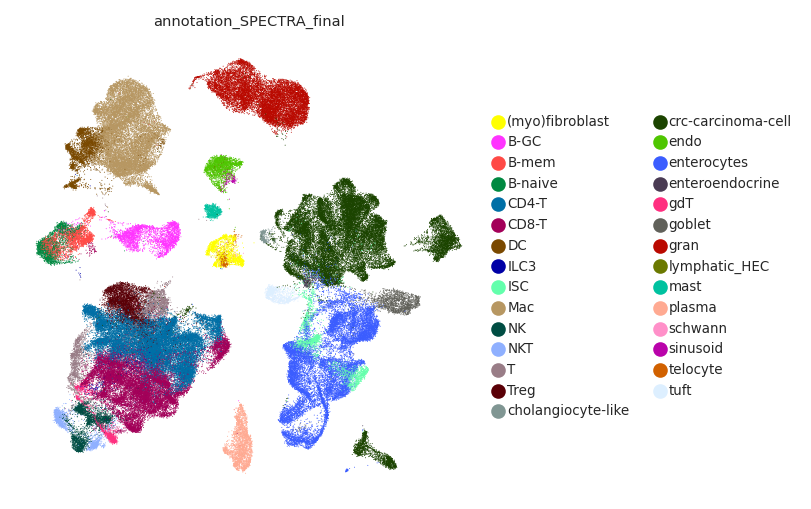

In [156]:
sc.pl.umap(adata, color="annotation_SPECTRA_final",palette = color_map_clusters_nogrey)


import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})
figsave_complete = DATA_DIR+'allcellsfold.svg'

# Initialize the FacetGrid object
pal = sns.cubehelix_palette(10, rot=-.25, light=.7)
g = sns.FacetGrid(plot_df, row="annotation_SPECTRA_final", hue="annotation_SPECTRA_final", aspect=15, height=.5, palette=pal)

# Draw the densities in a few steps
g.map(sns.kdeplot, "MvsP_neighborhood_fc",
      bw_adjust=.5, clip_on=False,
      fill=True, alpha=1, linewidth=1.5)
g.map(sns.kdeplot, "MvsP_neighborhood_fc", clip_on=False, color="w", lw=2, bw_adjust=.5)

# passing color=None to refline() uses the hue mapping
g.refline(y=0, linewidth=2, linestyle="-", color=None, clip_on=False)


# Define and use a simple function to label the plot in axes coordinates
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)


g.map(label, "MvsP_neighborhood_fc")

# Set the subplots to overlap
g.figure.subplots_adjust(hspace=-.25)

# Remove axes details that don't play well with overlap
g.set_titles("")
g.set(yticks=[], ylabel="")
g.despine(bottom=True, left=True)
g.set(xlim=(-6,6))

plt.savefig(figsave_complete)
print('saved figure to',figsave_complete)

In [157]:
#save
adata.write(adata_save_path)
print('adata saved to:', adata_save_path)

adata saved to: /data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/2021-10-06_All_Samples_Filtering_Filtered_clustered_nodrops_10000hv_annotated_AMepi_mappedlabels_clean_220818_PvsAN_withnorm_frommatrices_221207_unpaired.h5ad


plot_df['fc>0']= plot_df['MvsP_neighborhood_fc']>=0
pd.crosstab(plot_df['fc>0'],plot_df['annotation_SPECTRA_final'],normalize='columns')

In [158]:
adata_neigh_save_path

'/data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/2021-10-06_All_Samples_Filtering_Filtered_clustered_nodrops_10000hv_annotated_AMepi_mappedlabels_clean_220818_PvsAN_withnorm_frommatrices_221207_neigh_unpaired.h5ad'

## relplot

In [14]:
#path
#adata_path = '/data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/2021-10-06_All_Samples_Filtering_Filtered_clustered_nodrops_10000hv_annotated_AMepi_mappedlabels_clean_220818_PvsAN_withnorm_frommatrices_221207_unpaired.h5ad'
#adata_nhood_path ='/data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/2021-10-06_All_Samples_Filtering_Filtered_clustered_nodrops_10000hv_annotated_AMepi_mappedlabels_clean_220818_PvsAN_withnorm_frommatrices_221207_neigh_unpaired.h5ad'

#adata_path = '/data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/2021-10-06_All_Samples_Filtering_Filtered_clustered_nodrops_10000hv_annotated_AMepi_mappedlabels_clean_220818_MvsAN_withnorm_frommatrices_221207_unpaired.h5ad'
#adata_nhood_path ='/data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/2021-10-06_All_Samples_Filtering_Filtered_clustered_nodrops_10000hv_annotated_AMepi_mappedlabels_clean_220818_MvsAN_withnorm_frommatrices_221207_neigh_unpaired.h5ad'

adata_path = '/data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/2021-10-06_All_Samples_Filtering_Filtered_clustered_nodrops_10000hv_annotated_AMepi_mappedlabels_clean_220818_MvsP_withnorm_frommatrices_221207_unpaired.h5ad'
adata_nhood_path ='/data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/2021-10-06_All_Samples_Filtering_Filtered_clustered_nodrops_10000hv_annotated_AMepi_mappedlabels_clean_220818_MvsP_withnorm_frommatrices_221207_neigh_unpaired.h5ad'

#name for saving
save_path = 'unpaired_MvsP.svg'
DIR = '/data/peer/wallet/Jupyter/2021_Peer_Ganesh_CRC/data/'
OUT_RESULT_DIR = DIR + 'milo_MvsAN_allandnorm_221207/'

In [15]:
adata = sc.read(adata_path)
adata_nhood = sc.read(adata_nhood_path)

In [16]:
adata

AnnData object with n_obs × n_vars = 140062 × 19897
    obs: 'total_counts', 'Patient', 'Sample ID', 'Sample Type', 'Treatment', 'batch', 'annotation_level_0', 'annotation_level_1', 'annotation_level_2', 'annotation_SPECTRA', 'annotation_SPECTRA_final', 'patient', 'primary-site', 'sample_type', 'treatment', 'tumor-site', 'Female_1', 'Age', 'Right', 'kras_nras', 'MSI-H', 'site', 'sample_id', 'milo_M_vs_P_all_neighborhoods', 'milo_M_vs_P_sig_neighborhoods', 'MvsP_neighborhood_fdr', 'MvsP_neighborhood_fc'
    uns: 'Patient_colors', 'annotation_SPECTRA_final_colors', 'annotation_level_0_colors', 'neighbors', 'pca', 'site_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'imputed'
    obsp: 'connectivities', 'distances'

In [17]:
adata_nhood

AnnData object with n_obs × n_vars = 10359 × 0
    obs: 'logFC', 'logCPM', 'F', 'PValue', 'FDR', 'Nhood', 'SpatialFDR'
    obsm: 'X_tsne', 'X_umap'
    obsp: 'connectivities', 'distances'

In [18]:
#identify significant neighborhoods
sign_neighborhood = adata_nhood.obs.sort_values('logFC',ascending=False) #[adata_neigh_1.obs['FDR']<1]
rel_fold_neighborhood = sign_neighborhood#[sign_neighborhood['logFC']<100000000000000000]
sign_neighborhood_indices = list(rel_fold_neighborhood.index)
print(len(sign_neighborhood_indices),'neighborhoods are significantly differentially abundant:')
sign_neighborhood_indices

10359 neighborhoods are significantly differentially abundant:


['66972',
 '91207',
 '16002',
 '25231',
 '80061',
 '38360',
 '24457',
 '106501',
 '8497',
 '78743',
 '9231',
 '106273',
 '89488',
 '6444',
 '106325',
 '106603',
 '5528',
 '65549',
 '47769',
 '24320',
 '30907',
 '72563',
 '42471',
 '56308',
 '102930',
 '57506',
 '46131',
 '50068',
 '84874',
 '60656',
 '27031',
 '41131',
 '58425',
 '79181',
 '85721',
 '49570',
 '106336',
 '47438',
 '56818',
 '37483',
 '89126',
 '45242',
 '43118',
 '91868',
 '89027',
 '79825',
 '85340',
 '57292',
 '16103',
 '40479',
 '4299',
 '66250',
 '92239',
 '18386',
 '22501',
 '70145',
 '34531',
 '21313',
 '69994',
 '45028',
 '77176',
 '9157',
 '71168',
 '76303',
 '93432',
 '20103',
 '85583',
 '23829',
 '35496',
 '49263',
 '78286',
 '32178',
 '12897',
 '86399',
 '39570',
 '52215',
 '36614',
 '30509',
 '20394',
 '55583',
 '37379',
 '10623',
 '3749',
 '31086',
 '65605',
 '89817',
 '23989',
 '28608',
 '52230',
 '73101',
 '106252',
 '27173',
 '1936',
 '13807',
 '10348',
 '80848',
 '31339',
 '54730',
 '104151',
 '90687',


In [19]:
#load adjacency matrices for significant neighborhoods storing cell indices per neighborhood index
neighborhood_cell_dict = {}
for i in sign_neighborhood_indices:
    sig_neighborhood_path = OUT_RESULT_DIR + 'milo.nhoodDistances_'+ i+ '.csv'
    sig_neighborhood = pd.read_csv(sig_neighborhood_path,index_col=0)
    sig_neighborhood_cell_indices = list(sig_neighborhood.index)
    neighborhood_cell_dict[i] = sig_neighborhood_cell_indices
neighborhood_cell_dict

{'66972': ['129446782101859_KG75M',
  '192739540686693_KG75M',
  '121733813554036_KG75M',
  '126913575573228_KG75M',
  '134405309287718_KG75M',
  '130615012941099_KG75M',
  '165180775217509_KG75M',
  '157697990637939_KG75M',
  '170139199957411_KG75M',
  '231151728741228_KG75M',
  '204772964427510_KG75M',
  '126889116457395_KG75M',
  '126748575320877_KG75M',
  '230749759270179_KG75M',
  '157062500890350_KG75M',
  '134936676682099_KG75M',
  '133924258265373_KG75M',
  '192728937125622_KG75M',
  '200922554030900_KG75M',
  '120847156067619_KG74M',
  '195536652745637_KG75M',
  '169175082483043_KG75M',
  '199807057979756_KG75M',
  '192197480834987_KG75M',
  '192265751743211_KG75M',
  '134515783002421_KG75M',
  '192739567684381_KG75M',
  '133906824842084_KG75M',
  '227499945974683_KG75M',
  '155973324560243_KG75M',
  '195545389553964_KG75M',
  '121886403845491_KG75M',
  '226331299526950_KG75M',
  '226942290123045_KG75M',
  '232370426201836_KG75M',
  '231296415483691_KG75M',
  '165860307327203_

In [20]:
#len dict
cell_neighborhood_dict_len = {}
for k,v in neighborhood_cell_dict.items():
    cell_neighborhood_dict_len[k]= len(v)

In [21]:
adata_nhood.obs

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR
43635,0.448873,8.488688,0.296125,0.586395,0.674416,1.0,0.688885
51848,-2.727587,8.435077,11.464115,0.000726,0.001886,2.0,0.001879
79568,-4.205469,9.549822,13.209805,0.000287,0.000834,3.0,0.000826
40941,3.765267,8.406112,21.805664,0.000003,0.000017,4.0,0.000016
35696,3.416865,8.720832,13.038167,0.000314,0.000906,5.0,0.000899
...,...,...,...,...,...,...,...
106394,3.933940,8.886801,14.999140,0.000112,0.000365,10355.0,0.000360
1033,-2.104313,9.062227,4.440299,0.035249,0.057593,10356.0,0.058463
14678,2.287481,8.290915,8.429309,0.003741,0.007975,10357.0,0.008024
99116,0.000000,7.755295,0.000000,1.000000,1.000000,10358.0,1.000000


In [22]:
#add labels to df
plot_df_proportions = adata_nhood.obs
plot_df_proportions['labels'] = plot_df_proportions.index.map(cell_neighborhood_dict_len)

plot_df = adata.obs[['MvsP_neighborhood_fc','MvsP_neighborhood_fdr','annotation_SPECTRA_final','milo_M_vs_P_all_neighborhoods']]

In [23]:
#calculate cell proportions per neighborhood
thresh_cell = 0.7 # has to be > 0.5!
label_ls = []


for k in plot_df_proportions.index:
    v = neighborhood_cell_dict[k]
    adata_neigh_sub = adata[adata.obs_names.isin(v)].obs
    cell_props = adata_neigh_sub['annotation_SPECTRA_final'].value_counts(normalize=True)

    if thresh_cell <=0.5:
        print('thresh_cell has to be >0.5 or modify code')
        break    
    elif np.max(cell_props)>thresh_cell:
        celltype = list(cell_props[cell_props>thresh_cell].index)[0]
        #loop over neighborhoods, retrieve cells, calculate proportions
        label_ls.append(celltype)
    else:
        label_ls.append('mixed')

plot_df_proportions['labels'] = label_ls

In [24]:
plot_df_neighbor = plot_df_proportions
plot_df_neighbor

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,labels
43635,0.448873,8.488688,0.296125,0.586395,0.674416,1.0,0.688885,CD4-T
51848,-2.727587,8.435077,11.464115,0.000726,0.001886,2.0,0.001879,ILC3
79568,-4.205469,9.549822,13.209805,0.000287,0.000834,3.0,0.000826,CD4-T
40941,3.765267,8.406112,21.805664,0.000003,0.000017,4.0,0.000016,Treg
35696,3.416865,8.720832,13.038167,0.000314,0.000906,5.0,0.000899,CD4-T
...,...,...,...,...,...,...,...,...
106394,3.933940,8.886801,14.999140,0.000112,0.000365,10355.0,0.000360,crc-carcinoma-cell
1033,-2.104313,9.062227,4.440299,0.035249,0.057593,10356.0,0.058463,NK
14678,2.287481,8.290915,8.429309,0.003741,0.007975,10357.0,0.008024,mixed
99116,0.000000,7.755295,0.000000,1.000000,1.000000,10358.0,1.000000,enterocytes


In [25]:
set(plot_df_neighbor['labels'])

{'(myo)fibroblast',
 'B-GC',
 'B-mem',
 'B-naive',
 'CD4-T',
 'CD8-T',
 'DC',
 'ILC3',
 'ISC',
 'Mac',
 'NK',
 'NKT',
 'T',
 'Treg',
 'cholangiocyte-like',
 'crc-carcinoma-cell',
 'endo',
 'enterocytes',
 'enteroendocrine',
 'gdT',
 'goblet',
 'gran',
 'mast',
 'mixed',
 'plasma',
 'sinusoid',
 'telocyte',
 'tuft'}

In [ ]:
#average fold change
plot_df_neighbor['fc'] = plot_df_neighbor['logFC'].map(lambda x: 2**x) 
means_df = pd.DataFrame()

for i in set(plot_df_neighbor['labels']):
    plot_df_neighbor_sub = plot_df_neighbor[plot_df_neighbor['labels']==i]
    means_df.loc[i,'mean'] = np.mean(plot_df_neighbor_sub['fc'])

In [60]:
means_df.sort_values('mean')

,mean
plasma,0.049322
telocyte,0.132800
ILC3,0.301614
goblet,0.362381
mast,0.373111
tuft,0.414469
enteroendocrine,0.636993
gdT,0.665796
enterocytes,0.736918
ISC,0.776264


#create dictionary mapping labels to neighborhoods then create a column with integers for cell types to plot in relplot
label_dict = plot_df_proportions['labels'].to_dict()
celltype_plot_dict = {'(myo)fibroblast':18,
 'B-GC':13,
 'B-mem':12,
 'B-naive':11,
 'CD4-T':1,
 'CD8-T':0,
 'DC':7,
 'endo':17,
 'Gr-MDC':9,
 'ILC3':6,
 'ISC':25,
 'Mac':8,
 'NK':5,
 'NKT':3,
 'Treg':2,
 'crc-carcinoma-cell':26,
                      'cholangiocyte-like':27,
 'enterocytes':24,
 'enteroendocrine':23,
 'gdT':4,
 'goblet':22,
 'lymphatic_HEC':16,
 'mast':10,
 'plasma':14,
 'schwann':20,
 'sinusoid':15,
 'telocyte':19,
 'tuft':21   }

celltype_plot_dict_inv = {value:key for key,value in celltype_plot_dict.items()}

In [61]:
#create dictionary mapping labels to neighborhoods then create a column with integers for cell types to plot in relplot
label_dict = plot_df_proportions['labels'].to_dict()
from collections import OrderedDict
celltype_plot_dict = {}

for i,v in enumerate(list(means_df.sort_values('mean').index)):
    celltype_plot_dict[v] = i

celltype_plot_dict = OrderedDict(celltype_plot_dict)

celltype_plot_dict_inv = {value:key for key,value in celltype_plot_dict.items()}

In [62]:
celltype_plot_dict

OrderedDict([('plasma', 0),
             ('telocyte', 1),
             ('ILC3', 2),
             ('goblet', 3),
             ('mast', 4),
             ('tuft', 5),
             ('enteroendocrine', 6),
             ('gdT', 7),
             ('enterocytes', 8),
             ('ISC', 9),
             ('B-mem', 10),
             ('B-naive', 11),
             ('endo', 12),
             ('B-GC', 13),
             ('T', 14),
             ('mixed', 15),
             ('Treg', 16),
             ('crc-carcinoma-cell', 17),
             ('Mac', 18),
             ('(myo)fibroblast', 19),
             ('DC', 20),
             ('CD8-T', 21),
             ('CD4-T', 22),
             ('gran', 23),
             ('sinusoid', 24),
             ('NK', 25),
             ('cholangiocyte-like', 26),
             ('NKT', 27)])

In [63]:
#swarmplot
#plot_df_neighbor = plot_df.groupby('milo_M_vs_P_all_neighborhoods').mean()
plot_df_neighbor['label'] = plot_df_neighbor.index.map(label_dict)
plot_df_neighbor['label_num'] = plot_df_neighbor['label'].map(celltype_plot_dict)
plot_df_neighbor['inv_FDR'] = 1/plot_df_neighbor['FDR']
plot_df_neighbor['neighbor_size'] = plot_df_neighbor.index.map(cell_neighborhood_dict_len)
plot_df_neighbor['fdr_sig'] = plot_df_neighbor['FDR']<0.05
plot_df_neighbor['logFC_inv'] = plot_df_neighbor['logFC']*(-1)
plot_df_neighbor

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,labels,label,label_num,inv_FDR,neighbor_size,fdr_sig,logFC_inv,fc
43635,0.448873,8.488688,0.296125,0.586395,0.674416,1.0,0.688885,CD4-T,CD4-T,22,1.482765,74,False,-0.448873,1.364973
51848,-2.727587,8.435077,11.464115,0.000726,0.001886,2.0,0.001879,ILC3,ILC3,2,530.185257,68,True,2.727587,0.150978
79568,-4.205469,9.549822,13.209805,0.000287,0.000834,3.0,0.000826,CD4-T,CD4-T,22,1199.525346,272,True,4.205469,0.054204
40941,3.765267,8.406112,21.805664,0.000003,0.000017,4.0,0.000016,Treg,Treg,16,59619.284588,55,True,-3.765267,13.597472
35696,3.416865,8.720832,13.038167,0.000314,0.000906,5.0,0.000899,CD4-T,CD4-T,22,1103.905282,168,True,-3.416865,10.680184
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106394,3.933940,8.886801,14.999140,0.000112,0.000365,10355.0,0.000360,crc-carcinoma-cell,crc-carcinoma-cell,17,2740.483199,107,True,-3.933940,15.283890
1033,-2.104313,9.062227,4.440299,0.035249,0.057593,10356.0,0.058463,NK,NK,25,17.363236,126,False,2.104313,0.232562
14678,2.287481,8.290915,8.429309,0.003741,0.007975,10357.0,0.008024,mixed,mixed,15,125.398182,50,True,-2.287481,4.882030
99116,0.000000,7.755295,0.000000,1.000000,1.000000,10358.0,1.000000,enterocytes,enterocytes,8,1.000000,46,False,-0.000000,1.000000


In [64]:
neigh_of_int = plot_df_neighbor[plot_df_neighbor['label']=='cholangiocyte-like'].index
cells_of_int = []
for x in neigh_of_int:
    cells_of_int =cells_of_int + neighborhood_cell_dict[x]
adata[adata.obs_names.isin(cells_of_int)].obs['Sample Type'].value_counts()


Metastasis    304
Primary         2
Name: Sample Type, dtype: int64

In [65]:
adata[adata.obs['annotation_SPECTRA_final']=='cholangiocyte-like'].obs['Sample Type'].value_counts()

Metastasis    316
Name: Sample Type, dtype: int64

In [66]:
celltype_plot_dict.keys()

odict_keys(['plasma', 'telocyte', 'ILC3', 'goblet', 'mast', 'tuft', 'enteroendocrine', 'gdT', 'enterocytes', 'ISC', 'B-mem', 'B-naive', 'endo', 'B-GC', 'T', 'mixed', 'Treg', 'crc-carcinoma-cell', 'Mac', '(myo)fibroblast', 'DC', 'CD8-T', 'CD4-T', 'gran', 'sinusoid', 'NK', 'cholangiocyte-like', 'NKT'])

saved figure to: swarm_unpaired_MvsP.svg


['plasma',
 'telocyte',
 'ILC3',
 'goblet',
 'mast',
 'tuft',
 'enteroendocrine',
 'gdT',
 'enterocytes',
 'ISC',
 'B-mem',
 'B-naive',
 'endo',
 'B-GC',
 'T',
 'mixed',
 'Treg',
 'crc-carcinoma-cell',
 'Mac',
 '(myo)fibroblast',
 'DC',
 'CD8-T',
 'CD4-T',
 'gran',
 'sinusoid',
 'NK',
 'cholangiocyte-like']

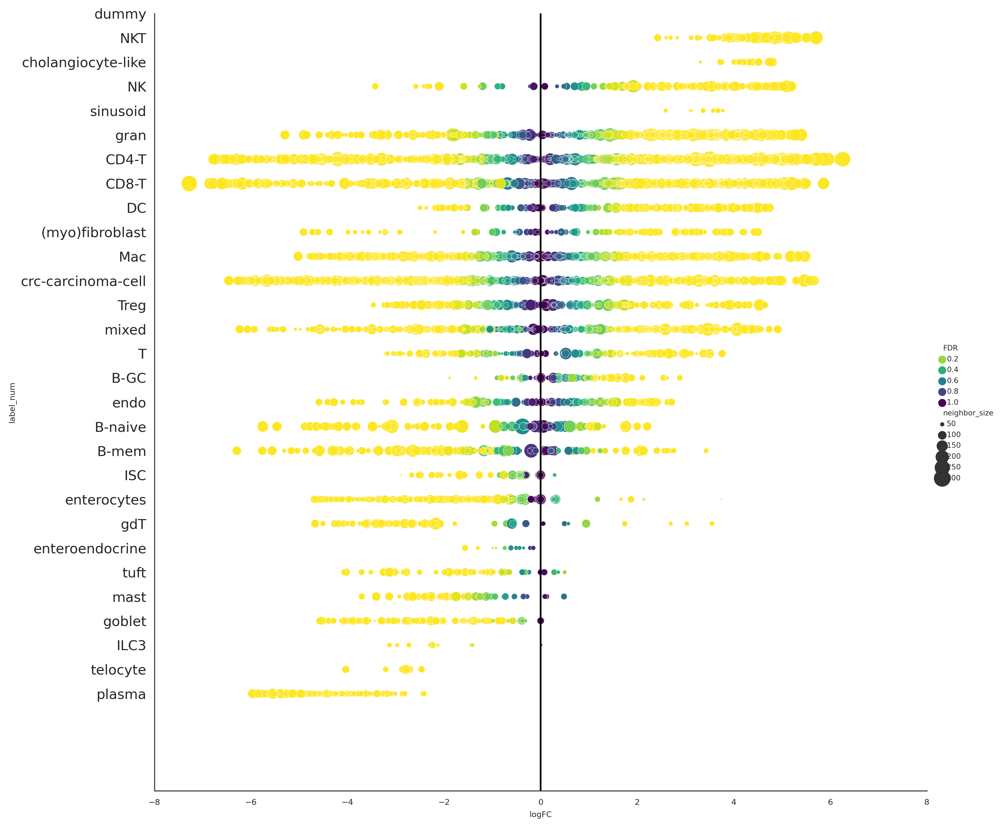

In [67]:
g = sns.relplot(x='logFC', y='label_num', hue='FDR', size='neighbor_size', #style='fdr_sig', 
                data=plot_df_neighbor, row=None, 
             col=None, col_wrap=None, row_order=None, col_order=None, palette='viridis_r',
                hue_order=None, sizes=(0,200), size_order=None, size_norm=None, 
                markers=['o','*'], dashes=None, style_order=None, legend='auto', kind='scatter', 
                height=10, aspect=1, facet_kws=None, units=None,hue_norm=(0.05,1))
plt.axvline(x=0,color='#000000')
plt.ylim(-1,28)
plt.ylim(-4,4)

header_name=list(celltype_plot_dict.keys()) + ['dummy']
y_tick_interval = 1
value_tick = range ( 0, len(celltype_plot_dict.keys())+1, y_tick_interval )
header_name_sel = [header_name[idx] for idx in  range ( 0,len(value_tick))]

for ax in g.axes.flat:
    labels = ax.get_yticklabels() # get x labels
    ax.set_yticks(ticks=value_tick) # set new labels
    ax.set_yticklabels(fontsize=12, rotation=0, labels=header_name)
plt.xlim(-8,8)

plt.savefig(fig_save_path+'swarm_'+save_path)
print('saved figure to:','swarm_'+save_path)
[celltype_plot_dict_inv[x] for x in list(range(27))]



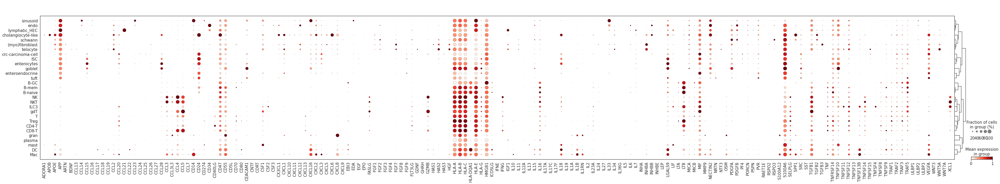

In [55]:
#dotplot
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
genes_plot =['ADIPOQ',
 'ADORA1',
 'APOB',
 'APOE',
 'APP',
 'ARTN',
 'BDNF',
 'CAML',
 'CCL1',
 'CCL11',
 'CCL12',
 'CCL13',
 'CCL14',
 'CCL15',
 'CCL16',
 'CCL17',
 'CCL18',
 'CCL19',
 'CCL2',
 'CCL20',
 'CCL21',
 'CCL21A',
 'CCL21B',
 'CCL21D',
 'CCL22',
 'CCL23',
 'CCL24',
 'CCL25',
 'CCL26',
 'CCL27',
 'CCL27A',
 'CCL27B',
 'CCL28',
 'CCL3',
 'CCL3L1',
 'CCL3L3',
 'CCL4',
 'CCL5',
 'CCL6',
 'CCL7',
 'CCL8',
 'CD14',
 'CD24',
 'CD274',
 'CD34',
 'CD40LG',
 'CD47',
 'CD55',
 'CD5L',
 'CD70',
 'CD80',
 'CEACAM1',
 'CNTF',
 'CORT',
 'CSF1',
 'CSF2',
 'CSF3',
 'CX3CL1',
 'CXCL1',
 'CXCL10',
 'CXCL11',
 'CXCL12',
 'CXCL13',
 'CXCL16',
 'CXCL2',
 'CXCL3',
 'CXCL5',
 'CXCL6',
 'CXCL8',
 'CXCL9',
 'EBI3',
 'EDA',
 'EGF',
 'EPO',
 'FASL',
 'FASLG',
 'FGF1',
 'FGF10',
 'FGF2',
 'FGF3',
 'FGF4',
 'FGF5',
 'FGF6',
 'FGF7',
 'FGF8',
 'FGF9',
 'FLT3L',
 'FLT3LG',
 'GDNF',
 'GH',
 'GH1',
 'GHRH',
 'GM11127',
 'GM8909',
 'GZMB',
 'H2-AA',
 'H2-D1',
 'H2-K1',
 'H2-M2',
 'H2-M3',
 'H2-M5',
 'H2-Q1',
 'H2-Q2',
 'H2-Q4',
 'H2-Q6',
 'H2-Q7',
 'H2-T22',
 'H2-T23',
 'H2-T24',
 'H2-T3',
 'HAS1',
 'HAS2',
 'HAS3',
 'HGF',
 'HLA-A',
 'HLA-B',
 'HLA-C',
 'HLA-DQA1',
 'HLA-E',
 'HLA-G',
 'HMGB1',
 'ICOSL',
 'ICOSLG',
 'IFNA1',
 'IFNA2',
 'IFNA6',
 'IFNA7',
 'IFNA8',
 'IFNB1',
 'IFNE',
 'IFNG',
 'IFNK',
 'IFNL1',
 'IFNL2',
 'IFNL3',
 'IFNL4',
 'IFNW1',
 'IGF1',
 'IL10',
 'IL11',
 'IL12A',
 'IL12B',
 'IL13',
 'IL15',
 'IL16',
 'IL17A',
 'IL17B',
 'IL17C',
 'IL17F',
 'IL18',
 'IL19',
 'IL1A',
 'IL1B',
 'IL1F10',
 'IL1F6',
 'IL1F8',
 'IL1F9',
 'IL1RN',
 'IL2',
 'IL20',
 'IL21',
 'IL22',
 'IL23A',
 'IL24',
 'IL25',
 'IL27',
 'IL3',
 'IL31',
 'IL33',
 'IL34',
 'IL36A',
 'IL36B',
 'IL36G',
 'IL4',
 'IL5',
 'IL6',
 'IL7',
 'IL9',
 'INHA',
 'INHBA',
 'INHBB',
 'INHBC',
 'INHBE',
 'INS',
 'INS1',
 'INS2',
 'LEP',
 'LGALS9',
 'LIF',
 'LTA',
 'LTB',
 'MICA',
 'MICB',
 'MIF',
 'MMP9',
 'NECTIN2',
 'NGF',
 'NRTN',
 'NTF3',
 'NTF5',
 'OSM',
 'PDCD1LG2',
 'PDGFA',
 'PDGFB',
 'PF4',
 'PORCN',
 'PSPN',
 'PVR',
 'RAET1D',
 'RAET1E',
 'RSPO1',
 'RSPO2',
 'RSPO3',
 'S100A12',
 'S100A6',
 'SELPLG',
 'SPP1',
 'SRC',
 'SST',
 'TGFB1',
 'TGFB2',
 'TGFB3',
 'TNF',
 'TNFRSF14',
 'TNFSF10',
 'TNFSF11',
 'TNFSF12',
 'TNFSF13',
 'TNFSF13B',
 'TNFSF14',
 'TNFSF15',
 'TNFSF18',
 'TNFSF4',
 'TNFSF8',
 'TNFSF9',
 'TRAF1',
 'TRAF2',
 'TRAF3',
 'TRAF5',
 'ULBP1',
 'ULBP2',
 'ULBP3',
 'VEFGD',
 'VEGFA',
 'VEGFC',
 'WNT2',
 'WNT3',
 'WNT5A',
 'WNT7A',
 'XCL1']

pheno_heat = 'annotation_SPECTRA_final'
celltype = 'crc-carcinoma-cell'

genes_plot_clean = [x for x in genes_plot if x in adata.var_names]

sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, genes_plot_clean, groupby=pheno_heat, dendrogram=True, standard_scale='var')

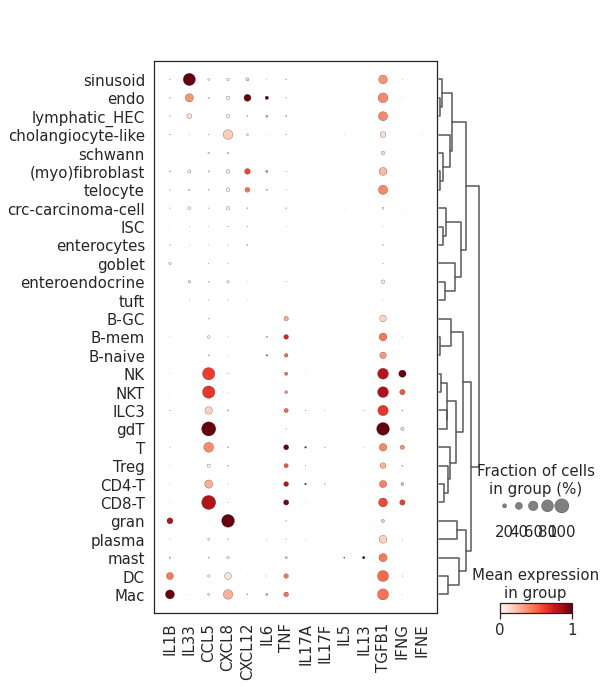

In [56]:
#dotplot
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
genes_plot =['IL1B','IL33','CCL5','CXCL8','CXCL12','IL6','TNF','IL17A','IL17F','IL4','IL5','IL13','TGFB1','IFNG','IFNA1','IFNA2','IFNE','IFNB2']

pheno_heat = 'annotation_SPECTRA_final'
celltype = 'crc-carcinoma-cell'

genes_plot_clean = [x for x in genes_plot if x in adata.var_names]

sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, genes_plot_clean, groupby=pheno_heat, dendrogram=True, standard_scale='var')

In [57]:
data_corr= pd.DataFrame()

from unidip import diptst

unidip.diptst(dat, is_hist=False, numt=1000)

plot_df_neighbor['MvsP_neighborhood_fc_nonlog']= plot_df_neighbor['MvsP_neighborhood_fc'].map(lambda x: 2**x)

#replicate neighborhoods by their size
from unidip import UniDip

for i in header_name:
    #get indices for distribution intervals
    dat = np.array(plot_df_neighbor[plot_df_neighbor['label']==i]['MvsP_neighborhood_fc'])
    intervals = UniDip(dat,alpha=0.05, ntrials=1000,is_hist=False).run()
    #convert indices into fold change
    interval_fc_ls = []
    for j in intervals:
        interval = []
        interval.append(dat[j[0]])
        interval.append(dat[j[1]])
        interval_fc_ls.append(interval)
    print(i,'intervals are:',interval_fc_ls)

# calculate signature expression

In [7]:
adata_path  = DATA_DIR + '2021-10-06_All_Samples_Filtering_Filtered_clustered_nodrops_10000hv_leukocytes_scran_5000hv_annotated_mappedannotations_small_finalvar_220722_MvsP.h5ad'

In [8]:
adata = sc.read(adata_path)

In [9]:
adata

AnnData object with n_obs × n_vars = 98719 × 19897
    obs: 'total_counts', 'Patient', 'Sample ID', 'Sample Type', 'Treatment', 'batch', 'annotation_level_0', 'annotation_level_1', 'annotation_level_2', 'annotation_SPECTRA', 'annotation_SPECTRA_final', 'patient', 'primary-site', 'sample_type', 'treatment', 'tumor-site', 'Female_1', 'Age', 'Right', 'kras_nras', 'MSI-H', 'site', 'sample_id', 'milo_M_vs_P_all_neighborhoods', 'milo_M_vs_P_sig_neighborhoods', 'MvsP_neighborhood_fdr', 'MvsP_neighborhood_fc'
    uns: 'annotation_SPECTRA_final_colors', 'neighbors', 'pca', 'site_colors', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

computing score 'score'


/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished: added
    'score', score of gene set (adata.obs).
    1097 total control genes are used. (0:00:09)


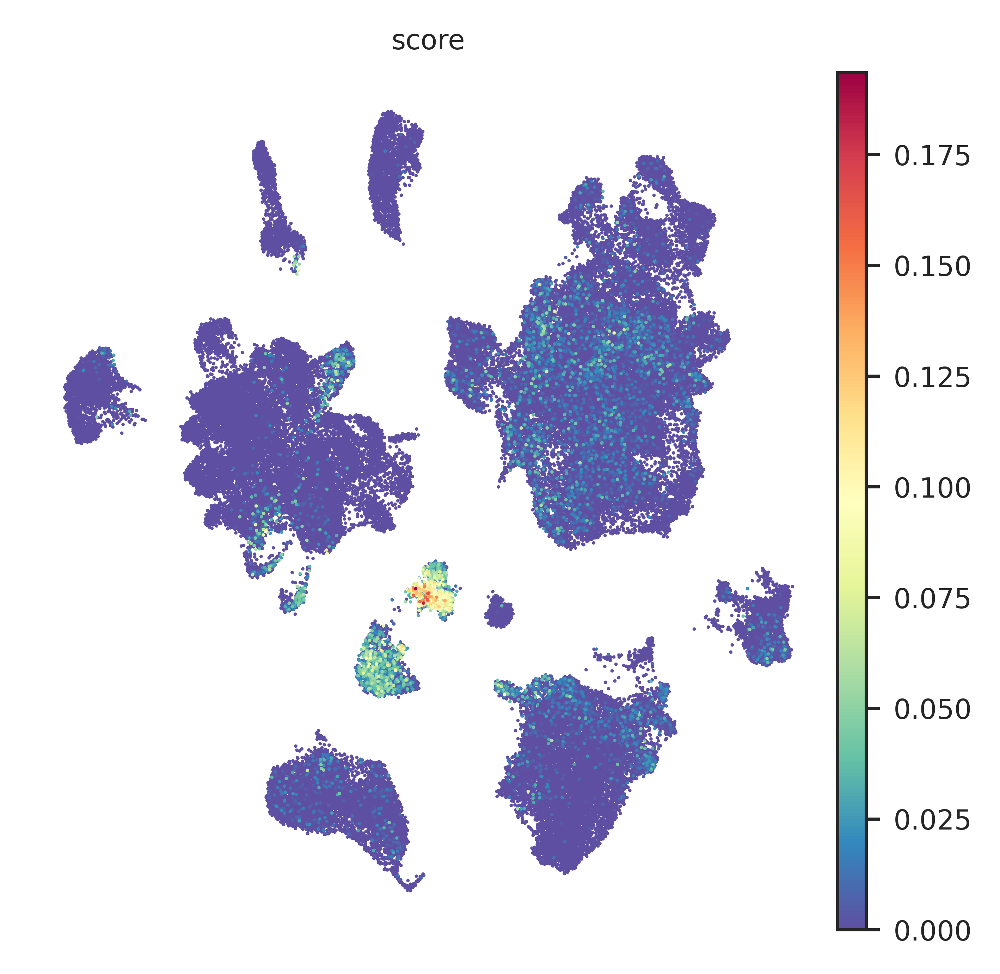

In [14]:
#compare with scoregenes
gene_set_list = ['ABHD14A','AC004556.1'	'AC007114.2','AC105411.1','ADGRV1','AIF1L','AMHR2','APOA2',
                 'ARHGEF19','ASGR1','ASGR2','AXL','BEX5','BX890604.1','C9orf116','CADM4','CBX6',
                 'CD200','CDCA7L','CDH2','CKLF','CLEC11A','CMTM3','COL14A1','COL26A1','CRABP1','CRISPLD1',
                 'CST1','CTNND2','DNMT3A','DUSP4','EFEMP1','EFEMP2','ENAH','ETV4','EVL','F2R','FADS2',
                 'FAM215B','FAM229B','FILIP1L','FKBP10','FLNA','FRAS1','FSCN1','FSTL1','FXN','FXYD6',
                 'GDF11','GPC1','GPR82','GPX7','GPX8','GUCY1A2','GYG2','GYPC','HDGFL3','HLA-DQB1',
                 'HYAL2','IGDCC3','LARGE1','MAP9','MEX3A','MYLK','NOTCH3','NOVA1','PDGFC','PDLIM7',
                 'PLEKHA4','PLEKHB1','PLTP','PODXL2','POMC','PPP1R1A','PTK7','PXDN','PYGL','RAMP2',
                 'RBPMS','RGL3'	'SBK1','SCD','SEMA3A','SEMA3D','SHH','SIGLEC11','SMARCA1','SOX11',
                'STARD4-AS1','STMN3','SULT1C4','SUSD3','SYNC','SYNGR1','TAC3','TCF7','TCTEX1D2',
                 'TEAD2','TET1','TF','TMEM132A','TMEM237','TNNC1','TNNI3','TNNT1','TPST1','TTYH1',
                 'TYRO3','UBE2Q2','UPK1A','WDR54','WIF1','ZNF618']

sc.tl.score_genes(adata, gene_set_list, ctrl_size=50, gene_pool=None, n_bins=25, score_name='score', random_state=0, copy=False, use_raw=None)

sc.pl.umap(adata, color = 'score', s = 3, cmap='Spectral_r', legend_fontsize = 10, vmin=0)

In [17]:
gene_set_list_clean = [x for x in gene_set_list if x in adata.var_names]

sc.pl.dotplot(adata,gene_set_list_clean, groupby='annotation_SPECTRA_final',standard_scale='var', dendrogram=False, return_fig=False,
                 figsize=(30,10))

In [20]:
adata

AnnData object with n_obs × n_vars = 98719 × 19897
    obs: 'total_counts', 'Patient', 'Sample ID', 'Sample Type', 'Treatment', 'batch', 'annotation_level_0', 'annotation_level_1', 'annotation_level_2', 'annotation_SPECTRA', 'annotation_SPECTRA_final', 'patient', 'primary-site', 'sample_type', 'treatment', 'tumor-site', 'Female_1', 'Age', 'Right', 'kras_nras', 'MSI-H', 'site', 'sample_id', 'milo_M_vs_P_all_neighborhoods', 'milo_M_vs_P_sig_neighborhoods', 'MvsP_neighborhood_fdr', 'MvsP_neighborhood_fc', 'score'
    uns: 'annotation_SPECTRA_final_colors', 'neighbors', 'pca', 'site_colors', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

KeyError: 'imputed'